# 数据挖掘 第12周课后作业 离群点分析与异常检测

> 本作业 GitHub 地址：[GitHub Address]()

> 所选取数据集：[abalone_benchmarks](https://ir.library.oregonstate.edu/concern/parent/47429f155/file_sets/8p58pk46v)

## 1. 准备工作

In [1]:
# 导入相关依赖
import os
import sys
sys.path.append('../')
import csv
import numpy as np
np.set_printoptions(threshold=np.inf)
from scipy import stats
import matplotlib.pyplot as plt
import matplotlib.font_manager
from pyod.models.knn import KNN   
from pyod.models.abod import ABOD
from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.lof import LOF
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split

# 实验选取相关属性
attribute = [
    'diff.score',
    'V1',
    'V2',
    'V3',
    'V4',
    'V5',
    'V6',
    'V7'
]

# 数据集
root = './data/abalone/benchmarks/'

## 2. 数据集预处理

In [3]:
random_state = np.random.RandomState(20)
outliers_fraction = 0.05
classifiers = {
        'Angle-based Outlier Detector (ABOD)': ABOD(contamination=outliers_fraction),
        'Cluster-based Local Outlier Factor (CBLOF)': CBLOF(contamination=outliers_fraction, check_estimator=False, random_state=random_state),
        'Feature Bagging': FeatureBagging(LOF(n_neighbors=35), contamination=outliers_fraction, check_estimator=False, random_state=random_state),
        'Histogram-base Outlier Detection (HBOS)': HBOS(contamination=outliers_fraction),
        'Isolation Forest': IForest(contamination=outliers_fraction, random_state=random_state),
        'K Nearest Neighbors (KNN)': KNN(contamination=outliers_fraction),
        'Average KNN': KNN(method='mean', contamination=outliers_fraction)
}

files = os.listdir(root)

path = './data/abalone/'
for att in attribute[1:]:
    save_file = path + att + '.txt'
    fout = open(save_file, mode='w')

    for file in files:
        fout.write('\n\ndataset abalone: ' + file + '\n')
        file = root + file

        dataset = pd.read_csv(file) 
        former = attribute[0]
        latter = att
        scaler = MinMaxScaler(feature_range=(0, 1))
        dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
        dataset[[former, latter]].head()
        X1 = dataset[former].values.reshape(-1, 1)
        X2 = dataset[latter].values.reshape(-1, 1)
        X = np.concatenate((X1, X2), axis=1)

        xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
        for i, (clf_name, clf) in enumerate(classifiers.items()):
            clf.fit(X)
            scores_pred = clf.decision_function(X) * -1
            y_pred = clf.predict(X)
            n_inliers = len(y_pred) - np.count_nonzero(y_pred)
            n_outliers = np.count_nonzero(y_pred == 1)
            plt.figure(figsize=(10, 10))
            dfx = dataset
            dfx['outlier'] = y_pred.tolist()

            IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
            IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)

            OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
            OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)
            line = 'OUTLIERS: ' + str(n_outliers) + '  INLIERS: ' + str(n_inliers) + ' using ' + clf_name
            fout.write(str(line) + '\n')

    fout.close()

## 3. 异常检测与可视化分析

### 3.1 diff.score, V1



dataset wine: abalone_benchmark_0864.csv
OUTLIERS :  57 INLIERS :  1084 Angle-based Outlier Detector (ABOD)


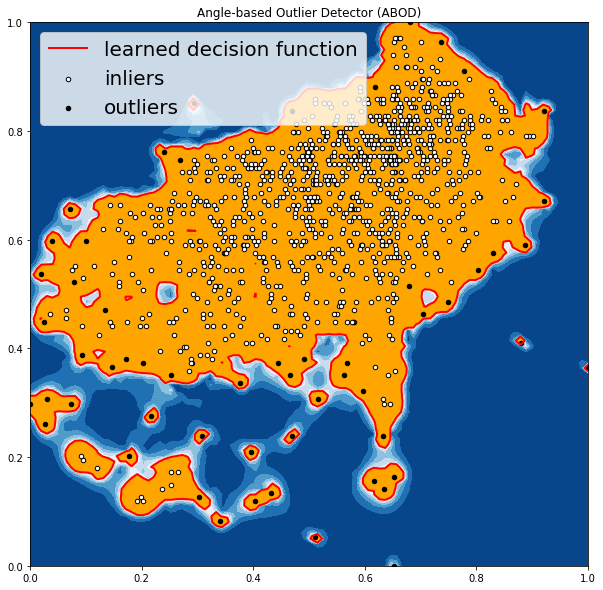

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


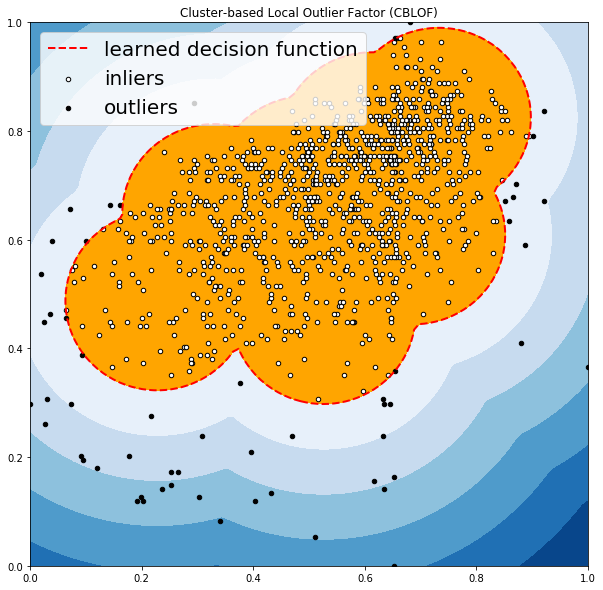

OUTLIERS :  57 INLIERS :  1084 Feature Bagging


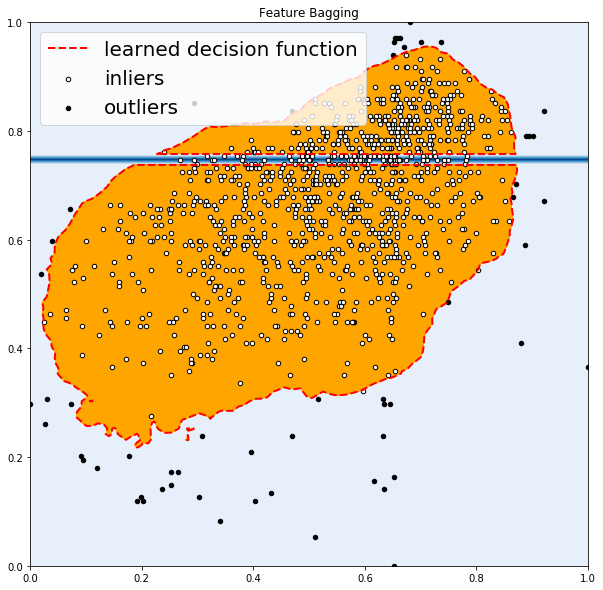

OUTLIERS :  57 INLIERS :  1084 Histogram-base Outlier Detection (HBOS)


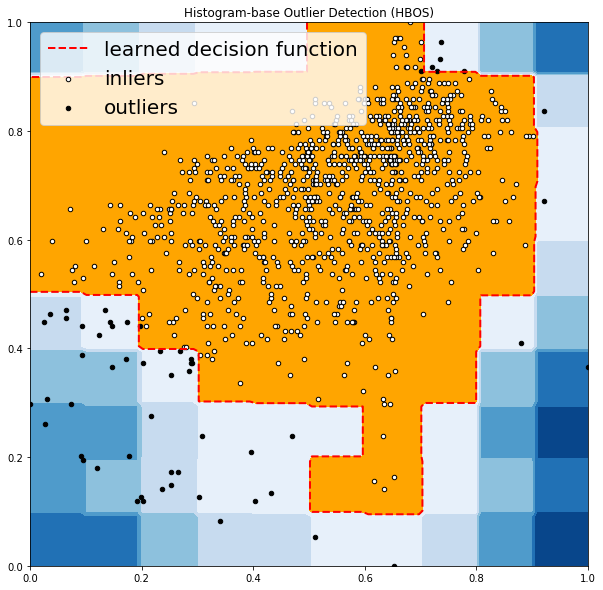

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


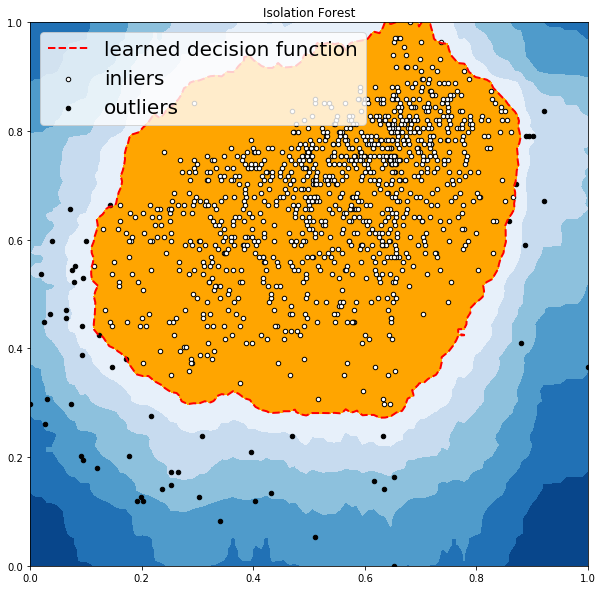

OUTLIERS :  48 INLIERS :  1093 K Nearest Neighbors (KNN)


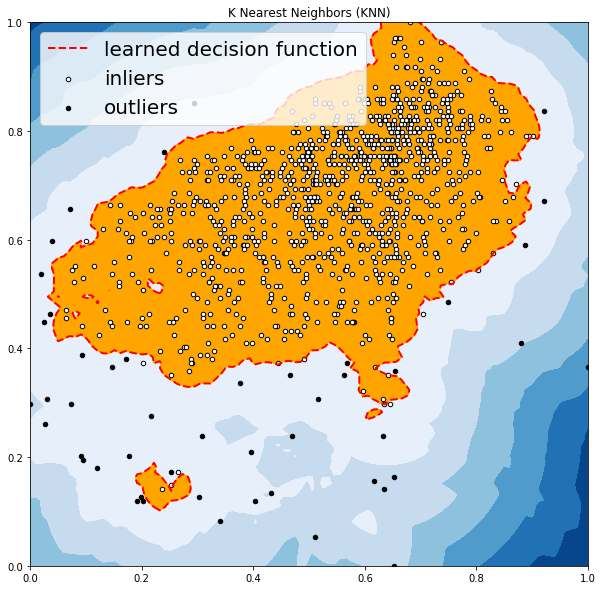

OUTLIERS :  35 INLIERS :  1106 Average KNN


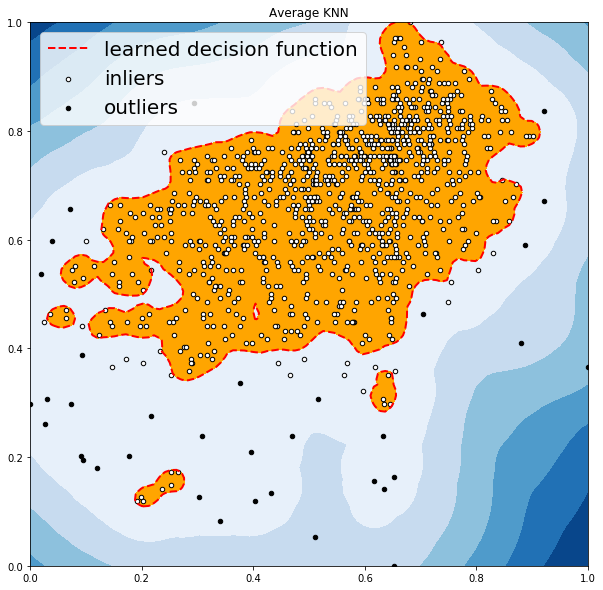



dataset wine: abalone_benchmark_0870.csv
OUTLIERS :  55 INLIERS :  1091 Angle-based Outlier Detector (ABOD)


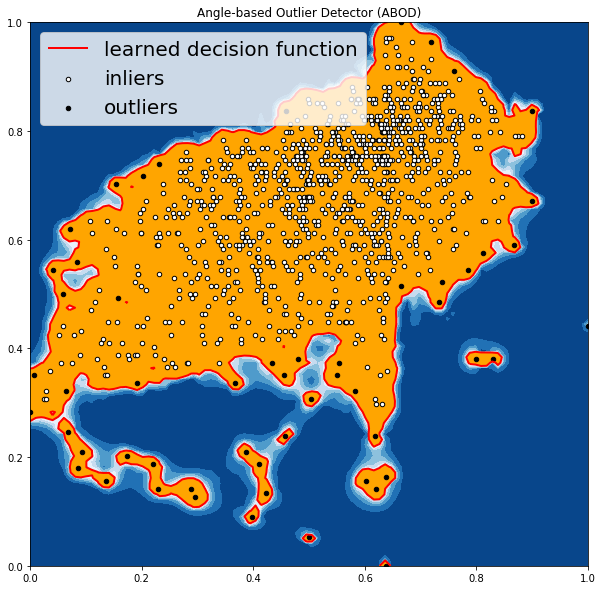

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


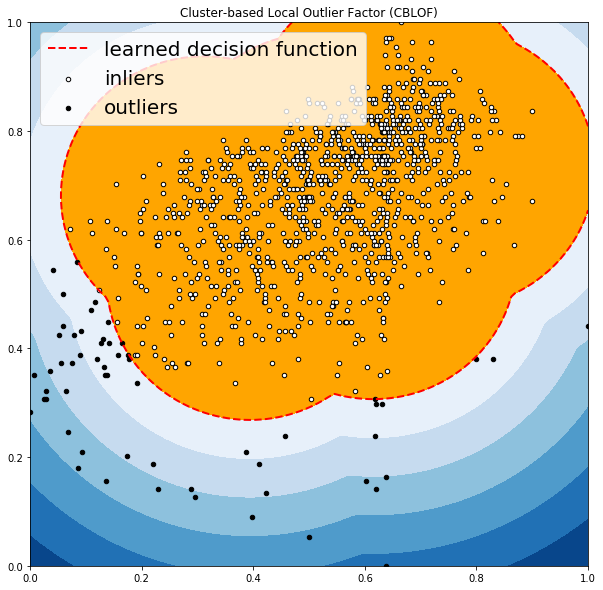

OUTLIERS :  51 INLIERS :  1095 Feature Bagging


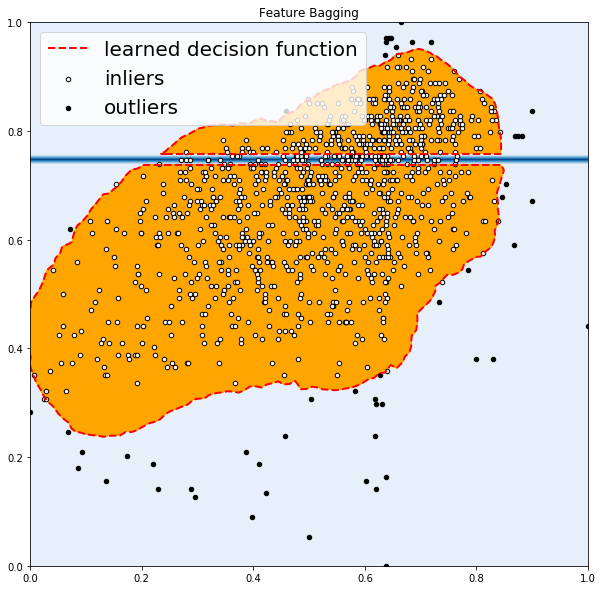

OUTLIERS :  56 INLIERS :  1090 Histogram-base Outlier Detection (HBOS)


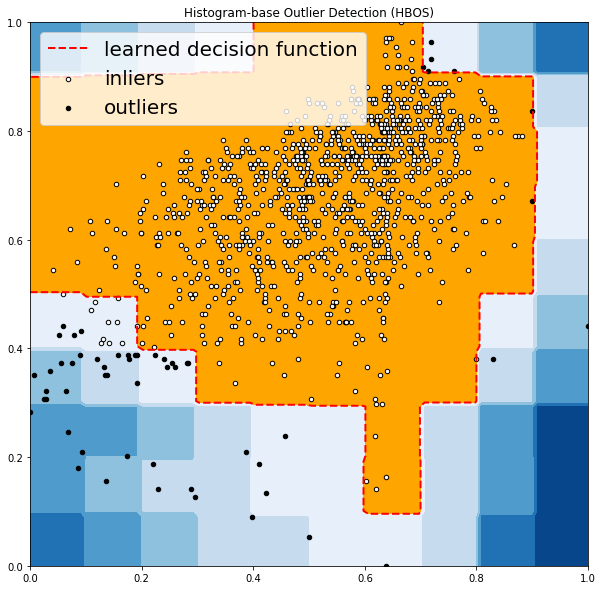

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


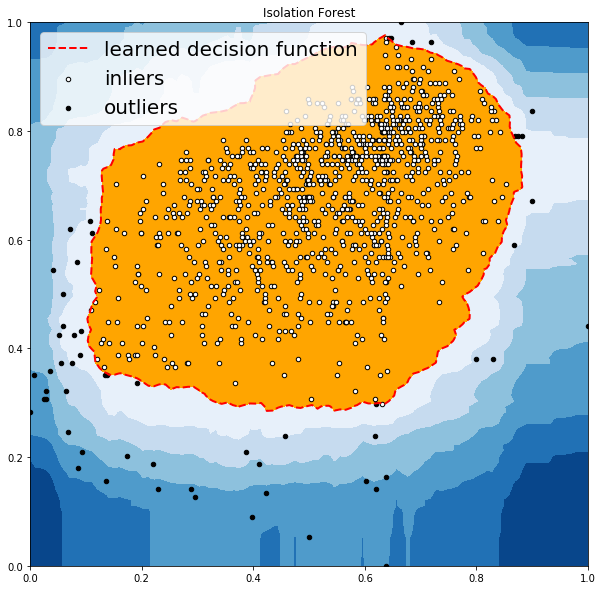

OUTLIERS :  43 INLIERS :  1103 K Nearest Neighbors (KNN)


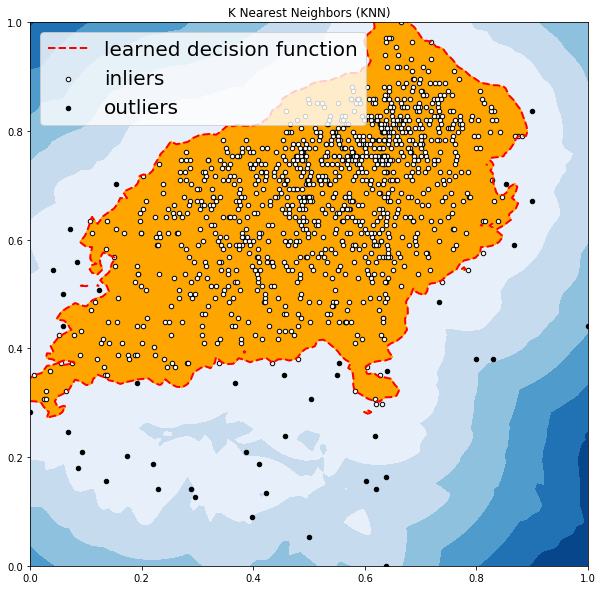

OUTLIERS :  36 INLIERS :  1110 Average KNN


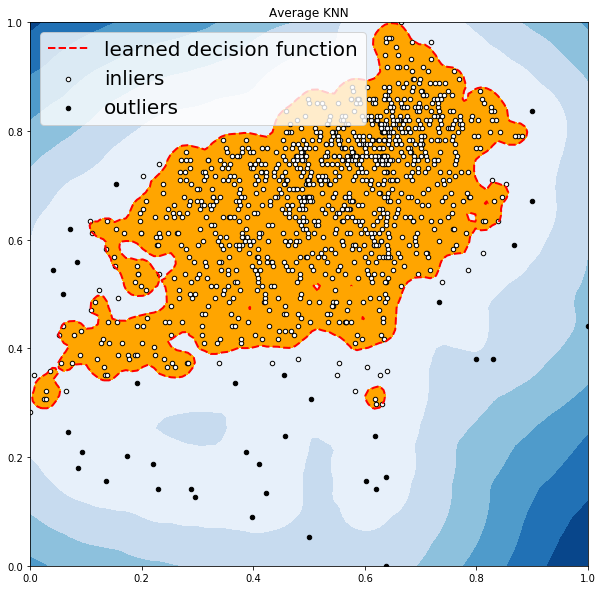



dataset wine: abalone_benchmark_0858.csv
OUTLIERS :  55 INLIERS :  1086 Angle-based Outlier Detector (ABOD)


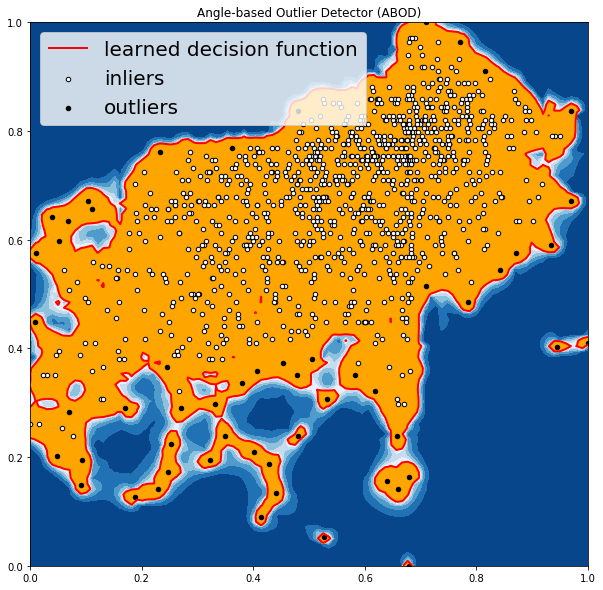

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


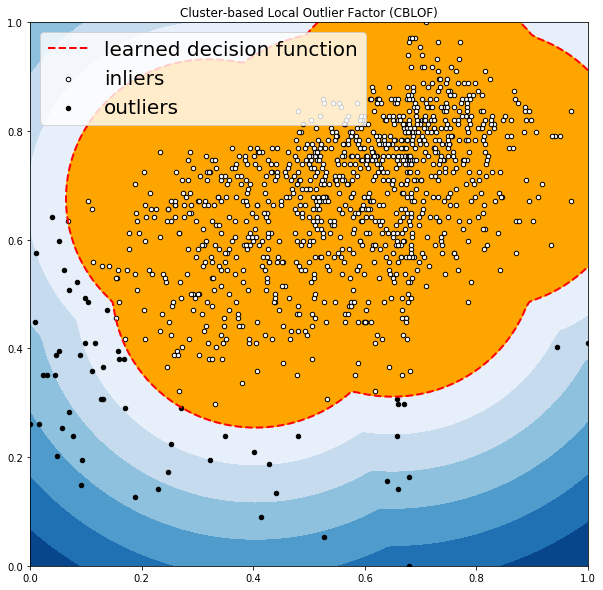

OUTLIERS :  51 INLIERS :  1090 Feature Bagging


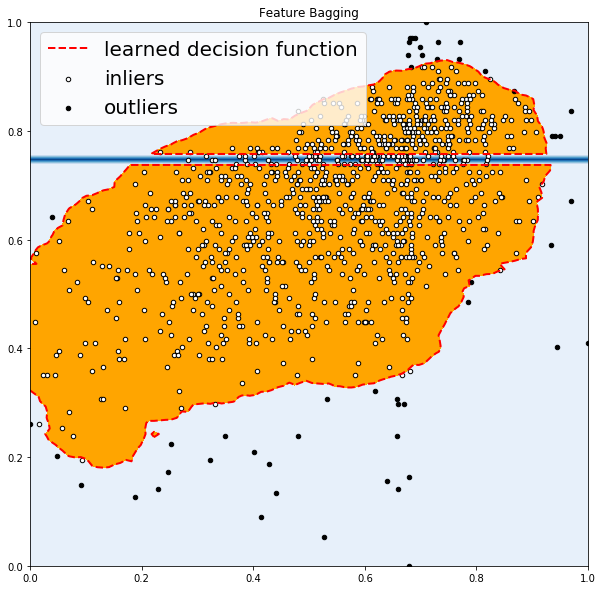

OUTLIERS :  56 INLIERS :  1085 Histogram-base Outlier Detection (HBOS)


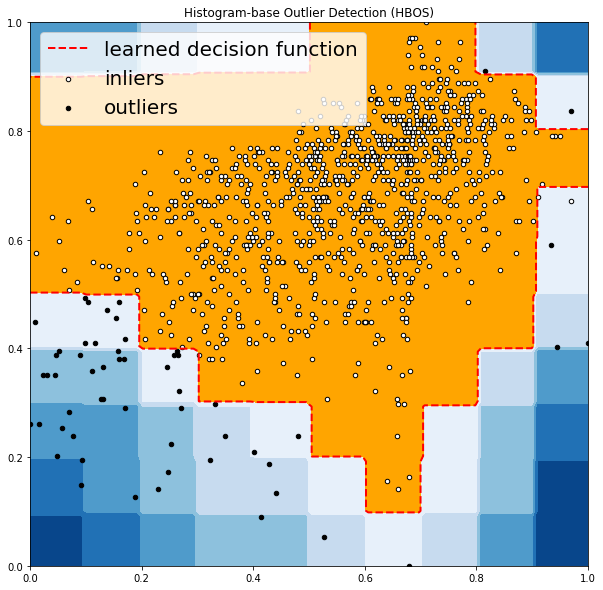

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


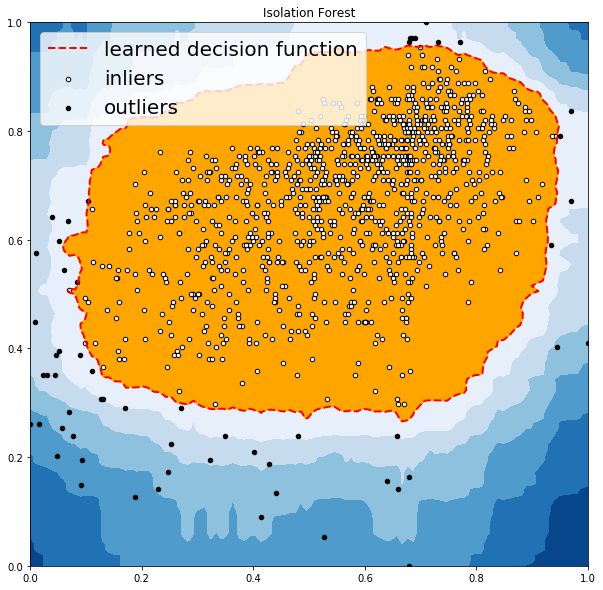

OUTLIERS :  44 INLIERS :  1097 K Nearest Neighbors (KNN)


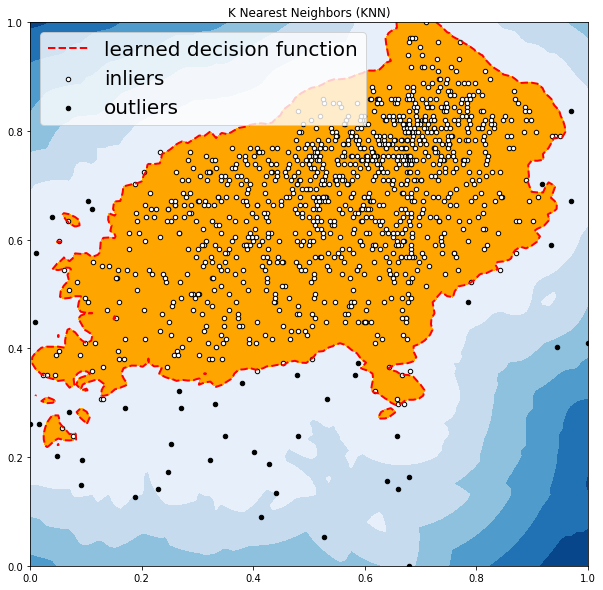

OUTLIERS :  31 INLIERS :  1110 Average KNN


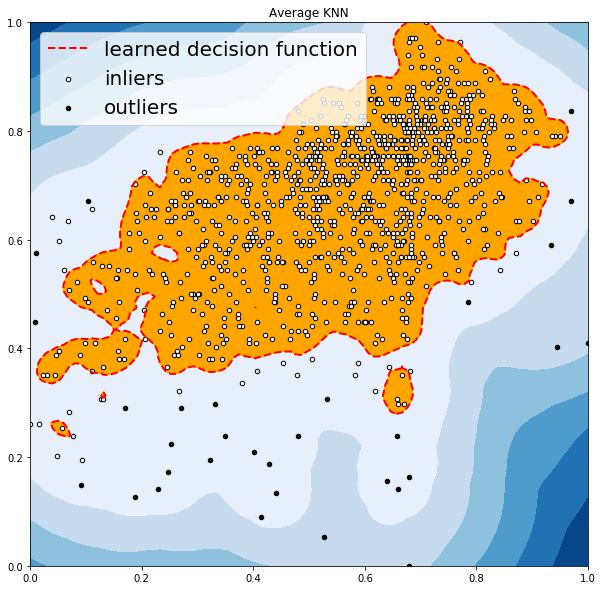



dataset wine: abalone_benchmark_0680.csv
OUTLIERS :  43 INLIERS :  860 Angle-based Outlier Detector (ABOD)


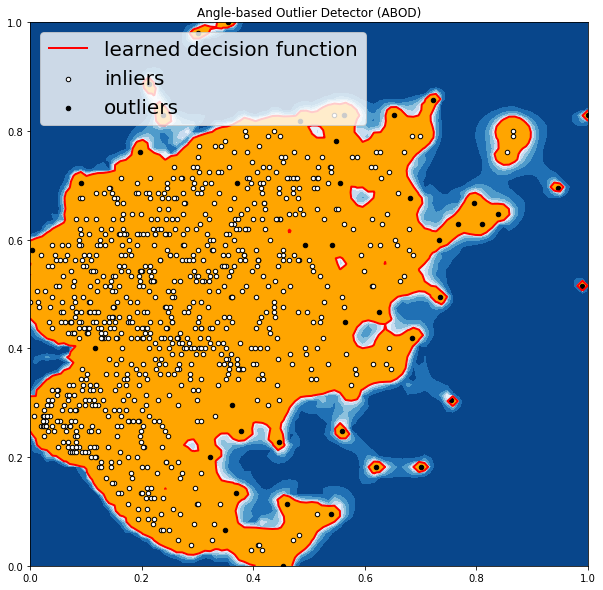

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


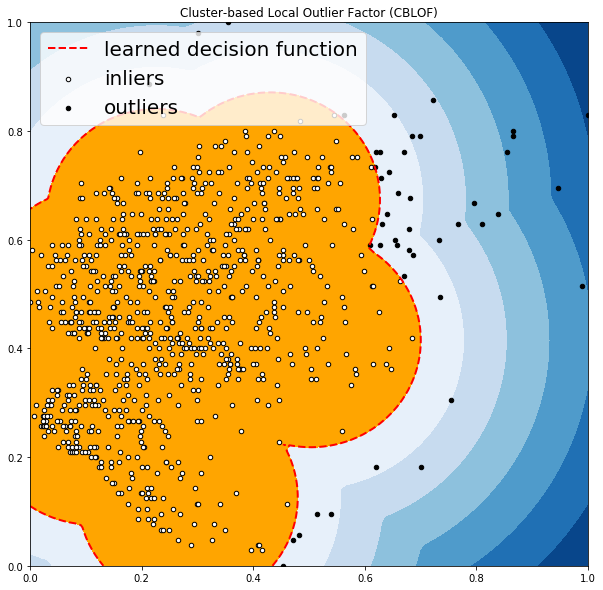

OUTLIERS :  45 INLIERS :  858 Feature Bagging


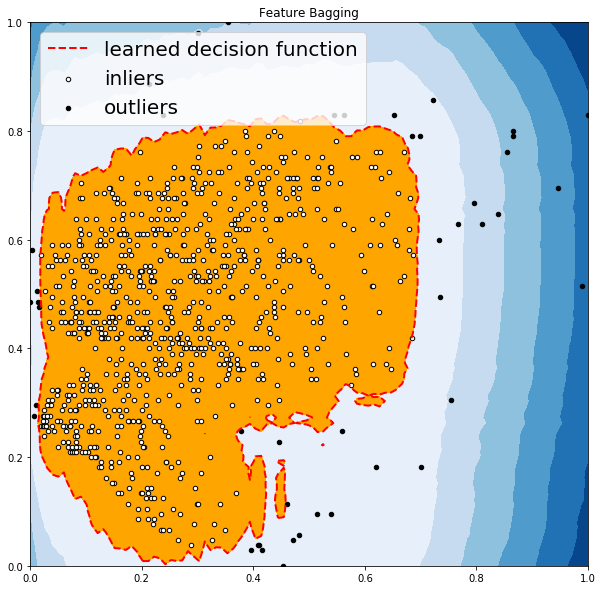

OUTLIERS :  43 INLIERS :  860 Histogram-base Outlier Detection (HBOS)


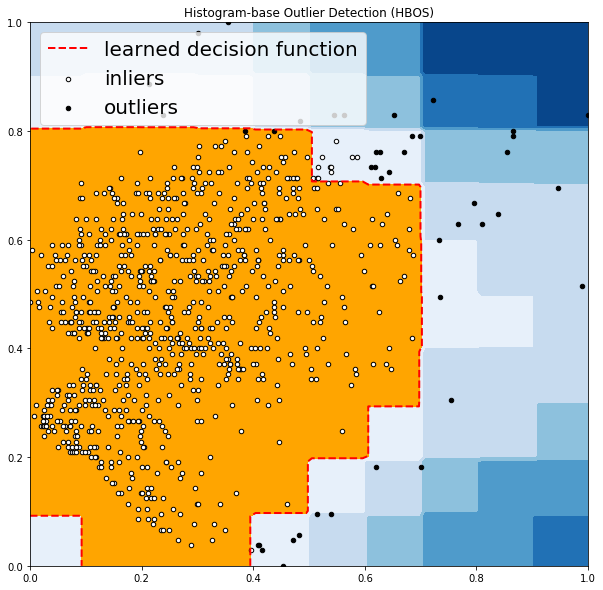

OUTLIERS :  46 INLIERS :  857 Isolation Forest


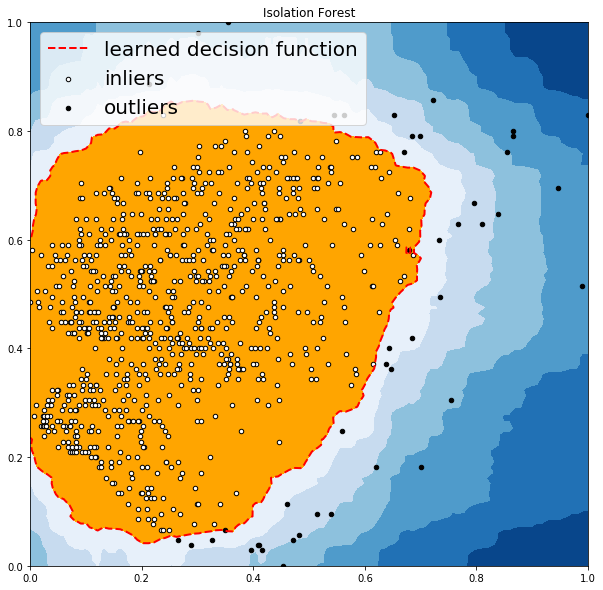

OUTLIERS :  37 INLIERS :  866 K Nearest Neighbors (KNN)


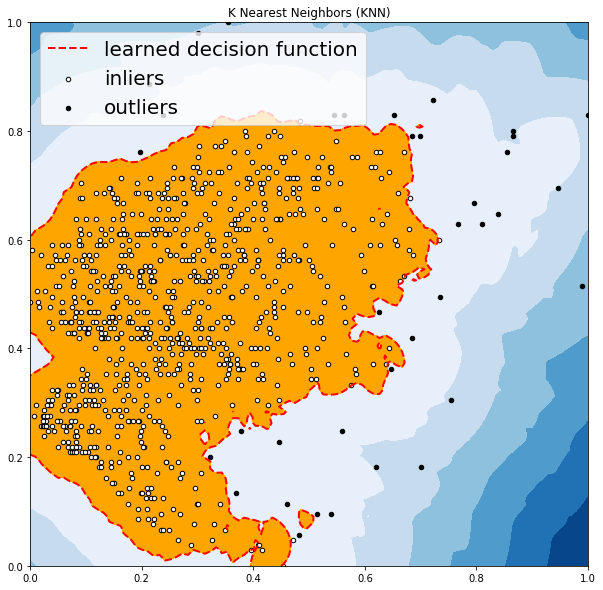

OUTLIERS :  28 INLIERS :  875 Average KNN


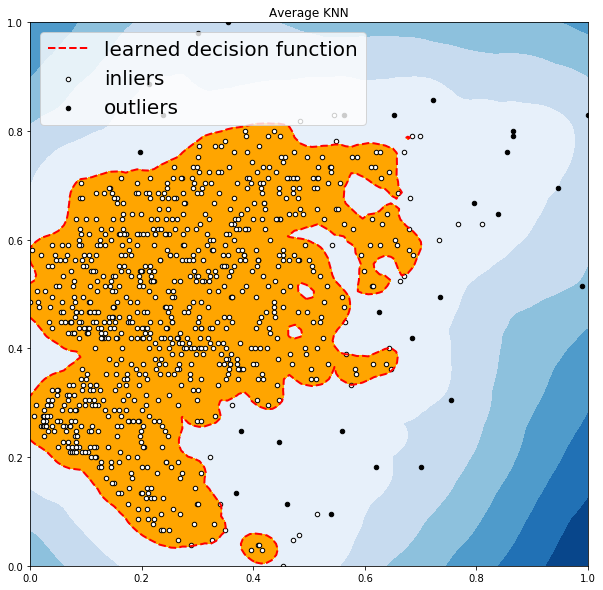



dataset wine: abalone_benchmark_0694.csv
OUTLIERS :  44 INLIERS :  849 Angle-based Outlier Detector (ABOD)


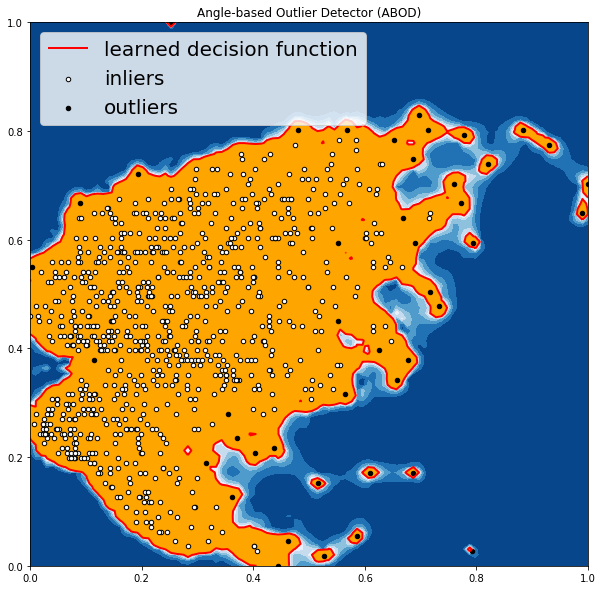

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


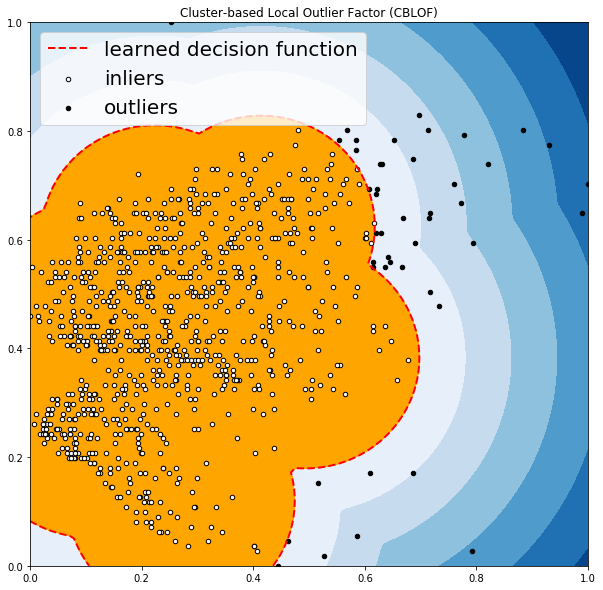

OUTLIERS :  41 INLIERS :  852 Feature Bagging


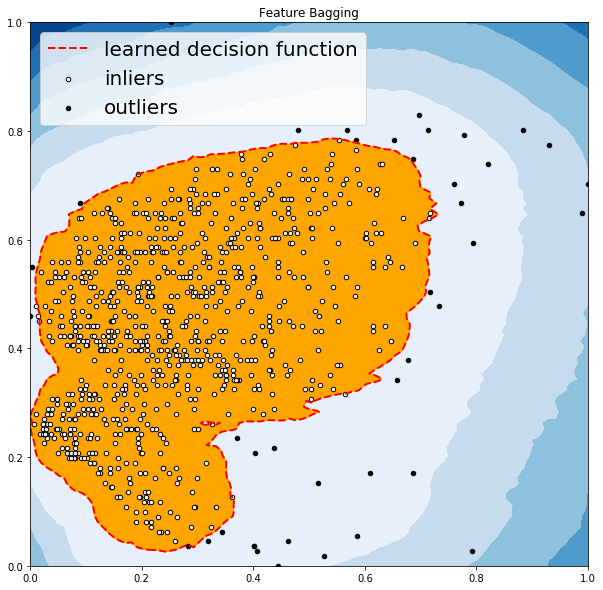

OUTLIERS :  45 INLIERS :  848 Histogram-base Outlier Detection (HBOS)


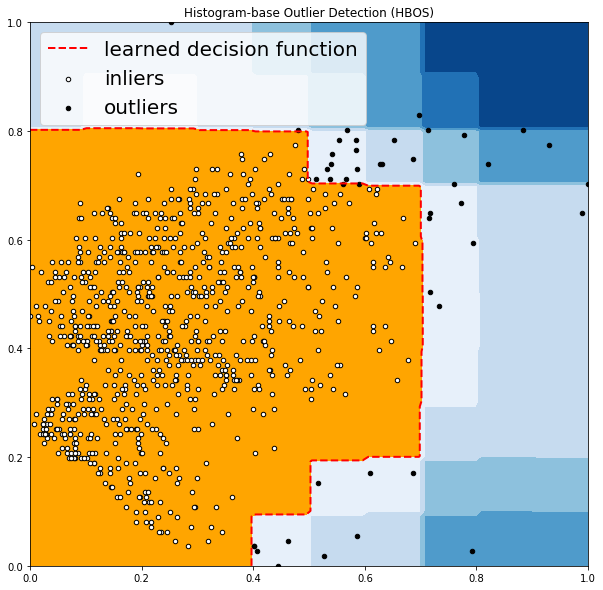

OUTLIERS :  45 INLIERS :  848 Isolation Forest


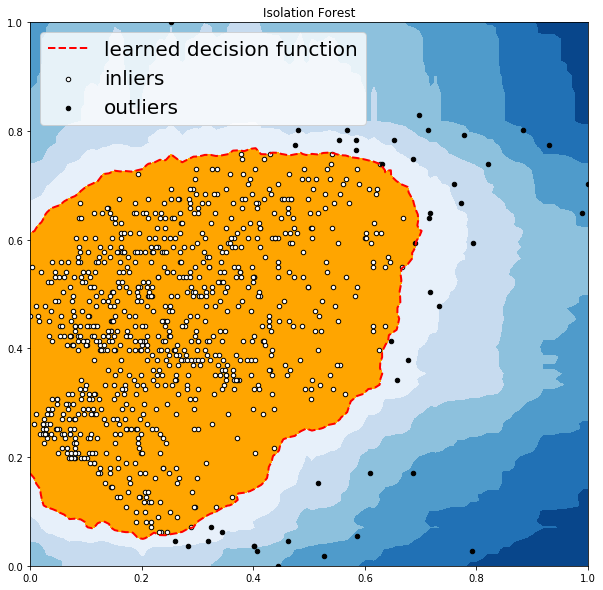

OUTLIERS :  36 INLIERS :  857 K Nearest Neighbors (KNN)


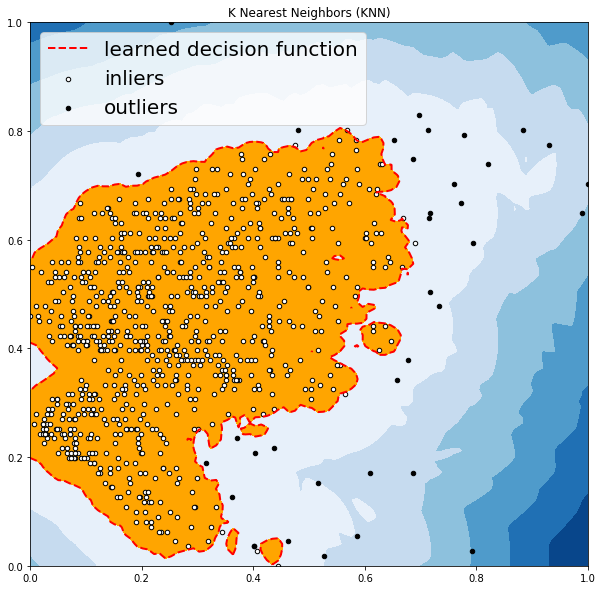

OUTLIERS :  33 INLIERS :  860 Average KNN


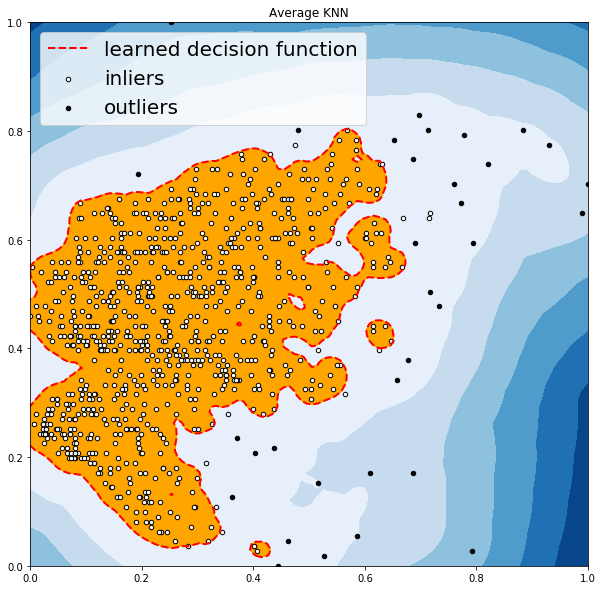

In [5]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[1]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1

        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))

        dfx = dataset
        dfx['outlier'] = y_pred.tolist()

        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)

        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)
        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)

        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')

        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')

        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')

        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数

### 3.2 diff.score, V2



dataset abalone: abalone_benchmark_0864.csv
OUTLIERS :  58 INLIERS :  1083 Angle-based Outlier Detector (ABOD)


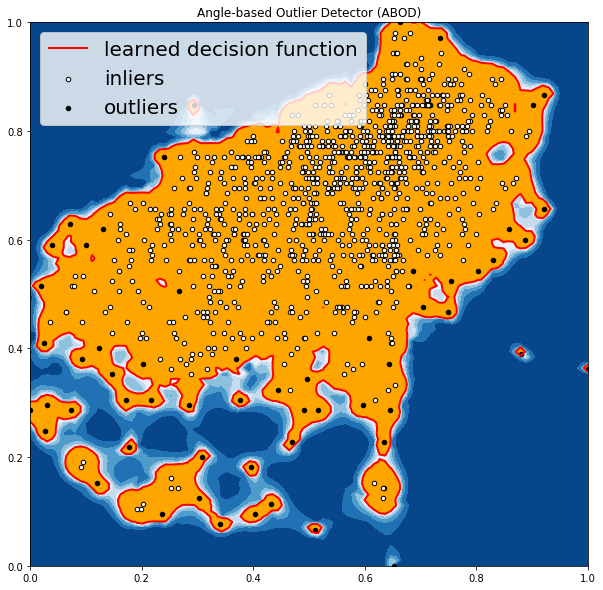

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


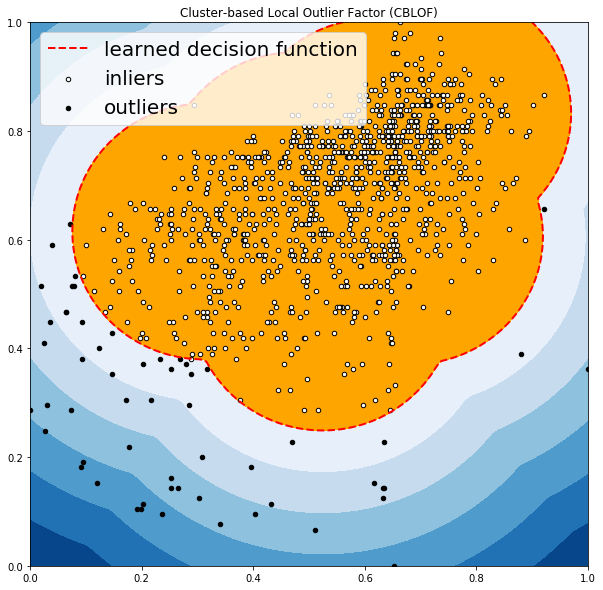

OUTLIERS :  22 INLIERS :  1119 Feature Bagging


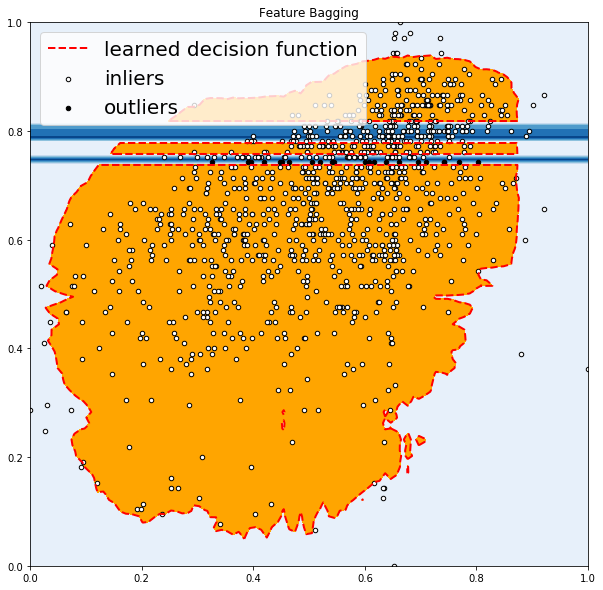

OUTLIERS :  54 INLIERS :  1087 Histogram-base Outlier Detection (HBOS)


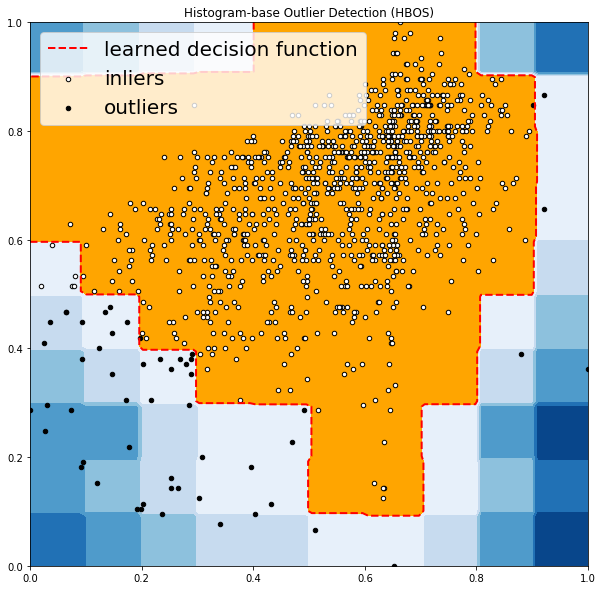

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


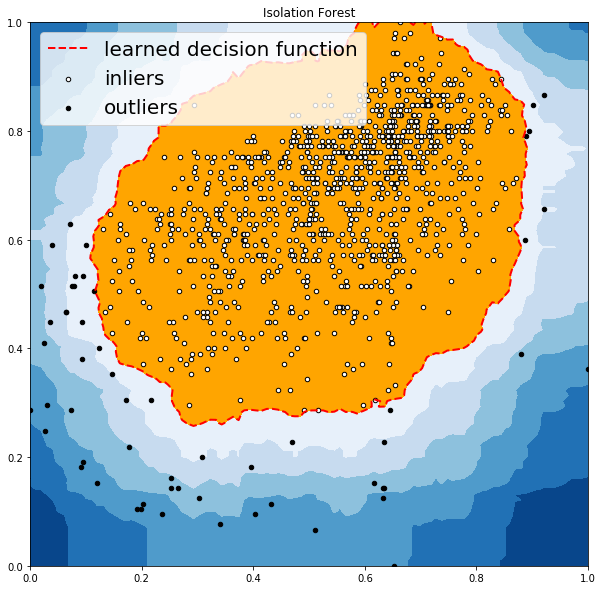

OUTLIERS :  44 INLIERS :  1097 K Nearest Neighbors (KNN)


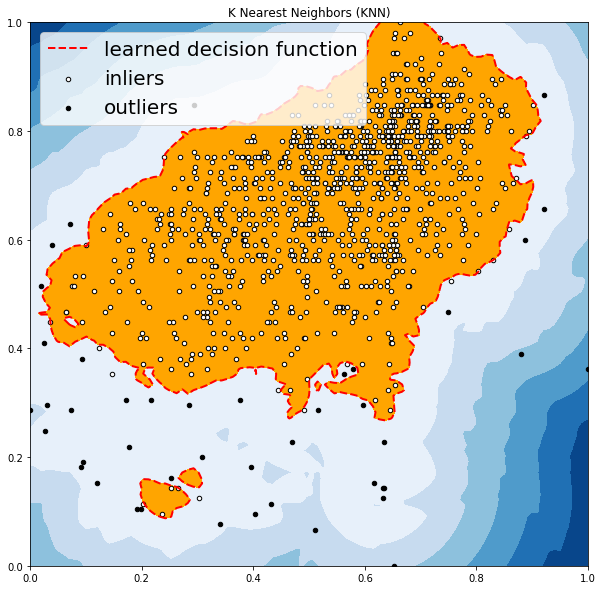

OUTLIERS :  32 INLIERS :  1109 Average KNN


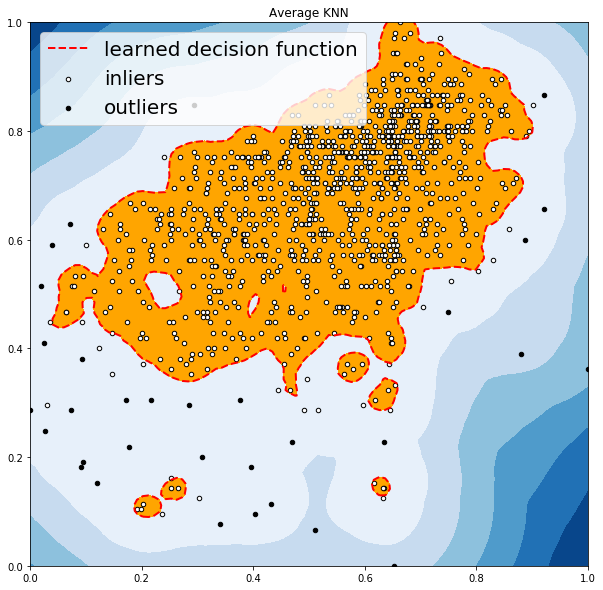



dataset abalone: abalone_benchmark_0870.csv
OUTLIERS :  62 INLIERS :  1084 Angle-based Outlier Detector (ABOD)


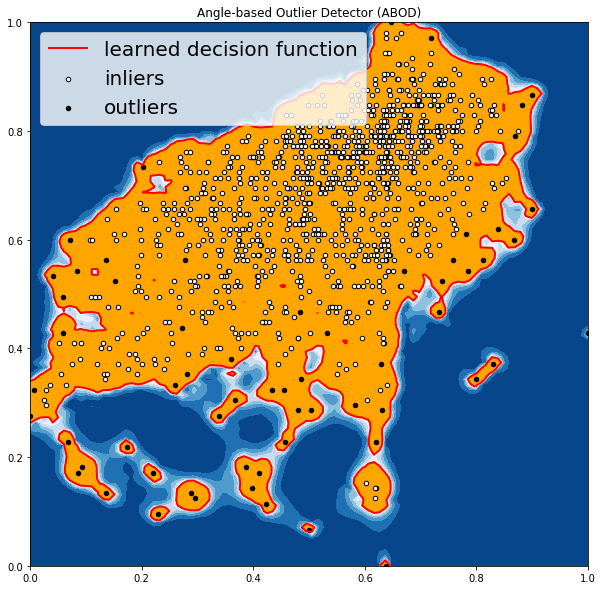

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


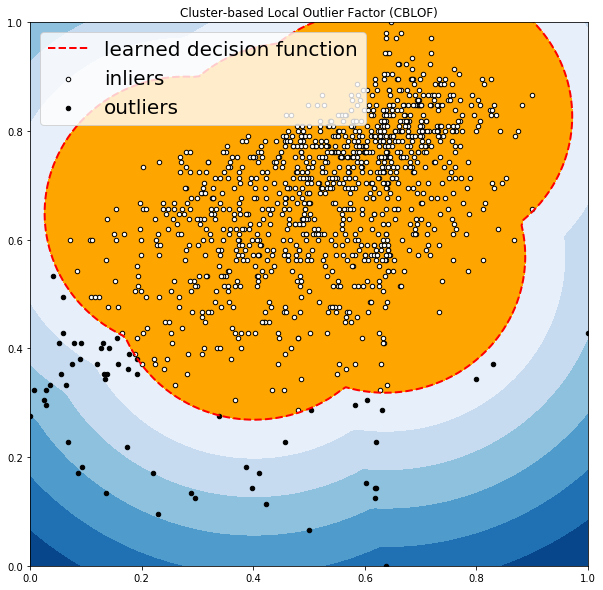

OUTLIERS :  58 INLIERS :  1088 Feature Bagging


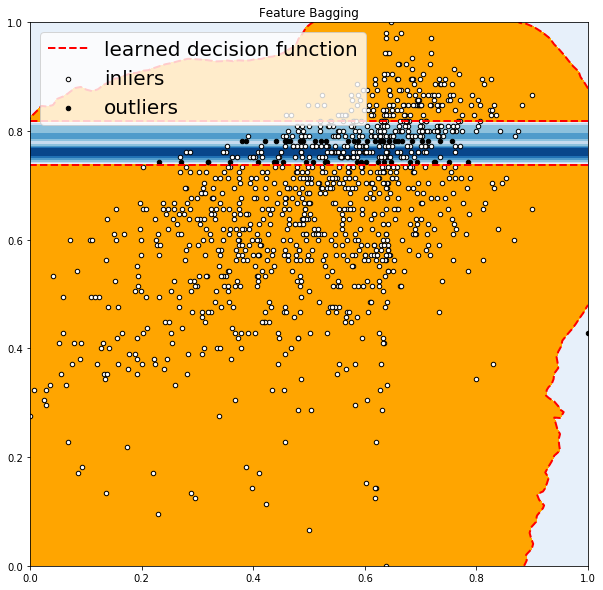

OUTLIERS :  53 INLIERS :  1093 Histogram-base Outlier Detection (HBOS)


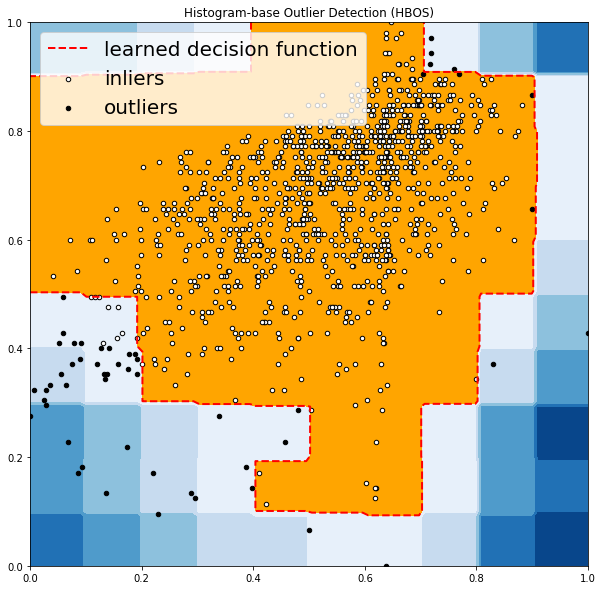

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


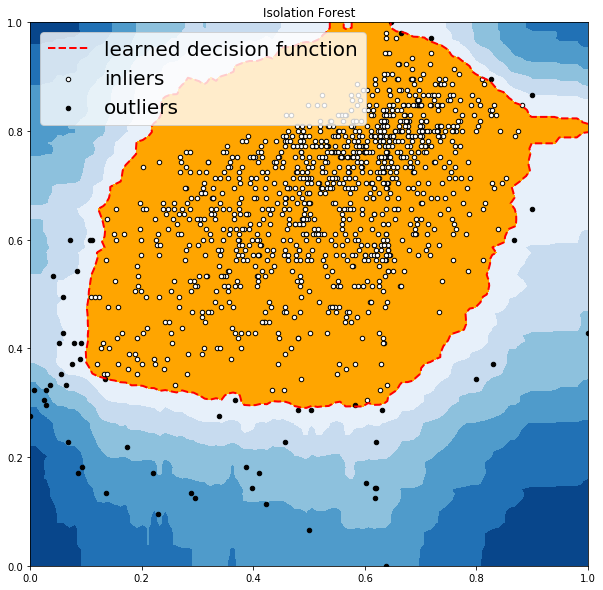

OUTLIERS :  46 INLIERS :  1100 K Nearest Neighbors (KNN)


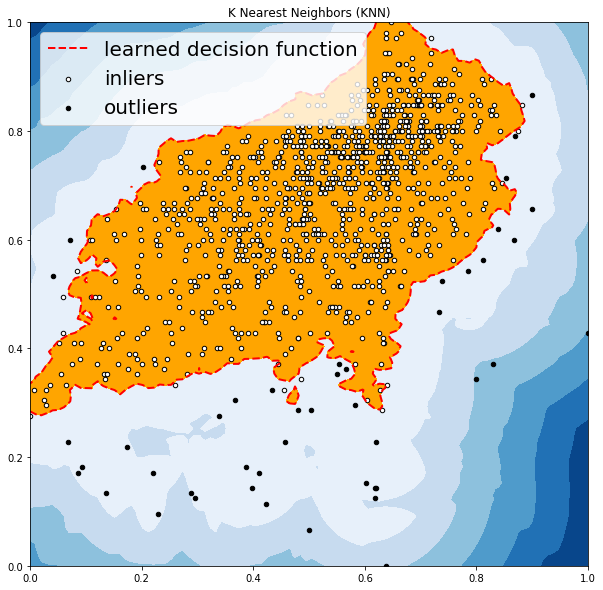

OUTLIERS :  31 INLIERS :  1115 Average KNN


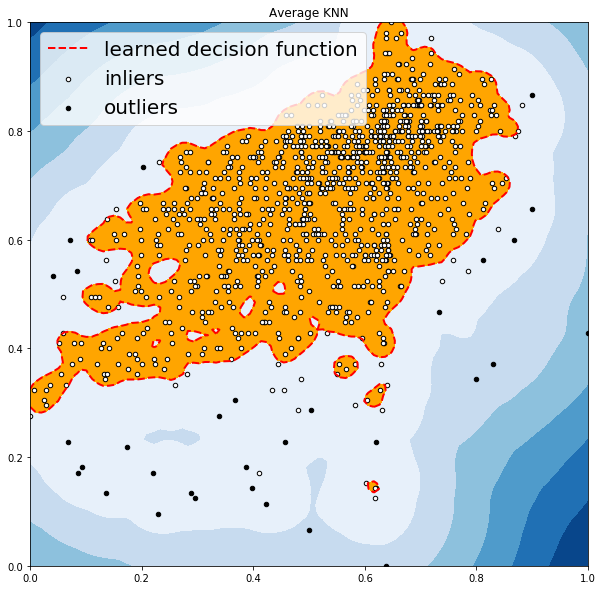



dataset abalone: abalone_benchmark_0858.csv
OUTLIERS :  52 INLIERS :  1089 Angle-based Outlier Detector (ABOD)


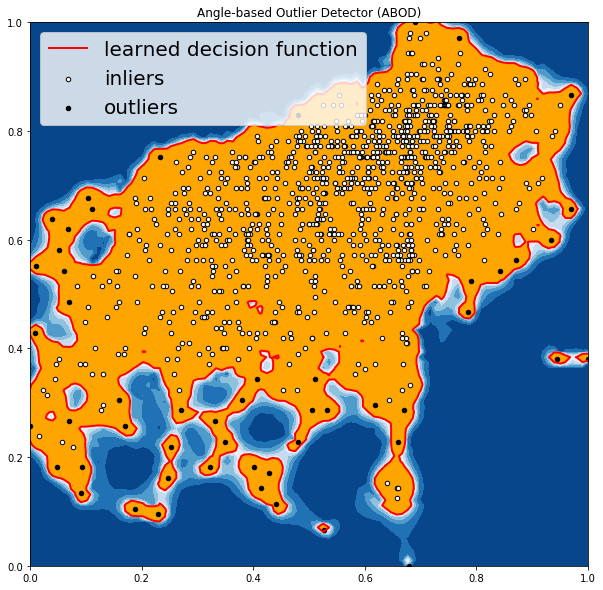

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


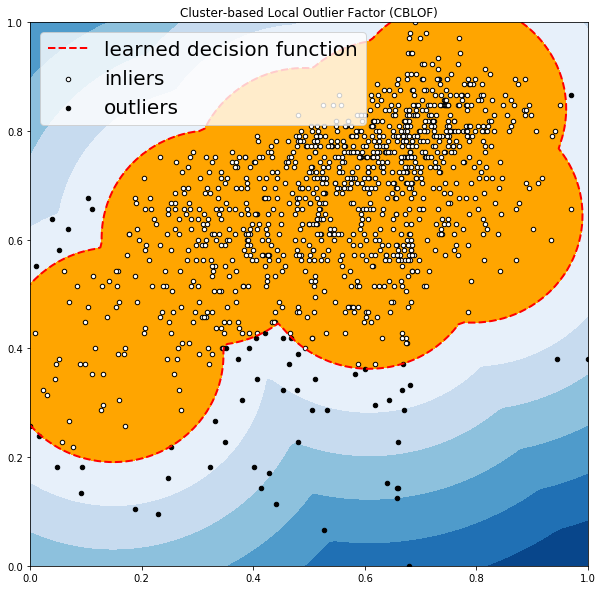

OUTLIERS :  24 INLIERS :  1117 Feature Bagging


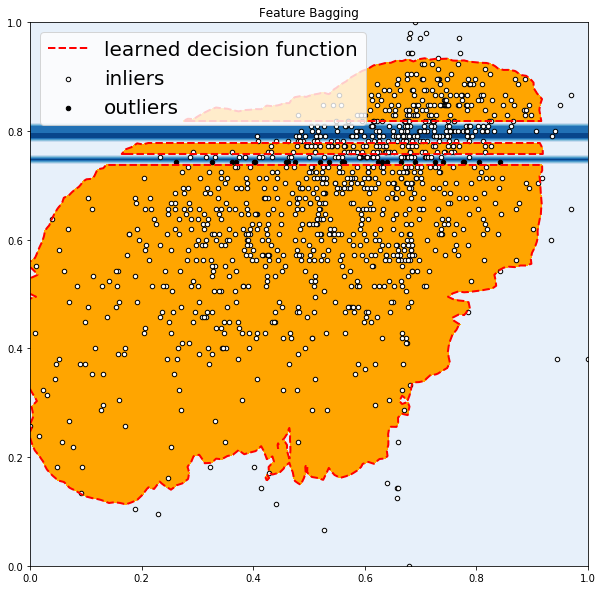

OUTLIERS :  53 INLIERS :  1088 Histogram-base Outlier Detection (HBOS)


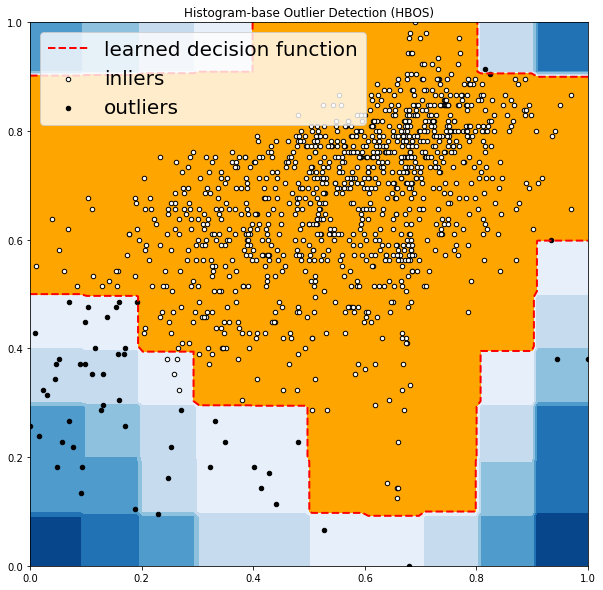

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


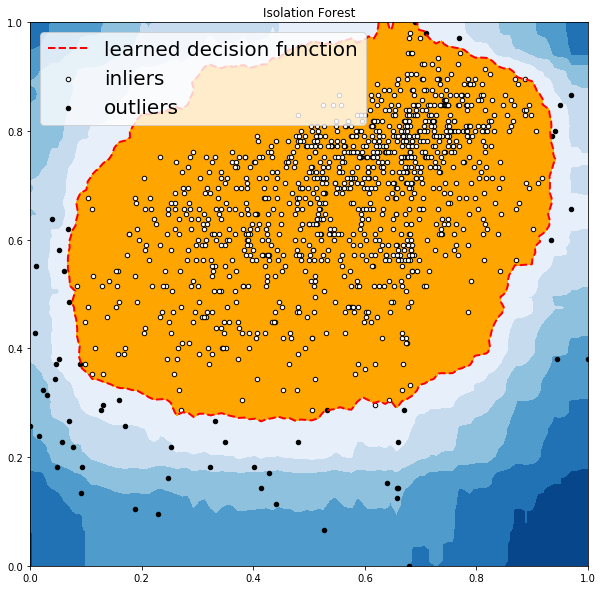

OUTLIERS :  42 INLIERS :  1099 K Nearest Neighbors (KNN)


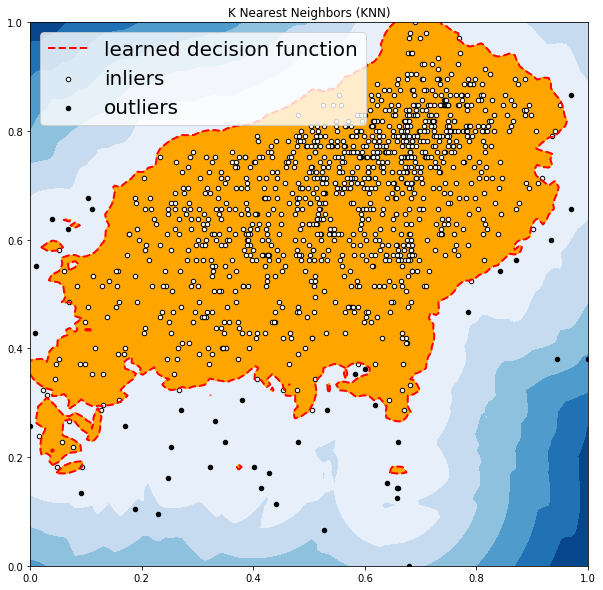

OUTLIERS :  26 INLIERS :  1115 Average KNN


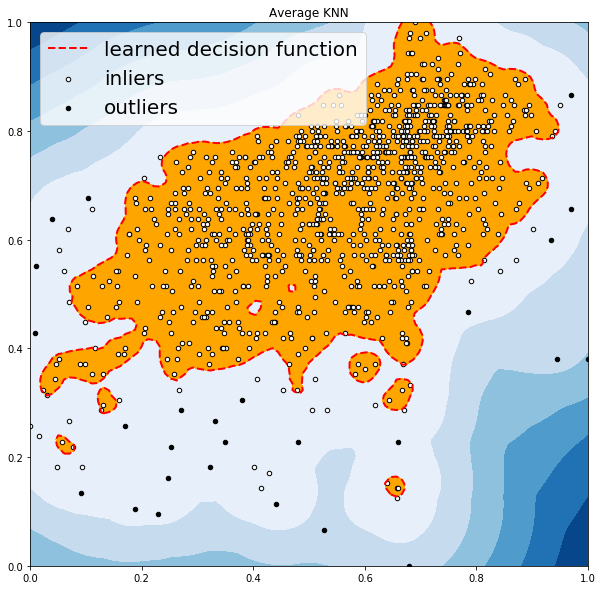



dataset abalone: abalone_benchmark_0680.csv
OUTLIERS :  45 INLIERS :  858 Angle-based Outlier Detector (ABOD)


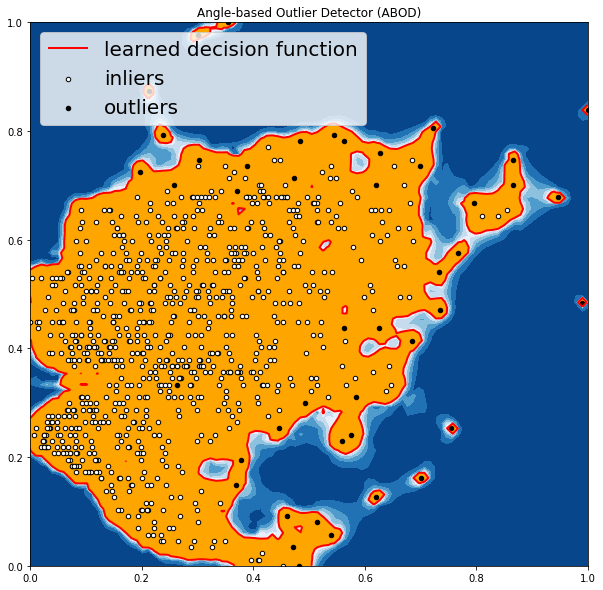

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


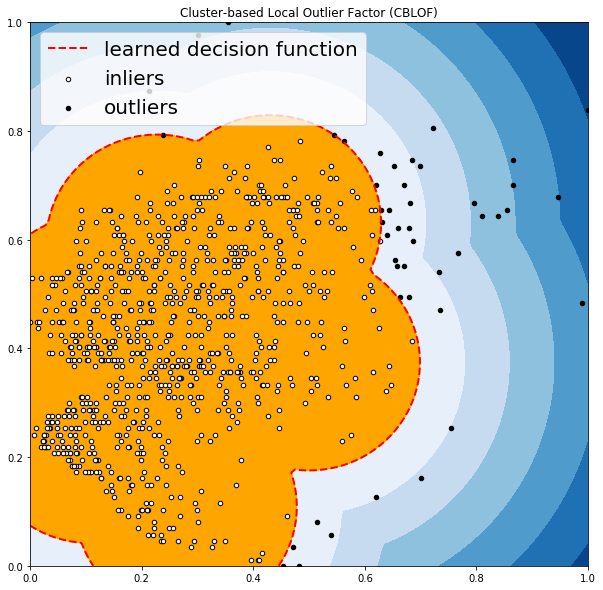

OUTLIERS :  45 INLIERS :  858 Feature Bagging


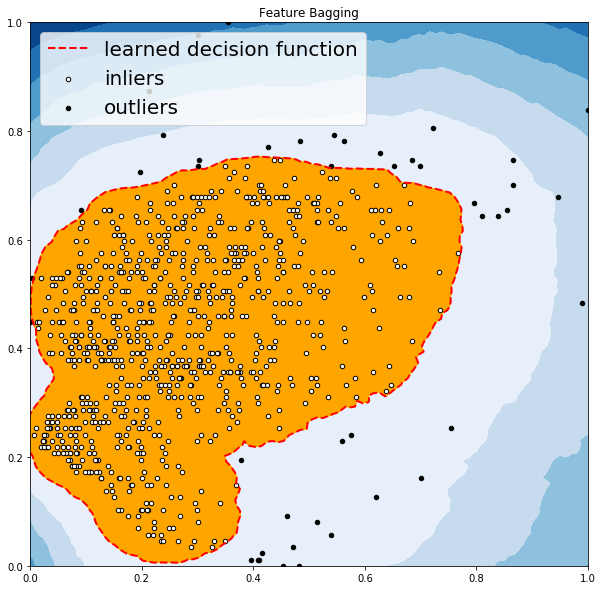

OUTLIERS :  40 INLIERS :  863 Histogram-base Outlier Detection (HBOS)


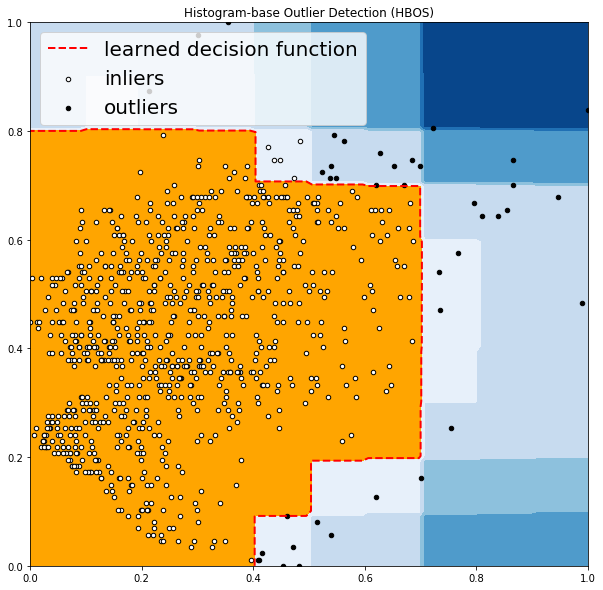

OUTLIERS :  46 INLIERS :  857 Isolation Forest


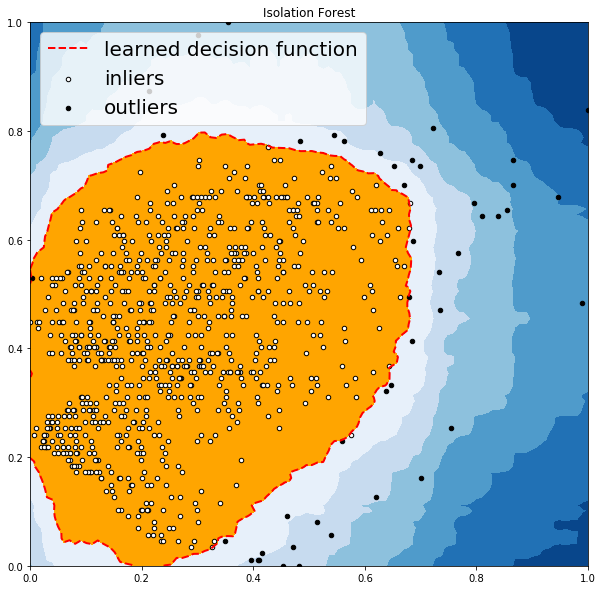

OUTLIERS :  34 INLIERS :  869 K Nearest Neighbors (KNN)


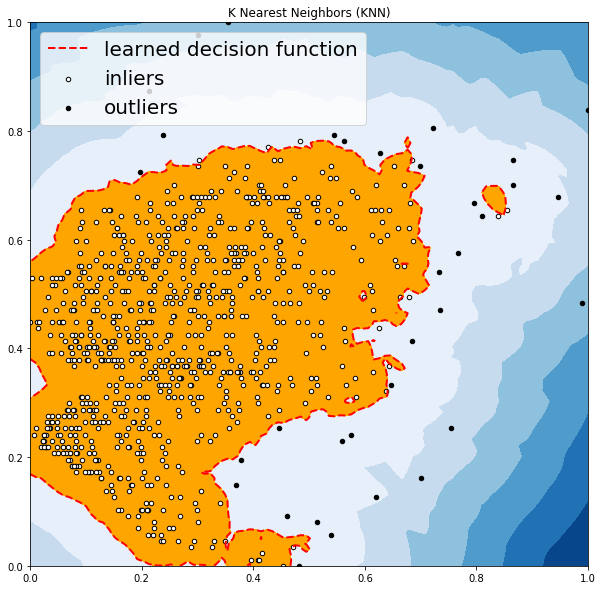

OUTLIERS :  25 INLIERS :  878 Average KNN


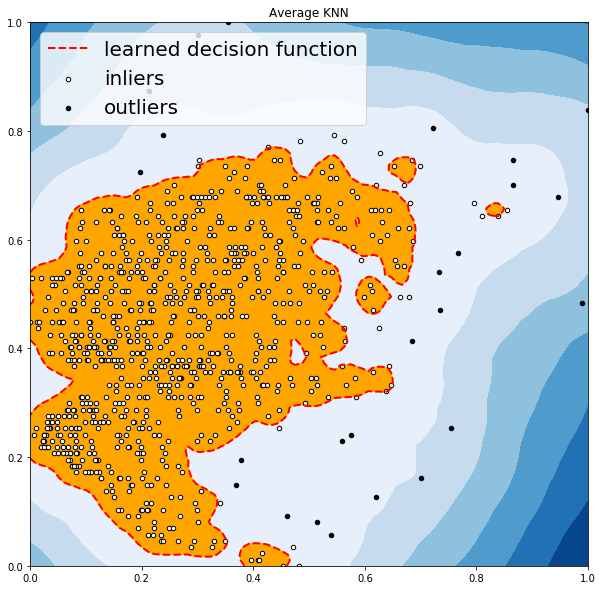



dataset abalone: abalone_benchmark_0694.csv
OUTLIERS :  46 INLIERS :  847 Angle-based Outlier Detector (ABOD)


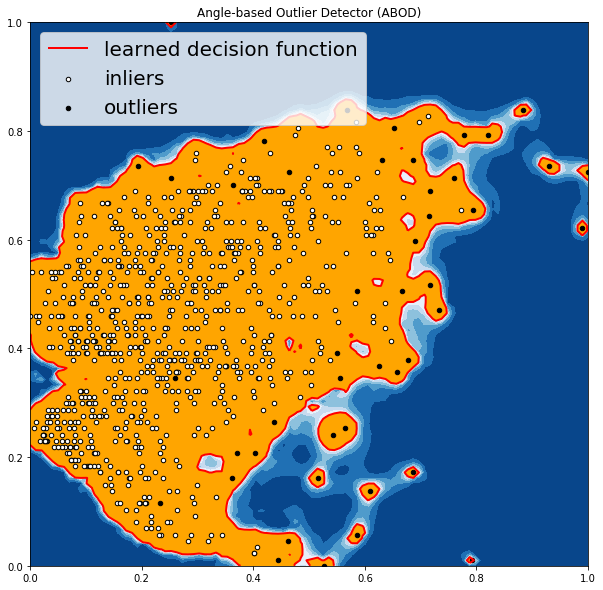

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


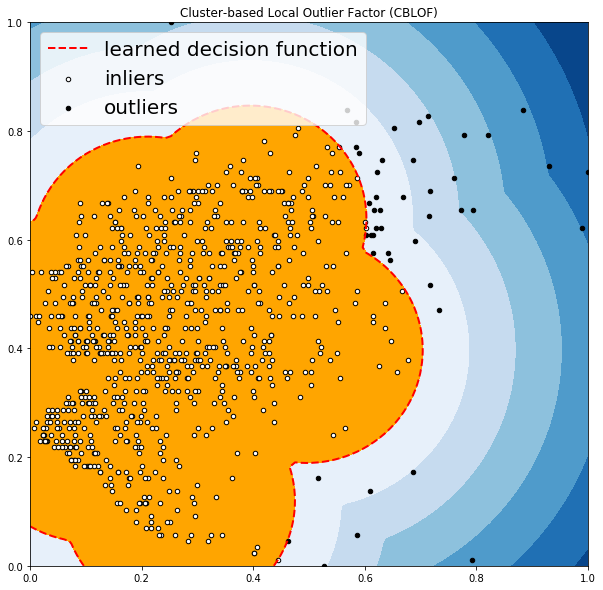

OUTLIERS :  44 INLIERS :  849 Feature Bagging


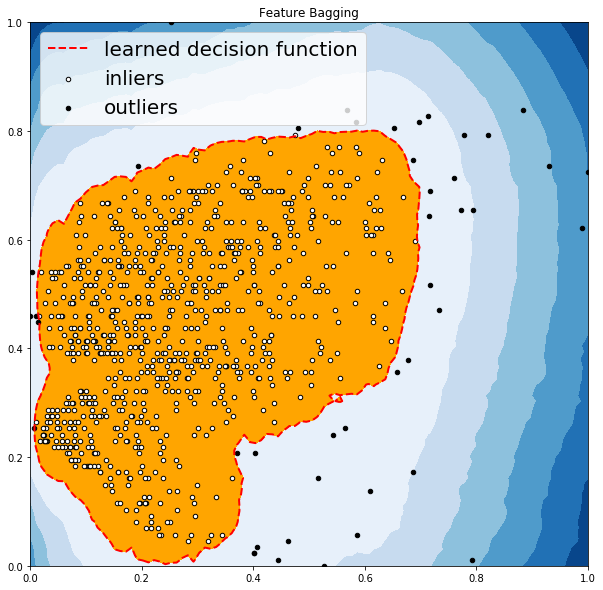

OUTLIERS :  41 INLIERS :  852 Histogram-base Outlier Detection (HBOS)


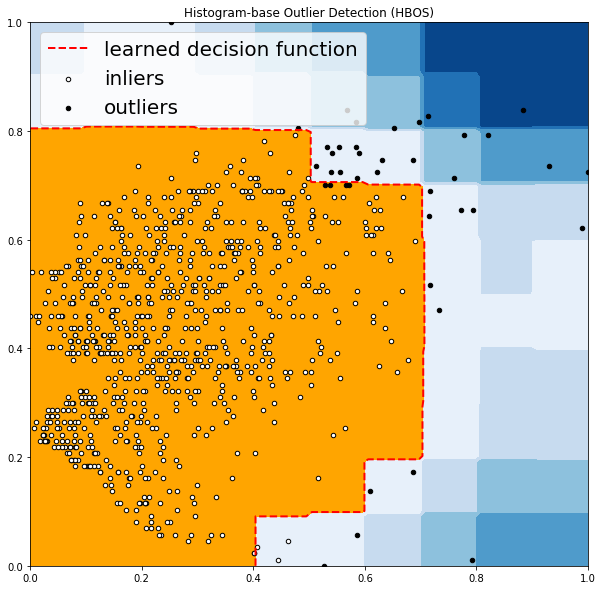

OUTLIERS :  45 INLIERS :  848 Isolation Forest


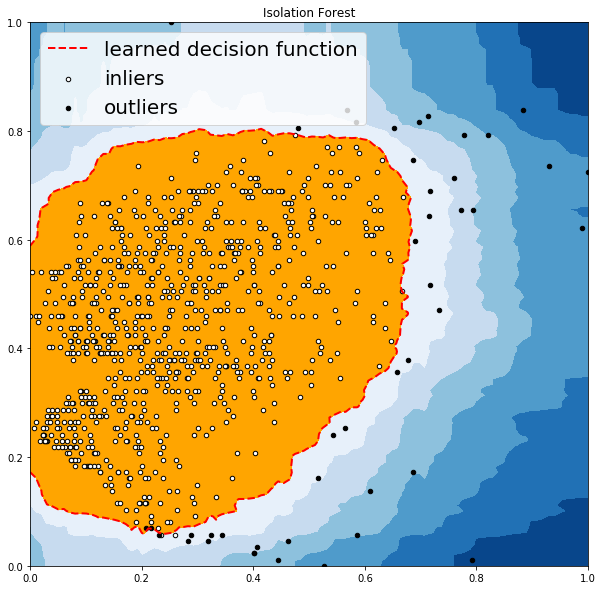

OUTLIERS :  30 INLIERS :  863 K Nearest Neighbors (KNN)


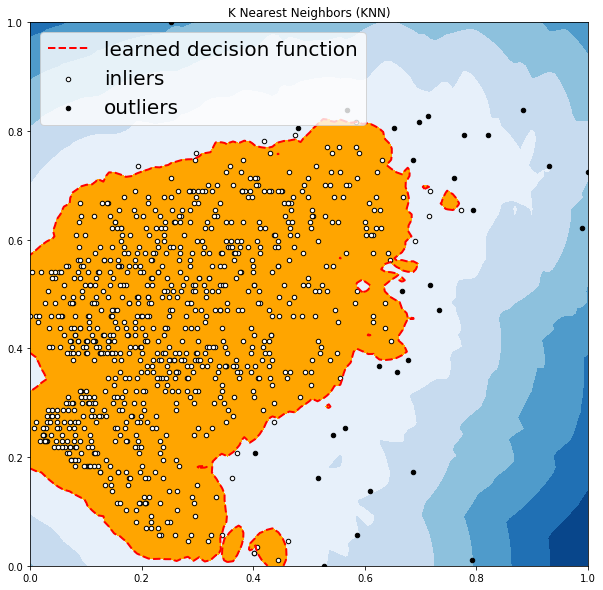

OUTLIERS :  20 INLIERS :  873 Average KNN


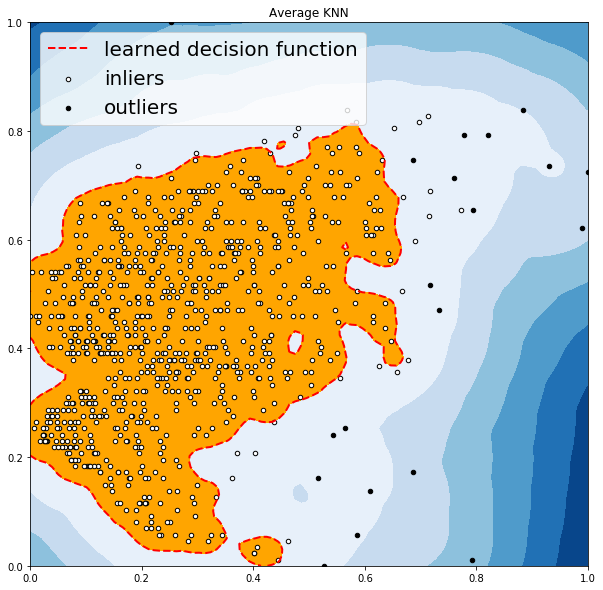

In [6]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[2]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1

        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))

        dfx = dataset
        dfx['outlier'] = y_pred.tolist()
        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)
        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)
        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)

        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')

        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')
        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')
        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数

### 3.3 diff.score, V3



dataset abalone: abalone_benchmark_0864.csv
OUTLIERS :  56 INLIERS :  1085 Angle-based Outlier Detector (ABOD)


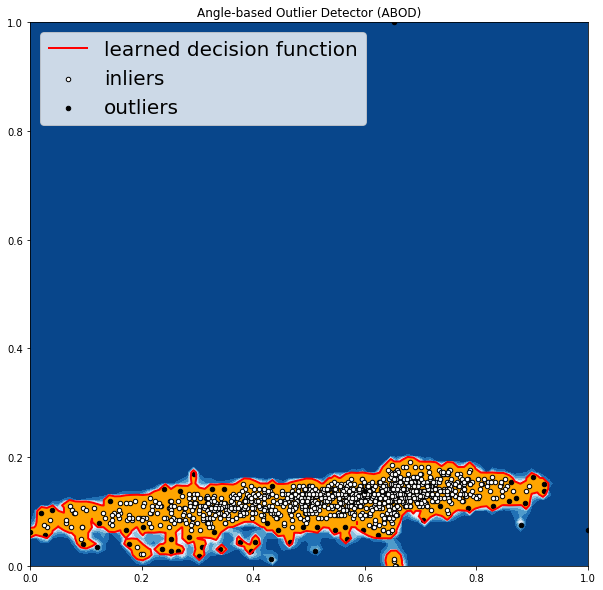

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


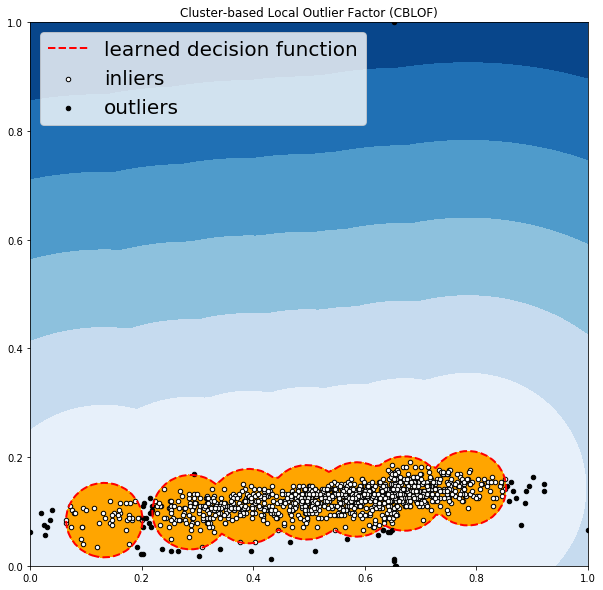

OUTLIERS :  30 INLIERS :  1111 Feature Bagging


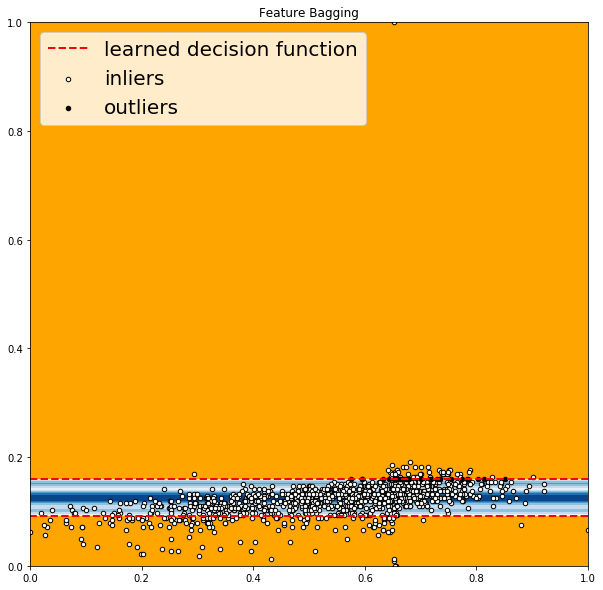

OUTLIERS :  45 INLIERS :  1096 Histogram-base Outlier Detection (HBOS)


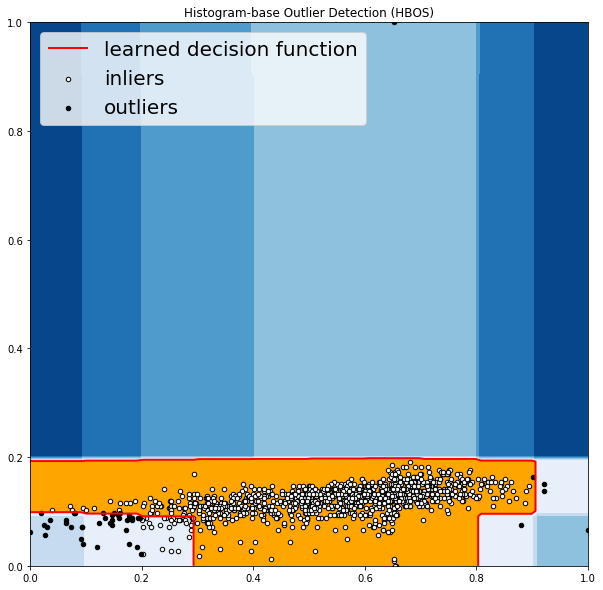

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


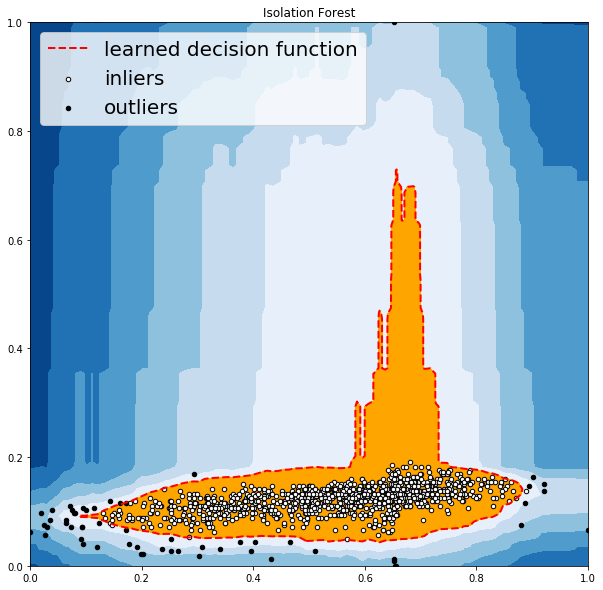

OUTLIERS :  48 INLIERS :  1093 K Nearest Neighbors (KNN)


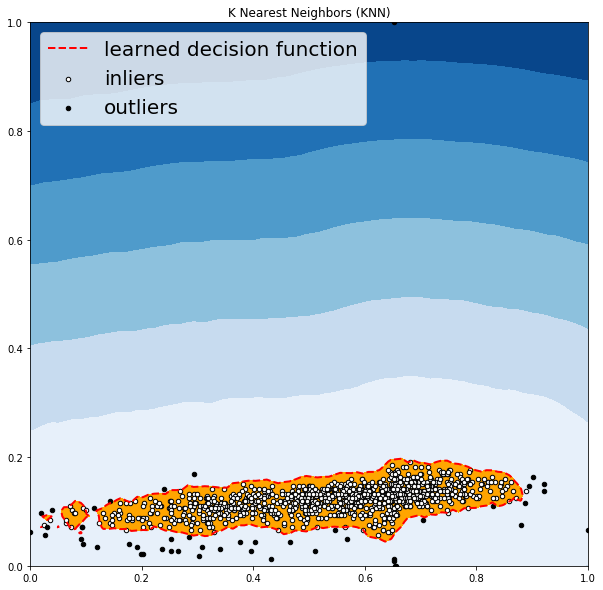

OUTLIERS :  29 INLIERS :  1112 Average KNN


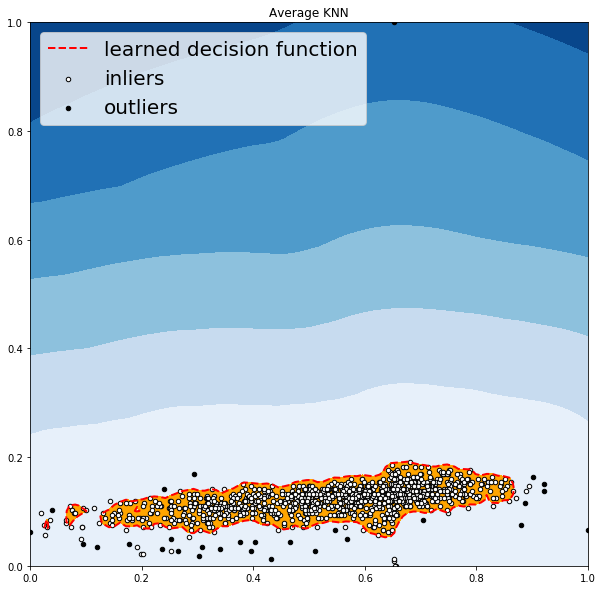



dataset abalone: abalone_benchmark_0870.csv
OUTLIERS :  58 INLIERS :  1088 Angle-based Outlier Detector (ABOD)


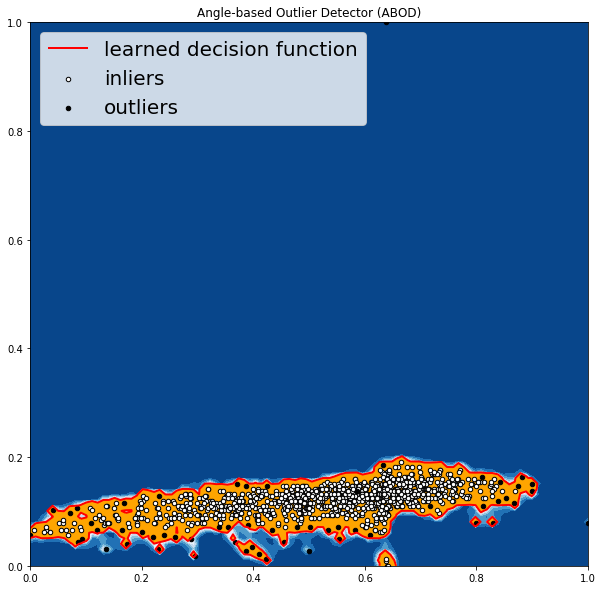

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


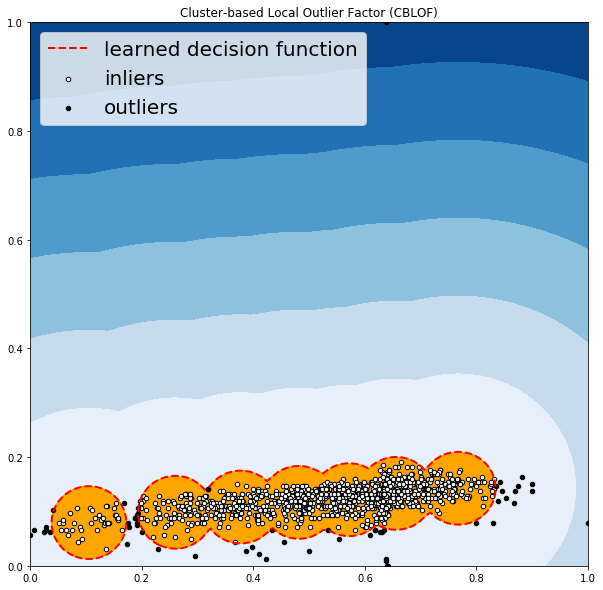

OUTLIERS :  56 INLIERS :  1090 Feature Bagging


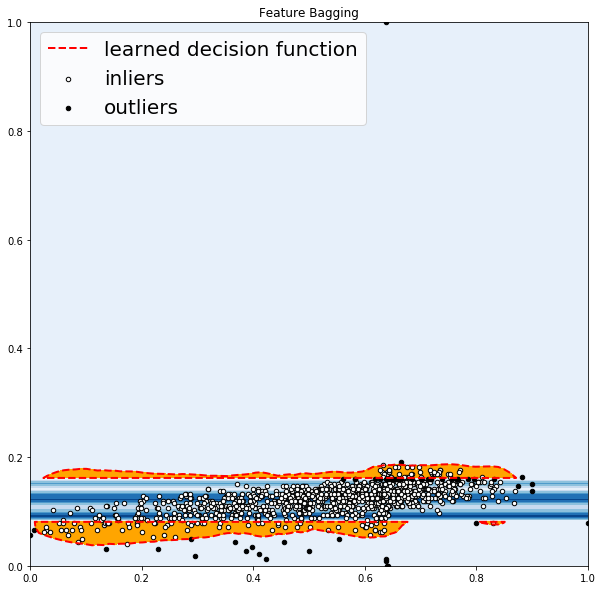

OUTLIERS :  53 INLIERS :  1093 Histogram-base Outlier Detection (HBOS)


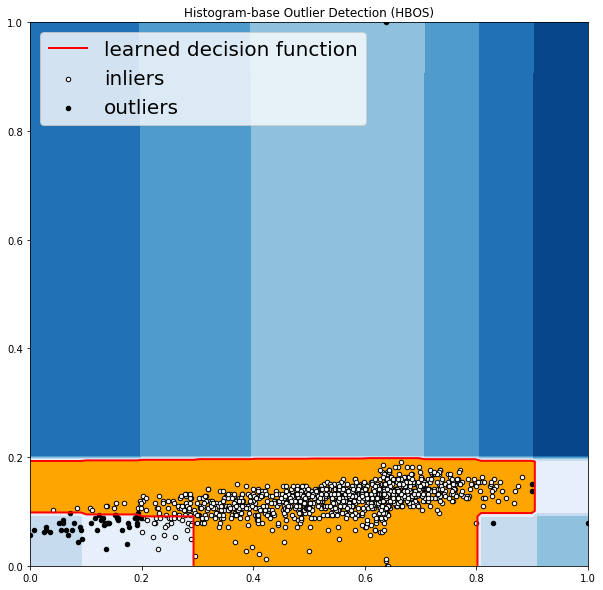

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


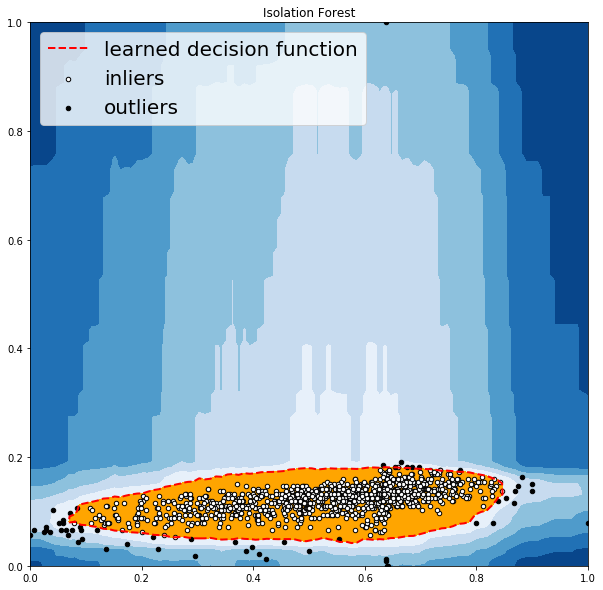

OUTLIERS :  40 INLIERS :  1106 K Nearest Neighbors (KNN)


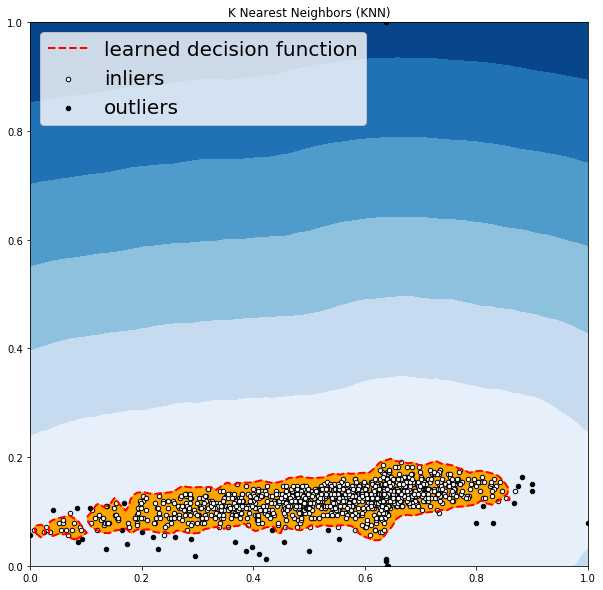

OUTLIERS :  32 INLIERS :  1114 Average KNN


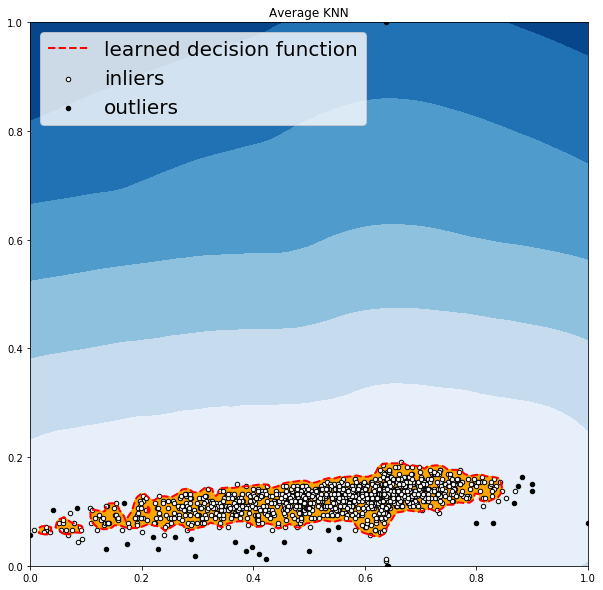



dataset abalone: abalone_benchmark_0858.csv
OUTLIERS :  61 INLIERS :  1080 Angle-based Outlier Detector (ABOD)


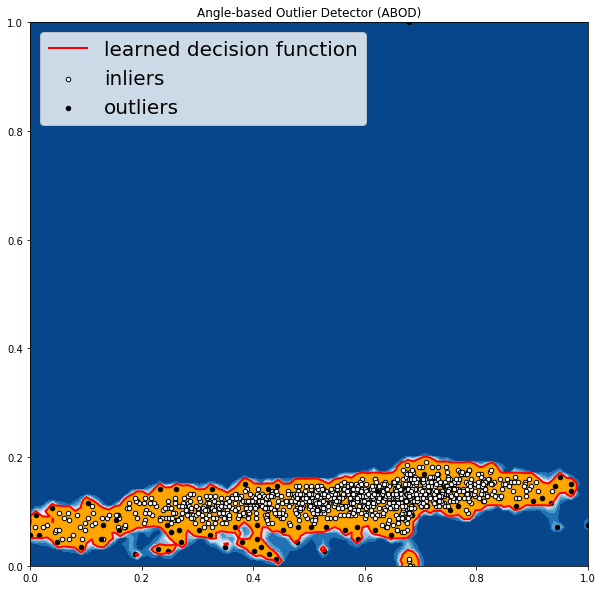

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


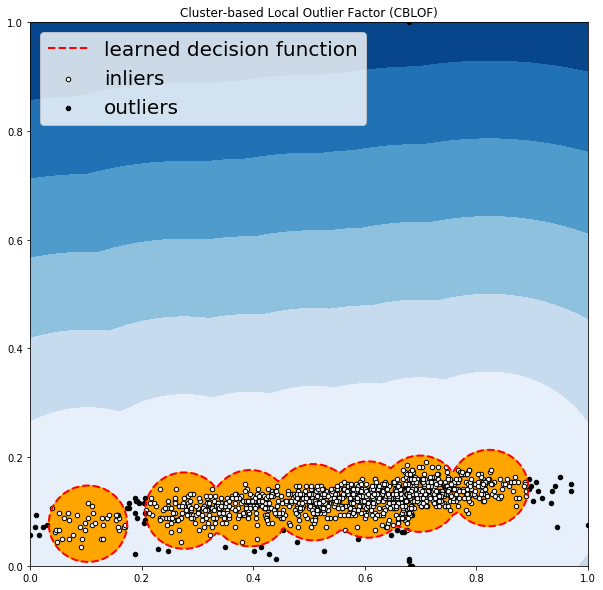

OUTLIERS :  55 INLIERS :  1086 Feature Bagging


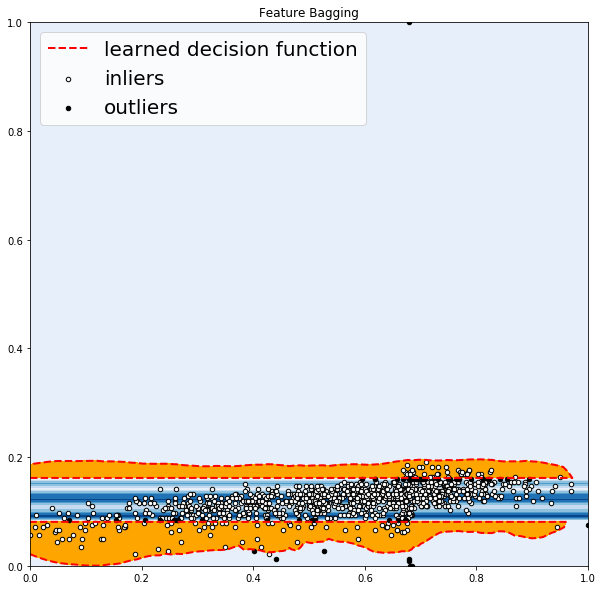

OUTLIERS :  49 INLIERS :  1092 Histogram-base Outlier Detection (HBOS)


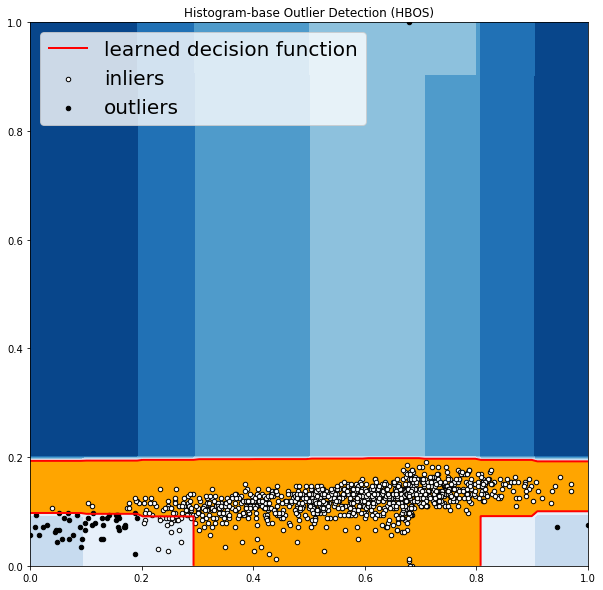

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


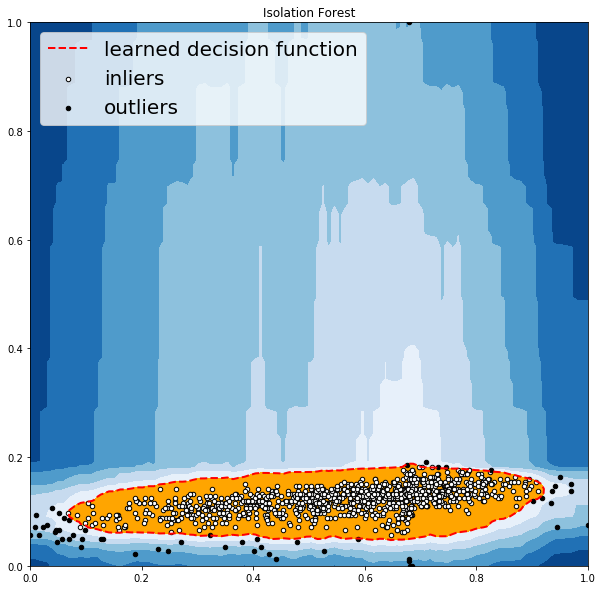

OUTLIERS :  41 INLIERS :  1100 K Nearest Neighbors (KNN)


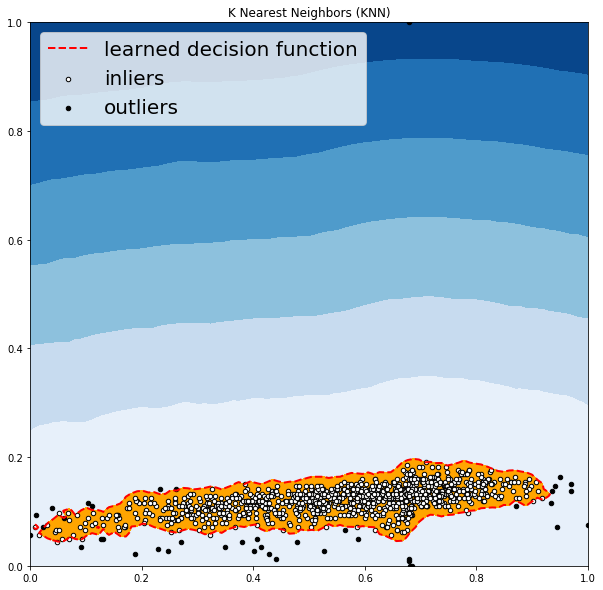

OUTLIERS :  27 INLIERS :  1114 Average KNN


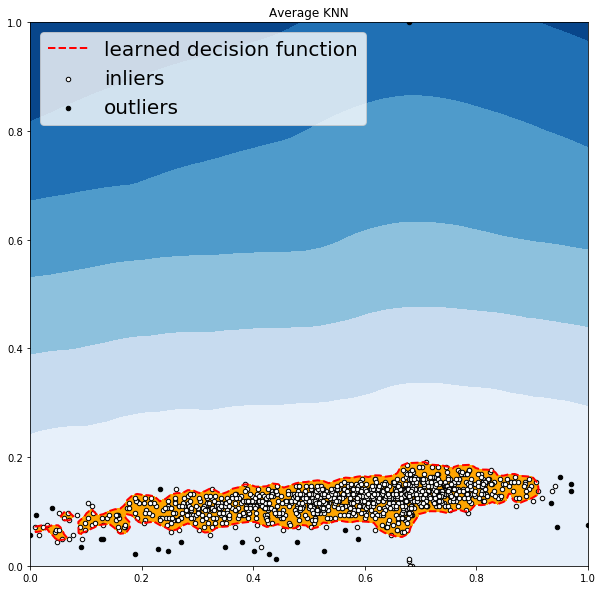



dataset abalone: abalone_benchmark_0680.csv
OUTLIERS :  44 INLIERS :  859 Angle-based Outlier Detector (ABOD)


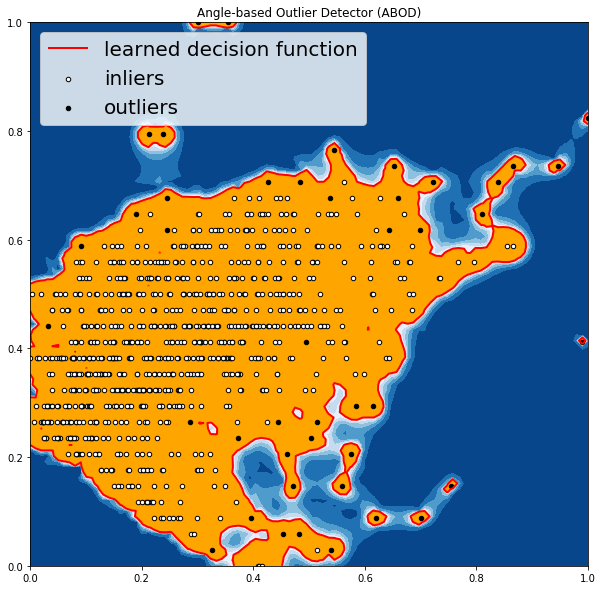

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


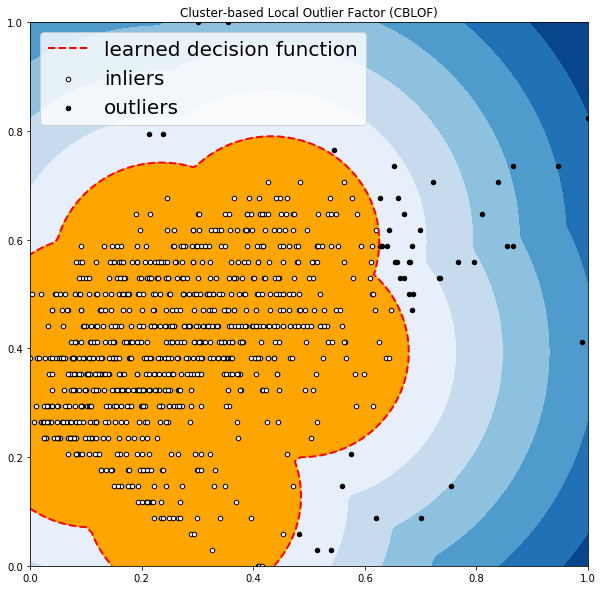

OUTLIERS :  10 INLIERS :  893 Feature Bagging


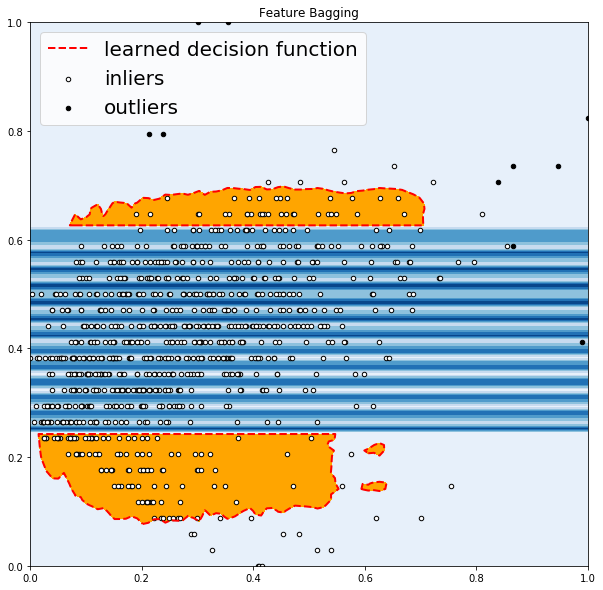

OUTLIERS :  46 INLIERS :  857 Histogram-base Outlier Detection (HBOS)


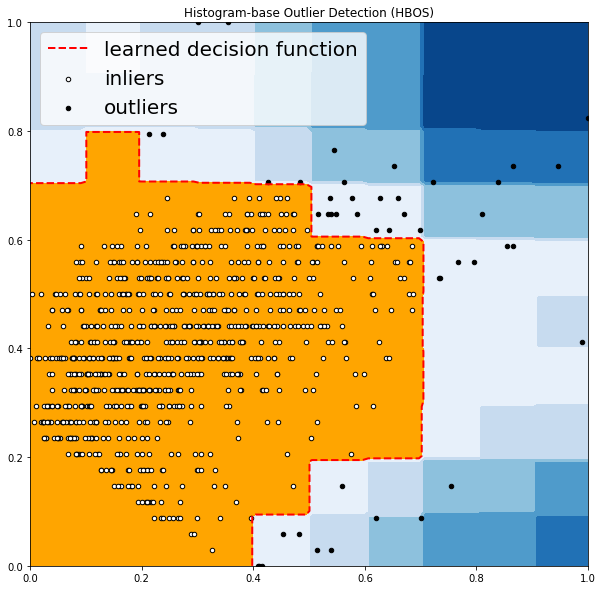

OUTLIERS :  46 INLIERS :  857 Isolation Forest


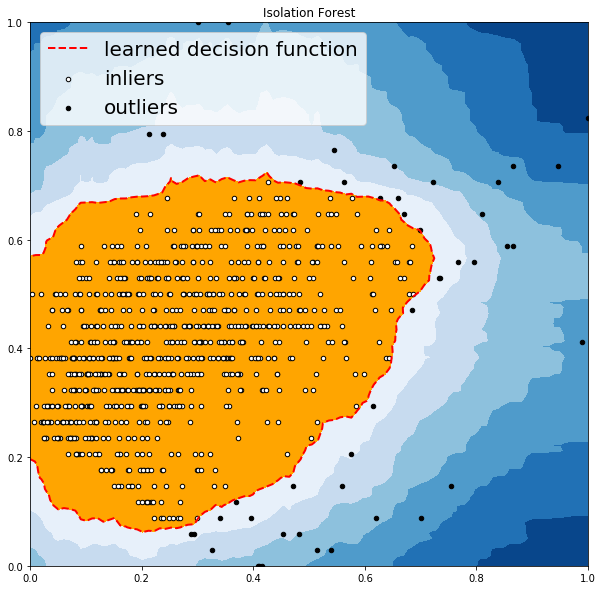

OUTLIERS :  39 INLIERS :  864 K Nearest Neighbors (KNN)


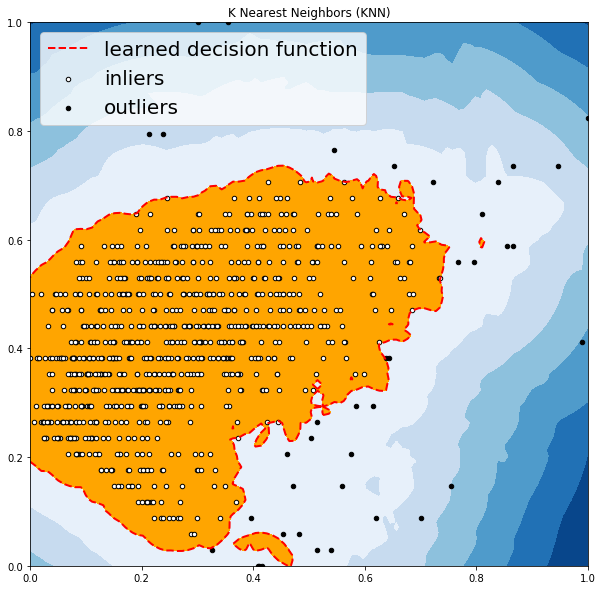

OUTLIERS :  21 INLIERS :  882 Average KNN


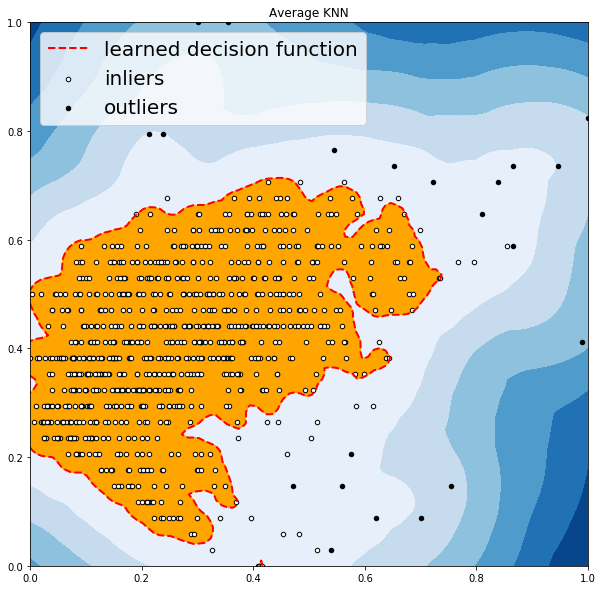



dataset abalone: abalone_benchmark_0694.csv
OUTLIERS :  48 INLIERS :  845 Angle-based Outlier Detector (ABOD)


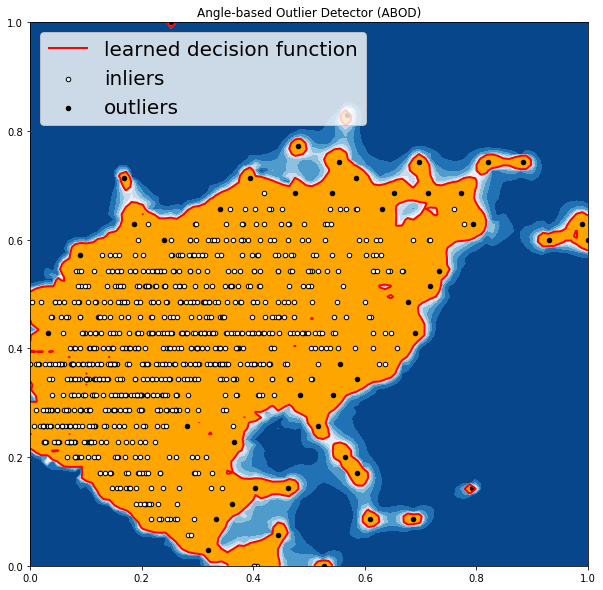

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


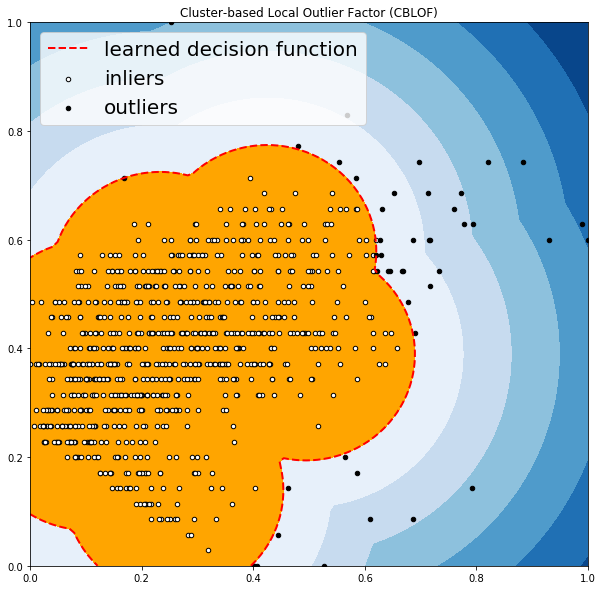

OUTLIERS :  43 INLIERS :  850 Feature Bagging


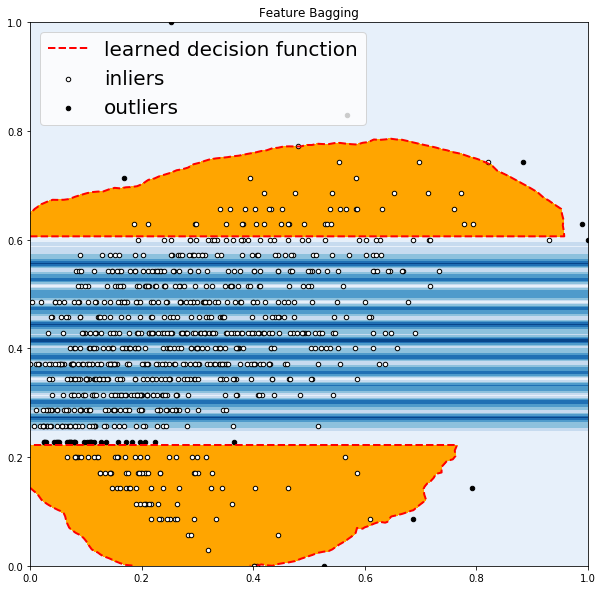

OUTLIERS :  40 INLIERS :  853 Histogram-base Outlier Detection (HBOS)


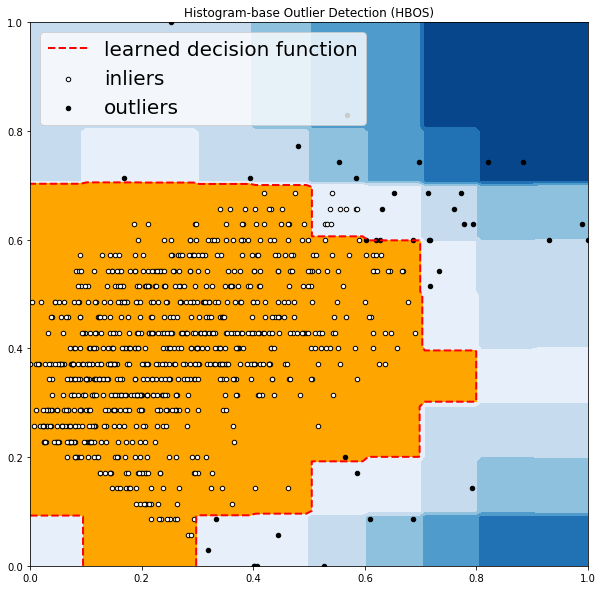

OUTLIERS :  45 INLIERS :  848 Isolation Forest


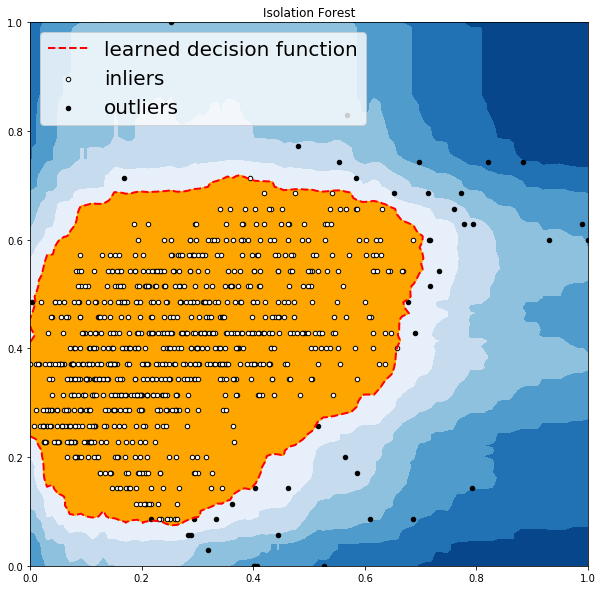

OUTLIERS :  41 INLIERS :  852 K Nearest Neighbors (KNN)


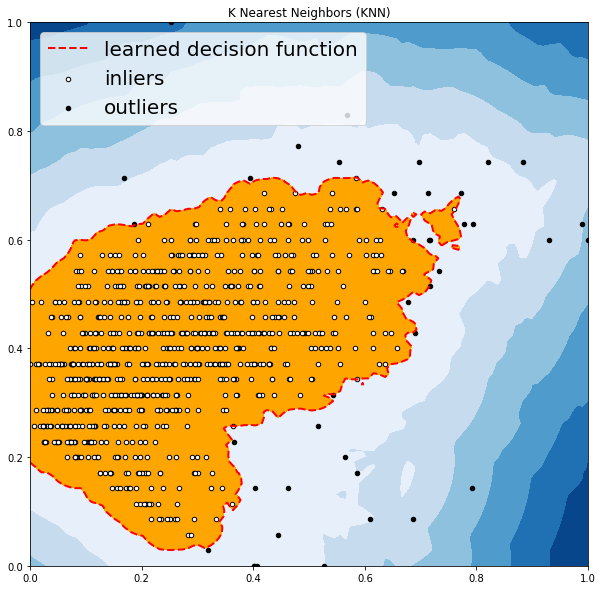

OUTLIERS :  23 INLIERS :  870 Average KNN


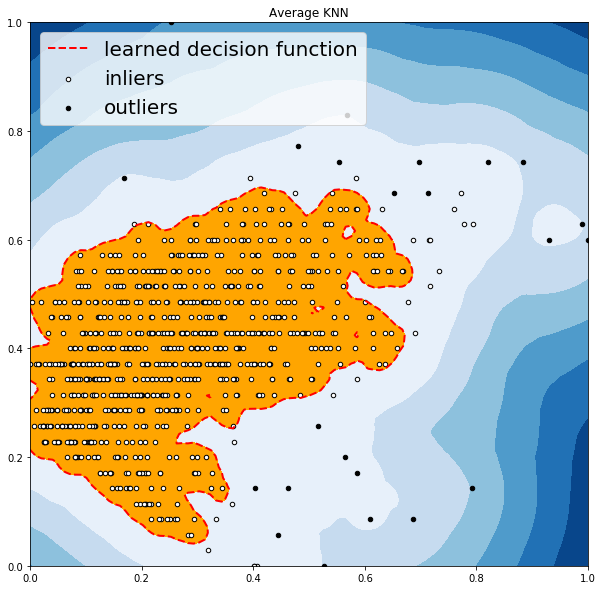

In [7]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[3]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)
    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1
        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))

        dfx = dataset
        dfx['outlier'] = y_pred.tolist()
        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)
        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)
        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)
        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')

        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')

        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')

        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数

### 3.4 diff.score, V4



dataset abalone: abalone_benchmark_0864.csv
OUTLIERS :  52 INLIERS :  1089 Angle-based Outlier Detector (ABOD)


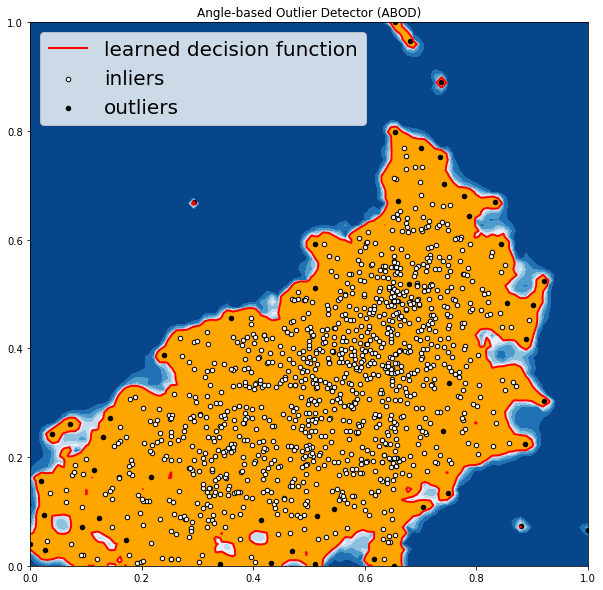

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


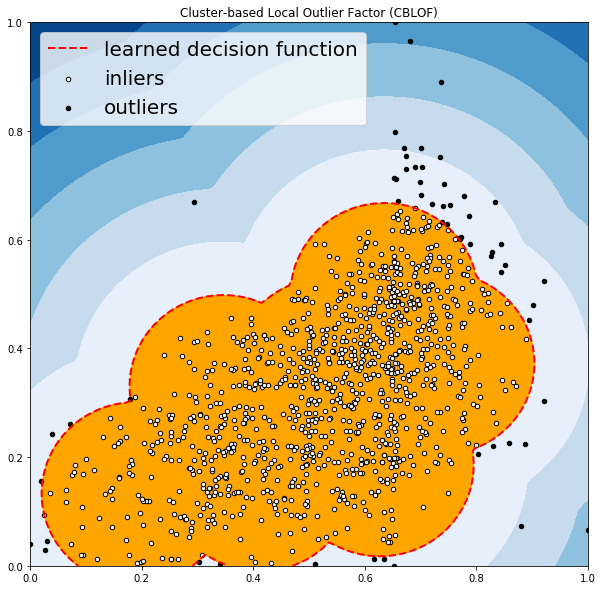

OUTLIERS :  53 INLIERS :  1088 Feature Bagging


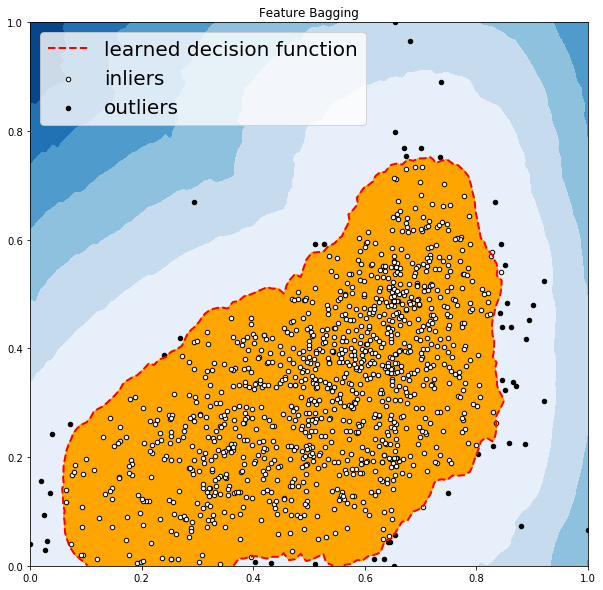

OUTLIERS :  56 INLIERS :  1085 Histogram-base Outlier Detection (HBOS)


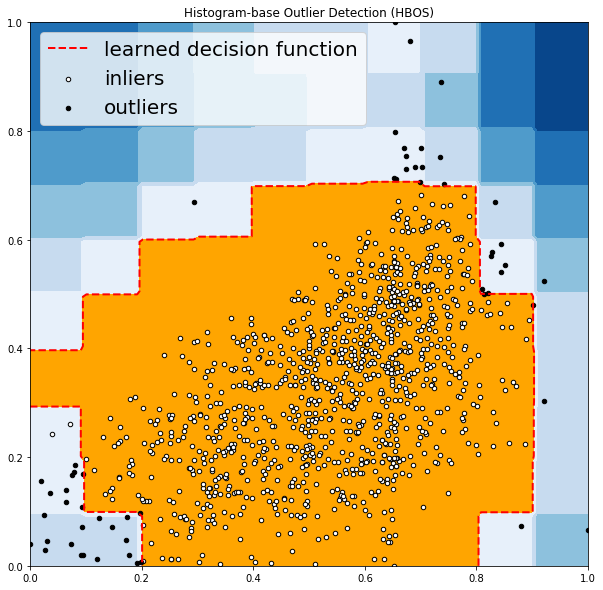

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


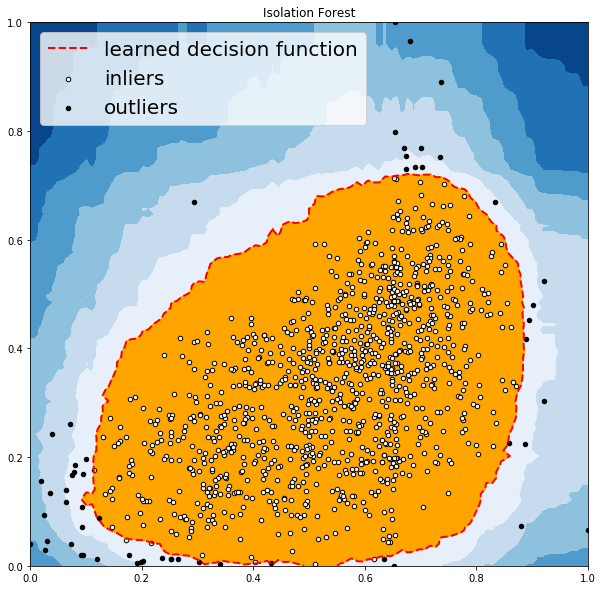

OUTLIERS :  45 INLIERS :  1096 K Nearest Neighbors (KNN)


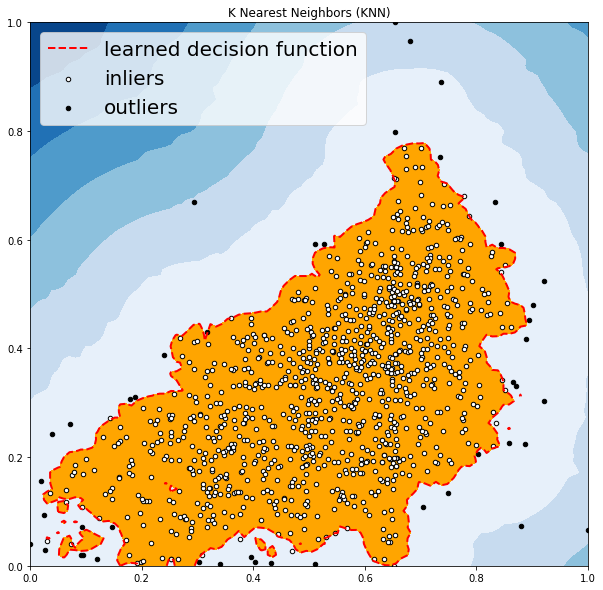

OUTLIERS :  20 INLIERS :  1121 Average KNN


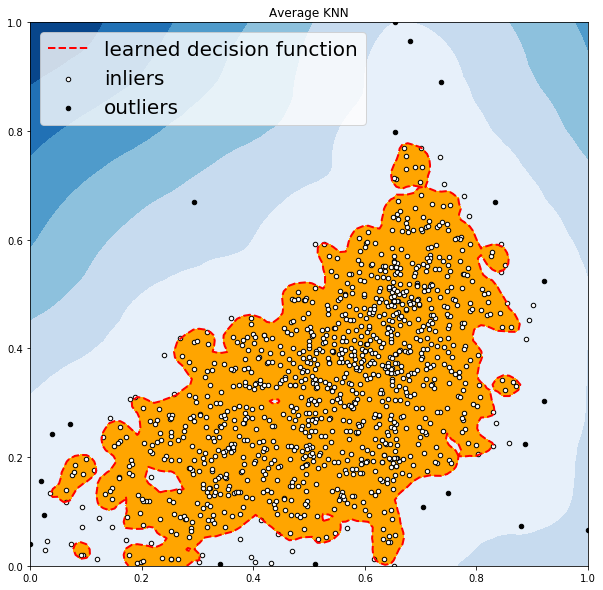



dataset abalone: abalone_benchmark_0870.csv
OUTLIERS :  57 INLIERS :  1089 Angle-based Outlier Detector (ABOD)


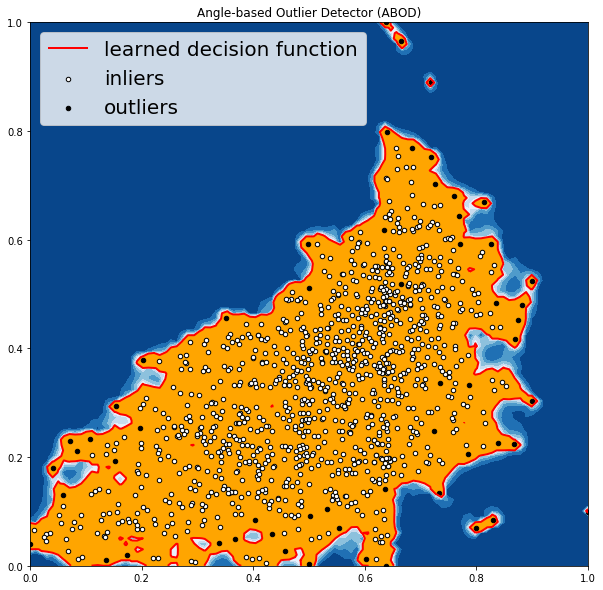

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


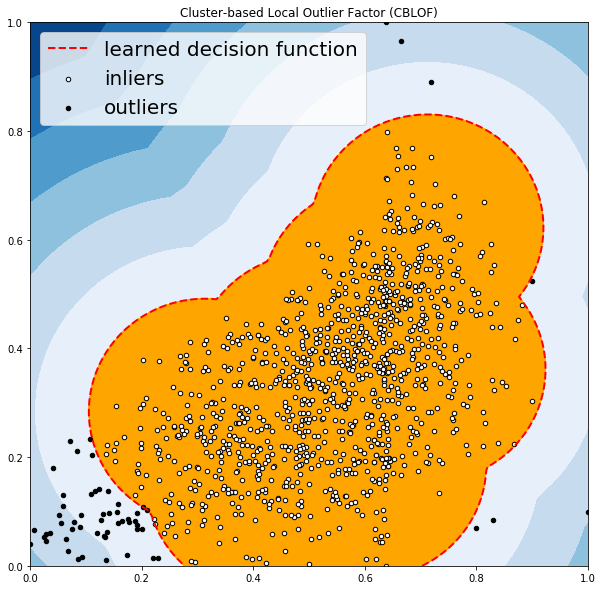

OUTLIERS :  52 INLIERS :  1094 Feature Bagging


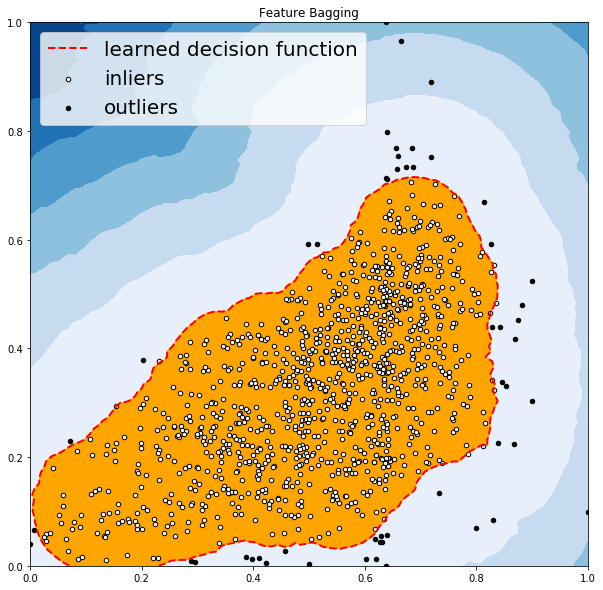

OUTLIERS :  53 INLIERS :  1093 Histogram-base Outlier Detection (HBOS)


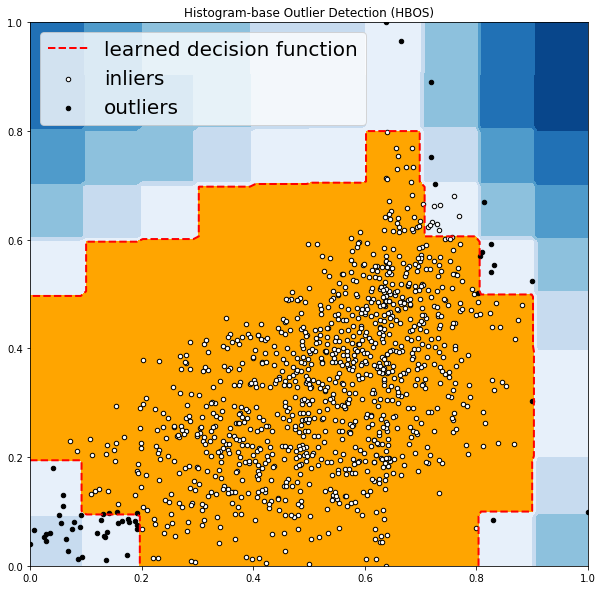

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


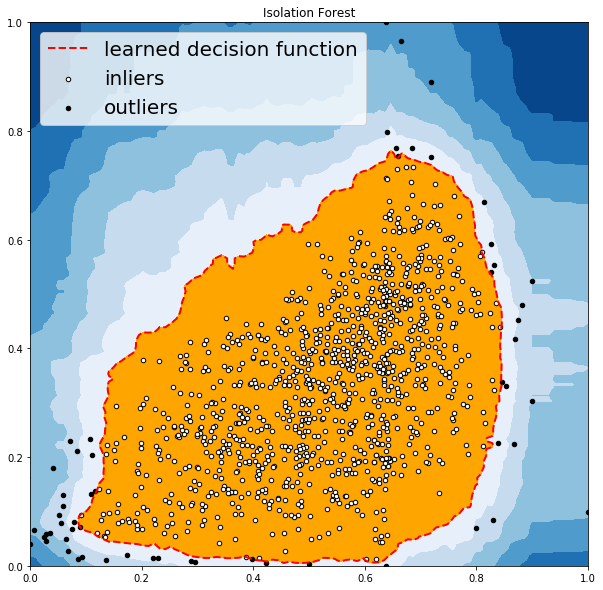

OUTLIERS :  41 INLIERS :  1105 K Nearest Neighbors (KNN)


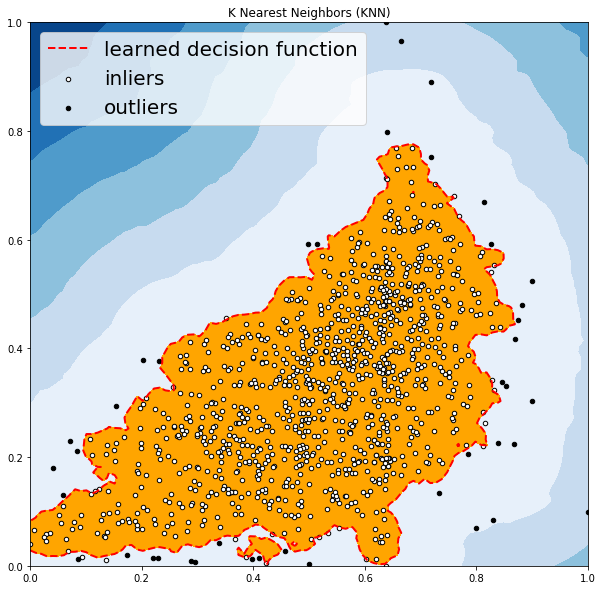

OUTLIERS :  21 INLIERS :  1125 Average KNN


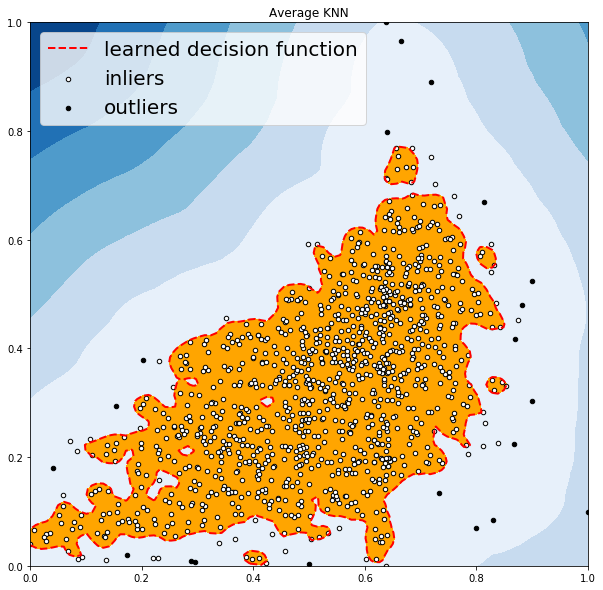



dataset abalone: abalone_benchmark_0858.csv
OUTLIERS :  55 INLIERS :  1086 Angle-based Outlier Detector (ABOD)


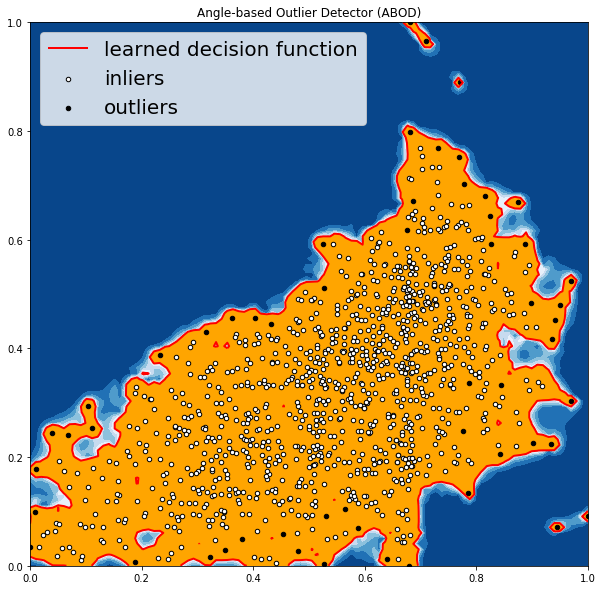

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


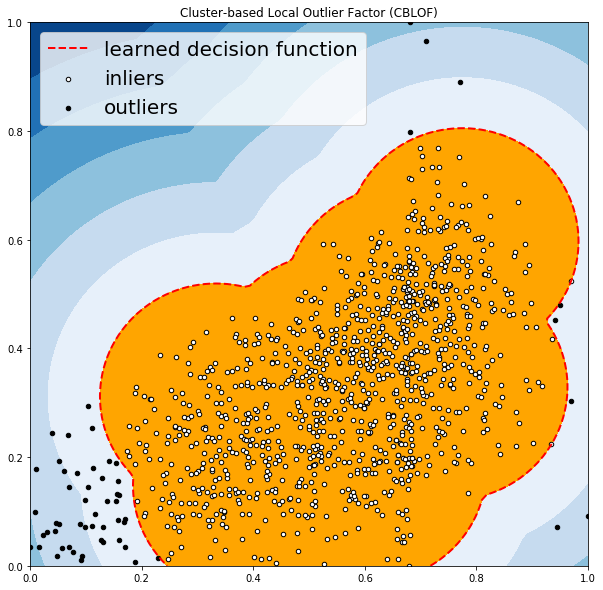

OUTLIERS :  47 INLIERS :  1094 Feature Bagging


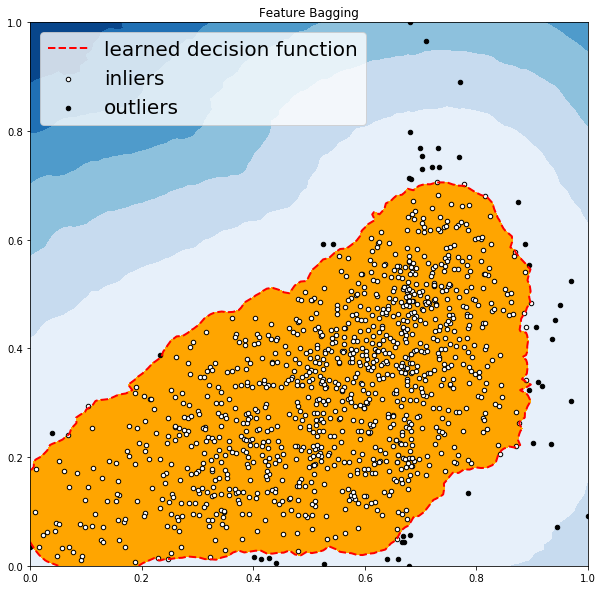

OUTLIERS :  56 INLIERS :  1085 Histogram-base Outlier Detection (HBOS)


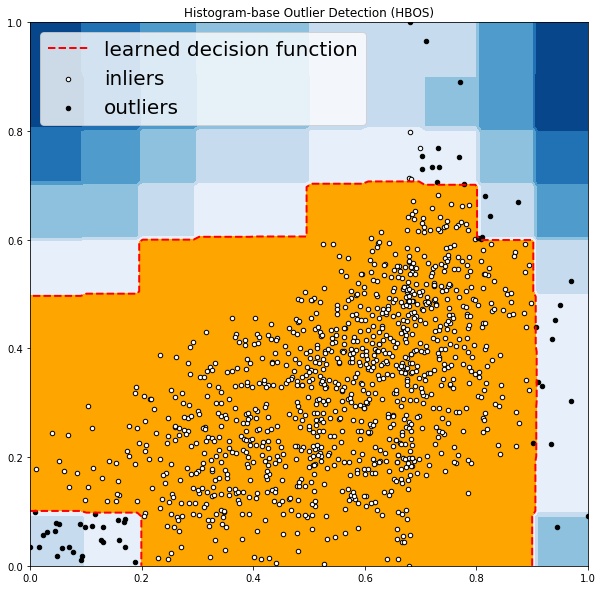

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


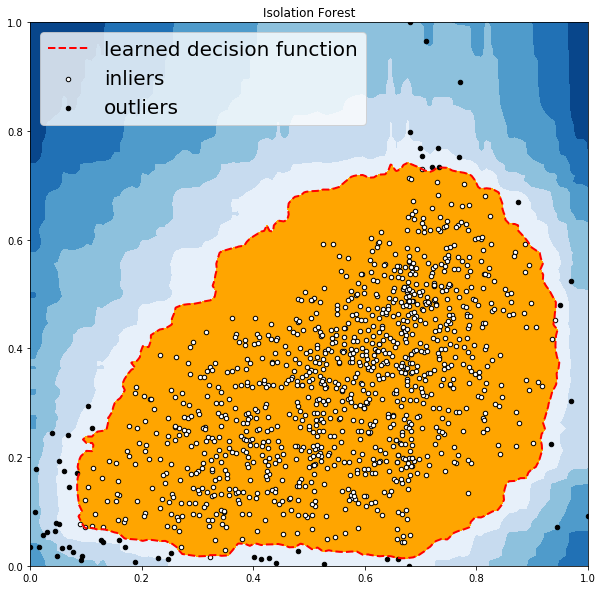

OUTLIERS :  40 INLIERS :  1101 K Nearest Neighbors (KNN)


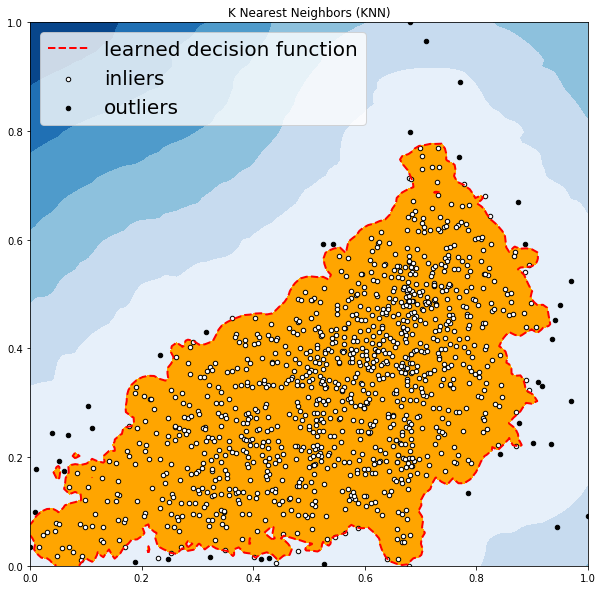

OUTLIERS :  23 INLIERS :  1118 Average KNN


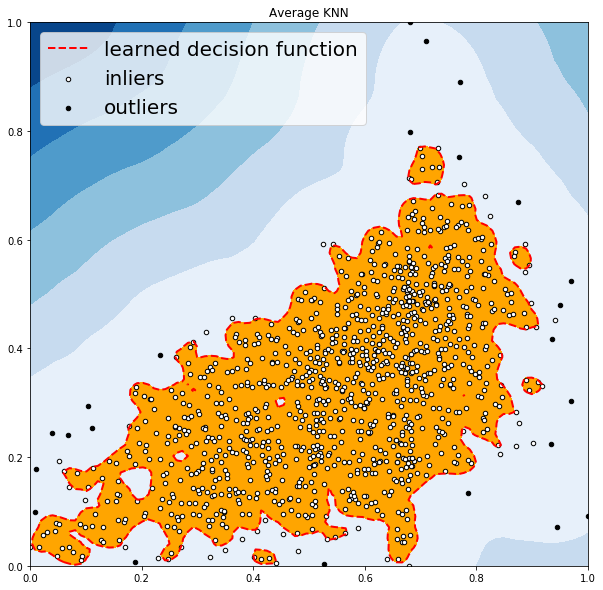



dataset abalone: abalone_benchmark_0680.csv
OUTLIERS :  42 INLIERS :  861 Angle-based Outlier Detector (ABOD)


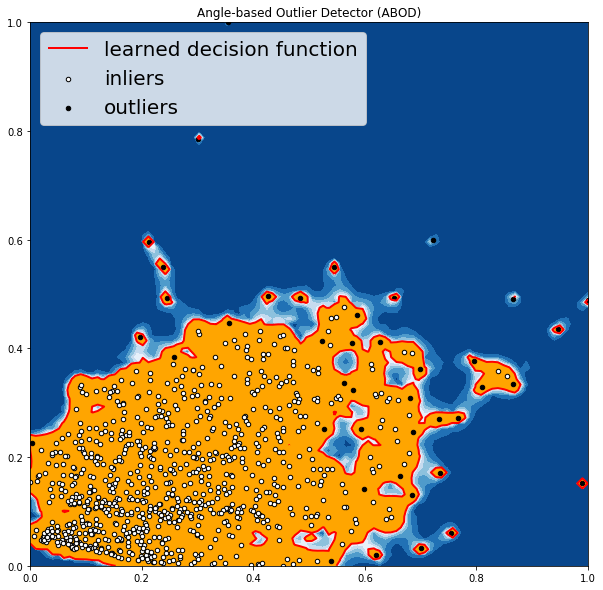

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


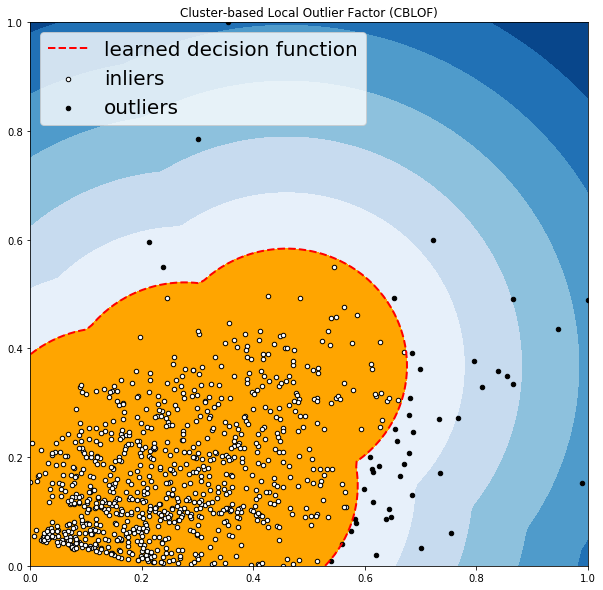

OUTLIERS :  41 INLIERS :  862 Feature Bagging


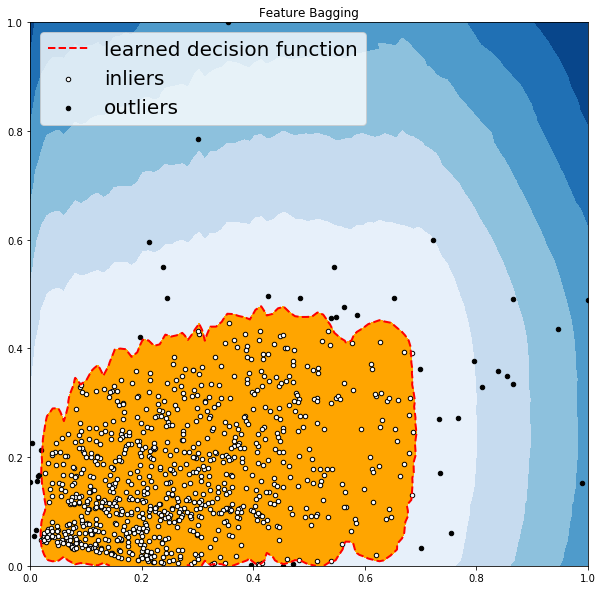

OUTLIERS :  39 INLIERS :  864 Histogram-base Outlier Detection (HBOS)


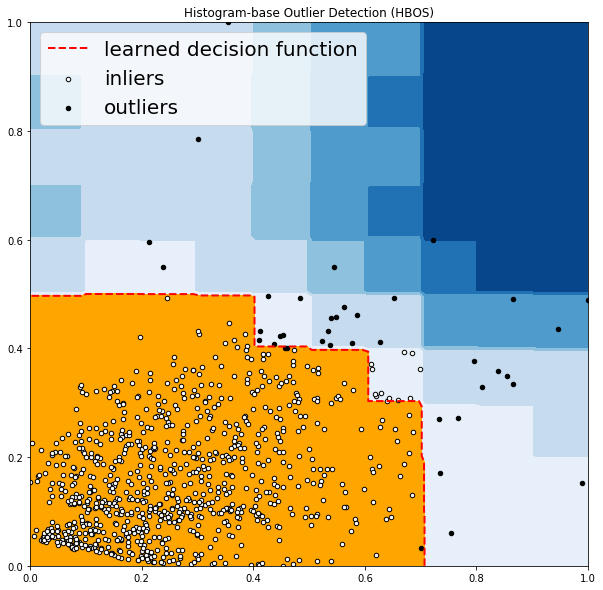

OUTLIERS :  46 INLIERS :  857 Isolation Forest


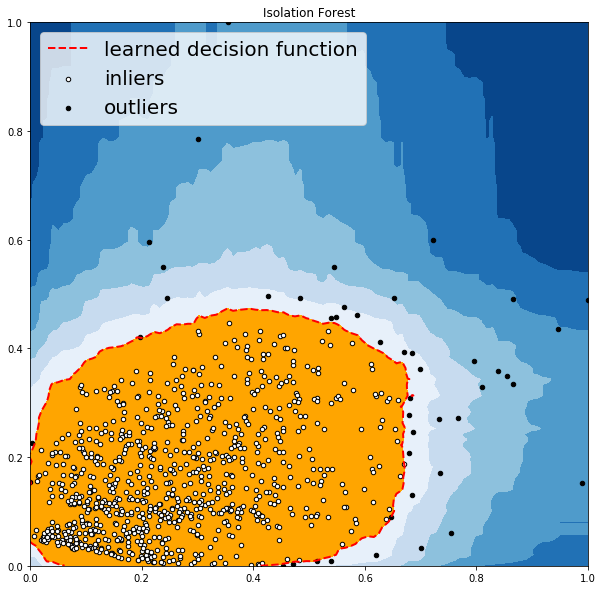

OUTLIERS :  38 INLIERS :  865 K Nearest Neighbors (KNN)


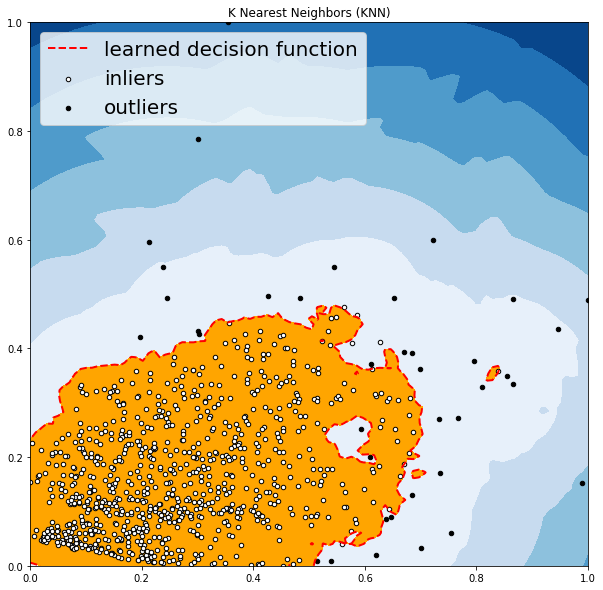

OUTLIERS :  26 INLIERS :  877 Average KNN


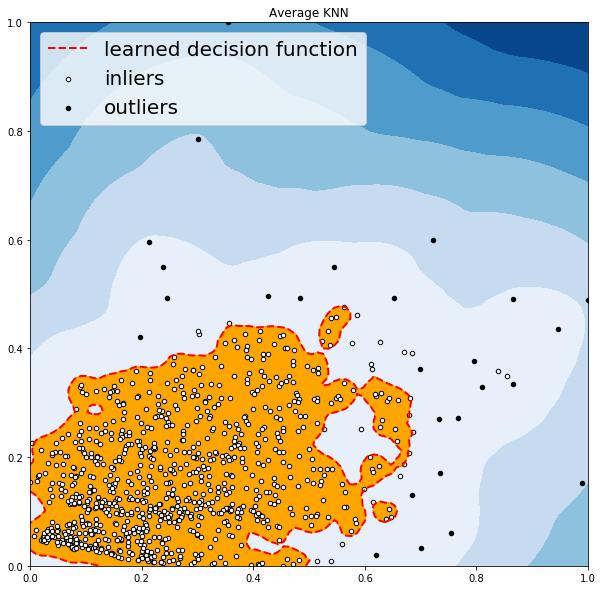



dataset abalone: abalone_benchmark_0694.csv
OUTLIERS :  42 INLIERS :  851 Angle-based Outlier Detector (ABOD)


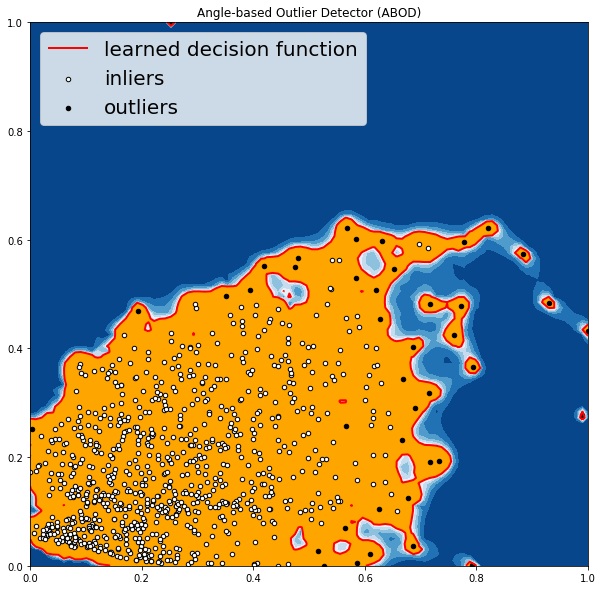

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


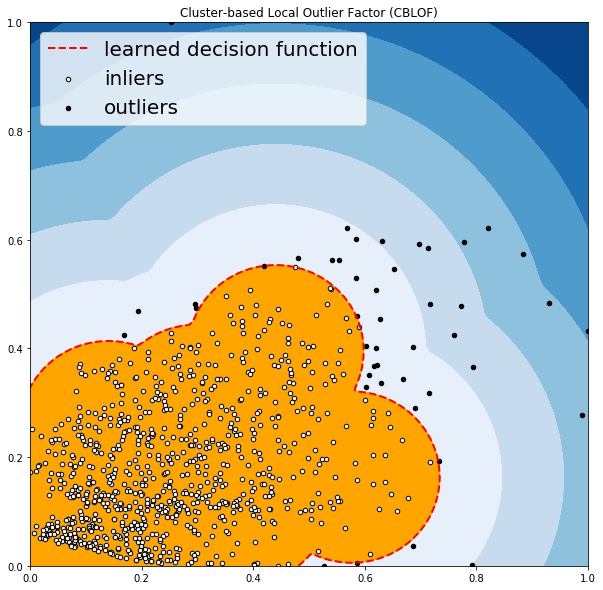

OUTLIERS :  41 INLIERS :  852 Feature Bagging


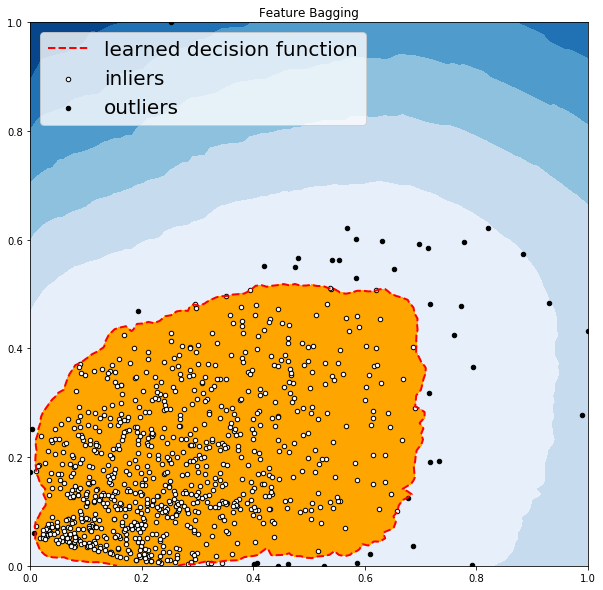

OUTLIERS :  40 INLIERS :  853 Histogram-base Outlier Detection (HBOS)


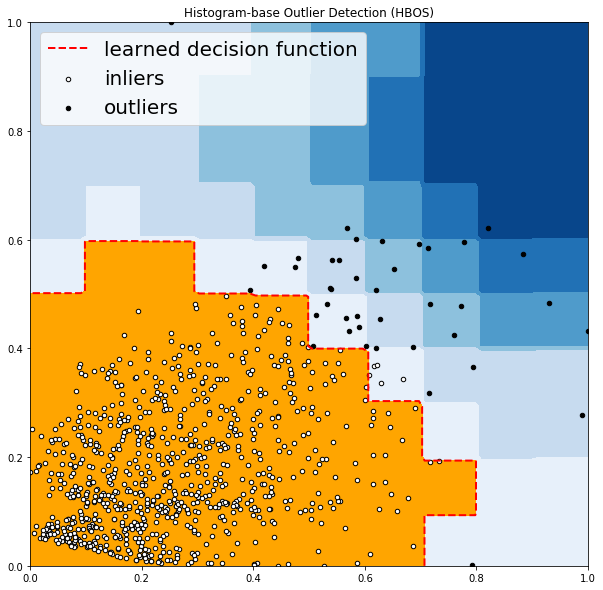

OUTLIERS :  45 INLIERS :  848 Isolation Forest


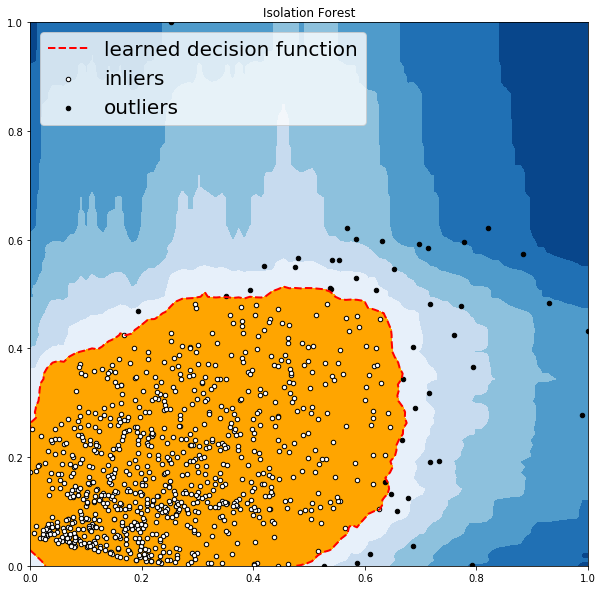

OUTLIERS :  38 INLIERS :  855 K Nearest Neighbors (KNN)


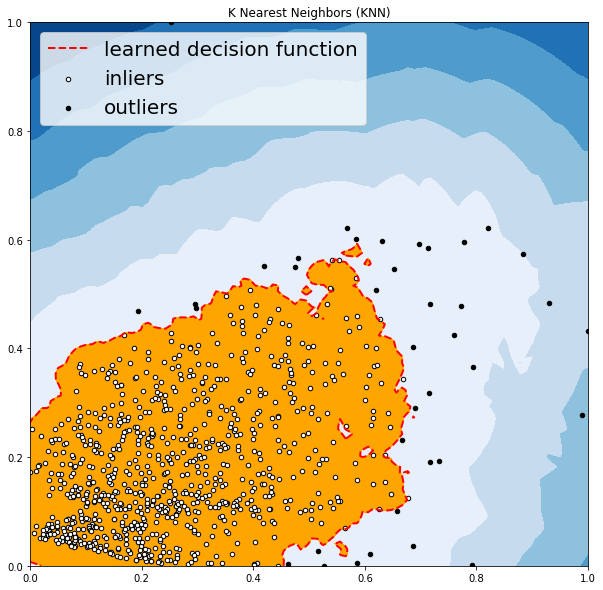

OUTLIERS :  25 INLIERS :  868 Average KNN


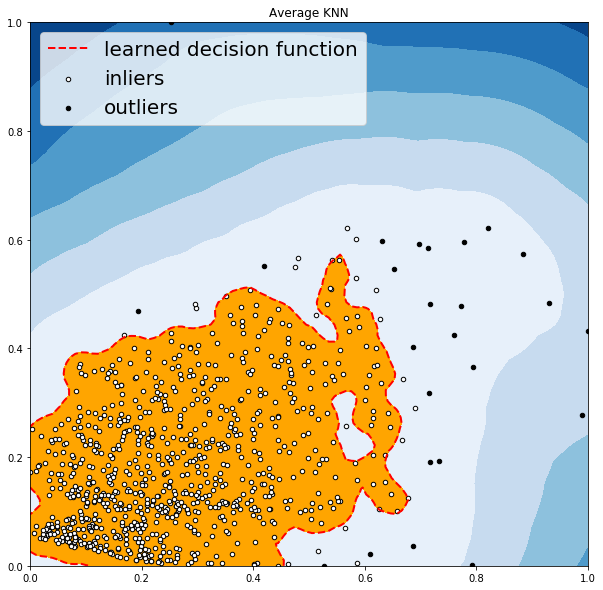

In [8]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[4]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1

        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))

        dfx = dataset
        dfx['outlier'] = y_pred.tolist()
        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)
        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)

        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)

        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)
        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')

        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')

        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')
        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数

### 3.5 diff.score, V5



dataset abalone: abalone_benchmark_0864.csv
OUTLIERS :  57 INLIERS :  1084 Angle-based Outlier Detector (ABOD)


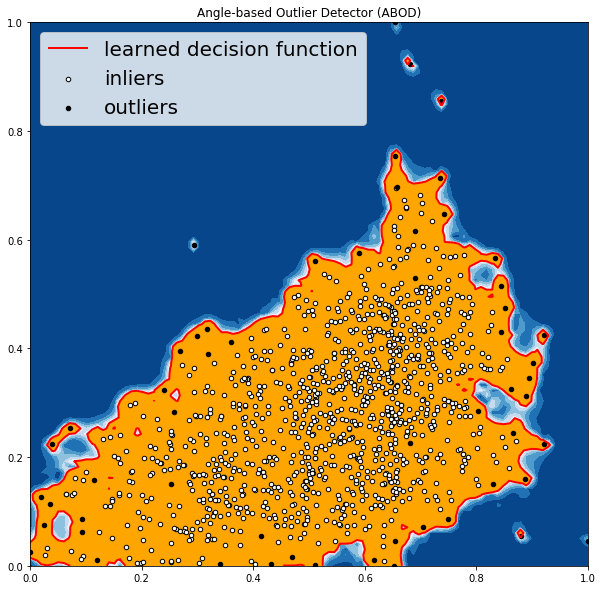

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


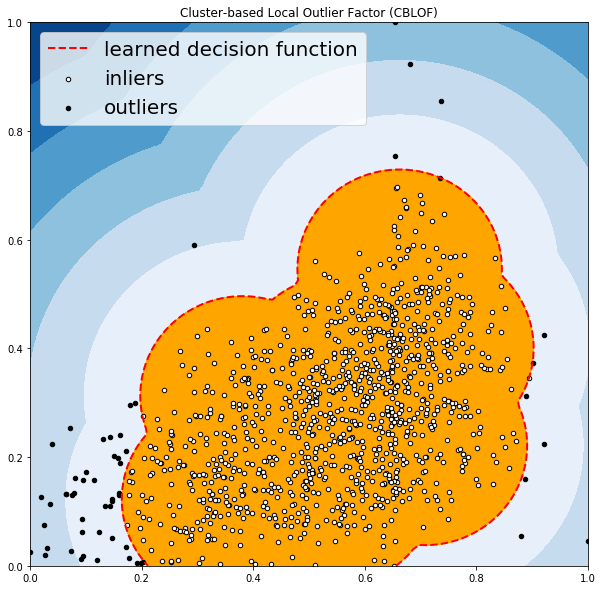

OUTLIERS :  49 INLIERS :  1092 Feature Bagging


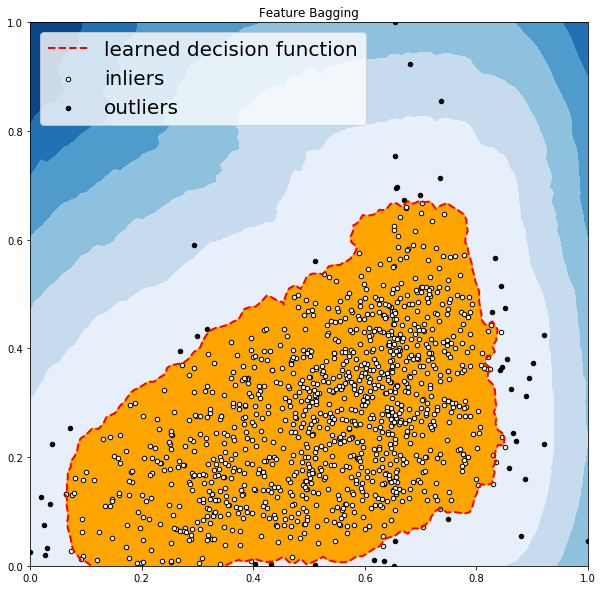

OUTLIERS :  54 INLIERS :  1087 Histogram-base Outlier Detection (HBOS)


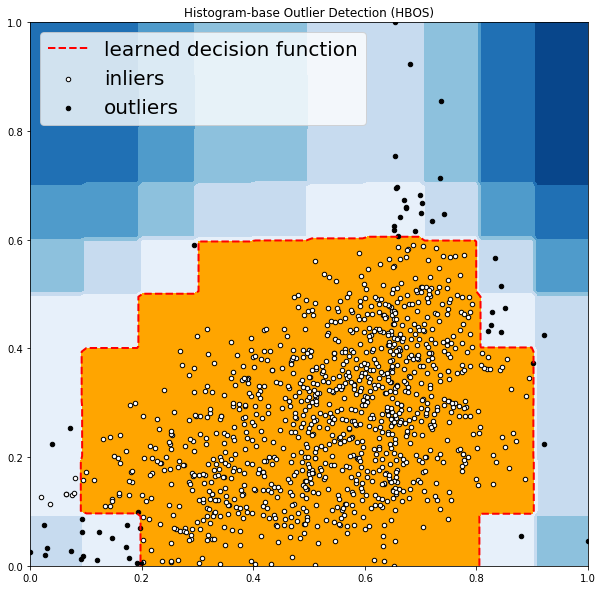

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


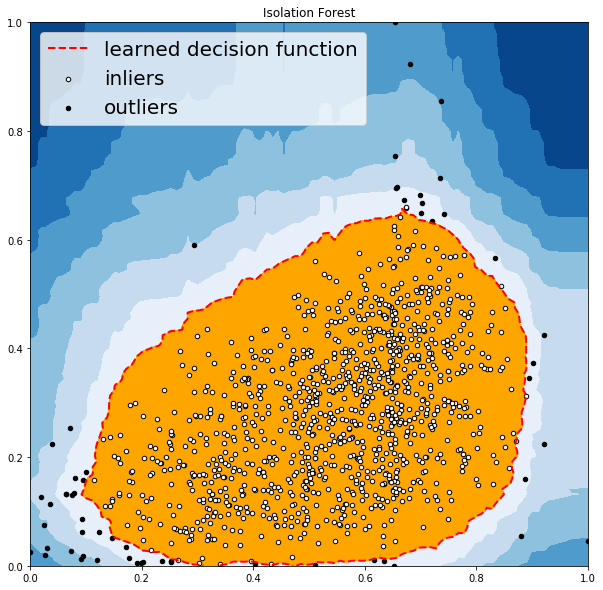

OUTLIERS :  42 INLIERS :  1099 K Nearest Neighbors (KNN)


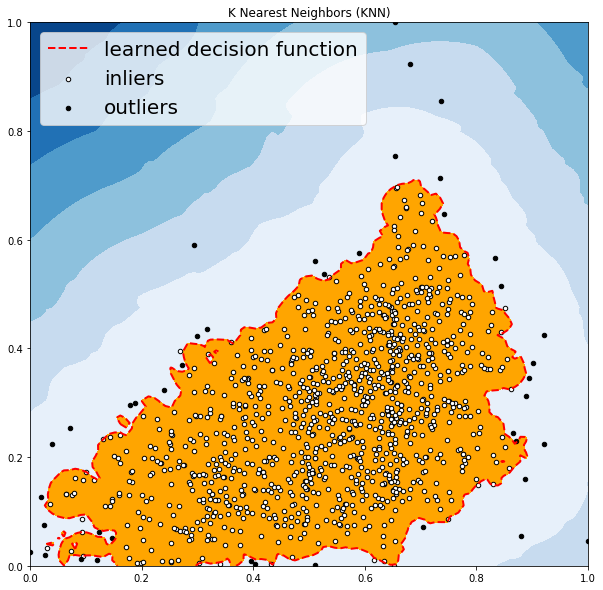

OUTLIERS :  25 INLIERS :  1116 Average KNN


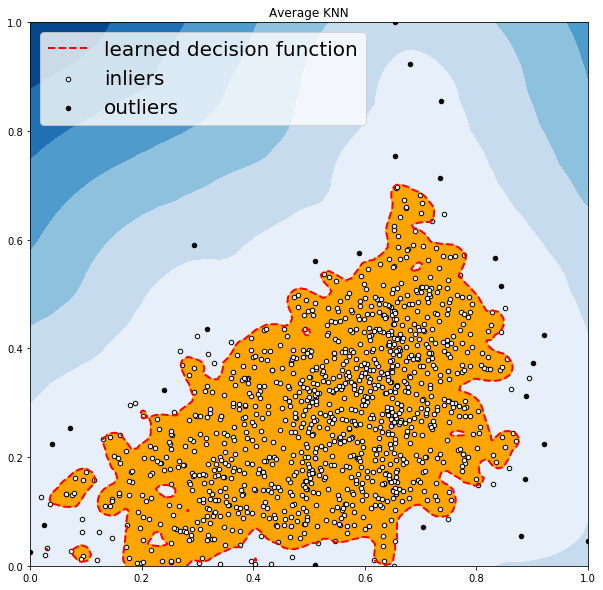



dataset abalone: abalone_benchmark_0870.csv
OUTLIERS :  59 INLIERS :  1087 Angle-based Outlier Detector (ABOD)


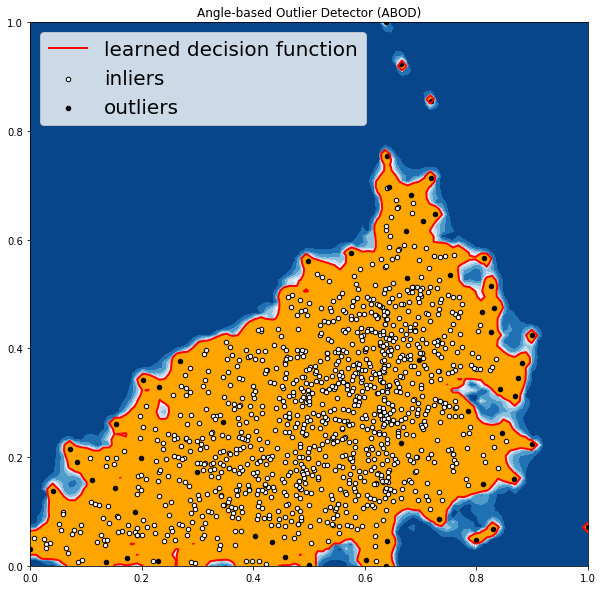

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


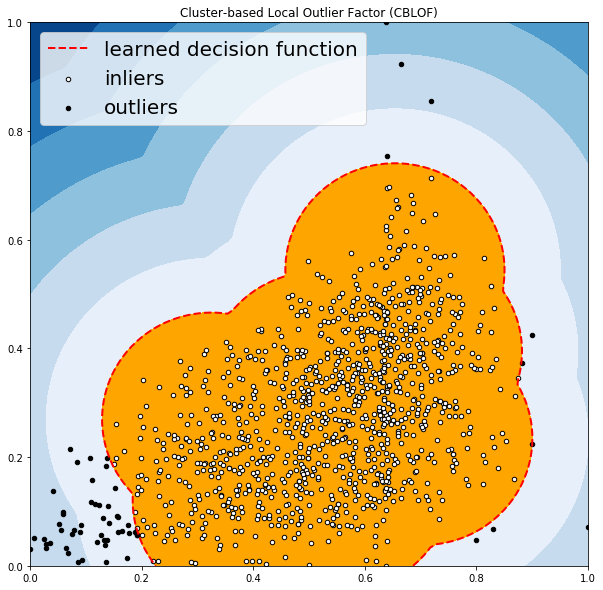

OUTLIERS :  53 INLIERS :  1093 Feature Bagging


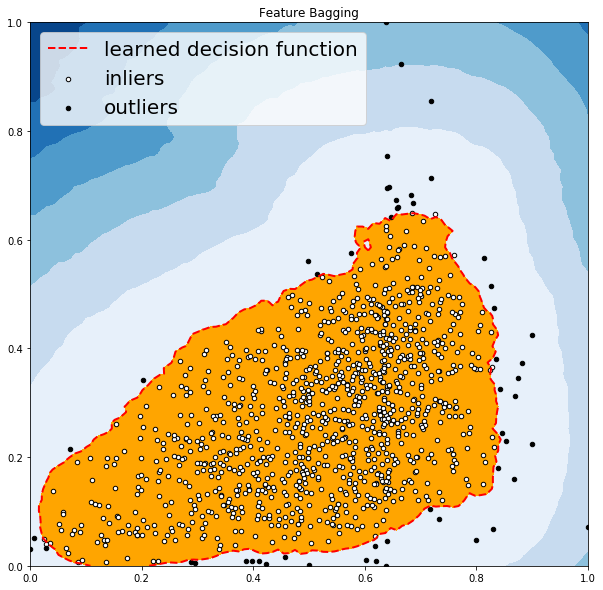

OUTLIERS :  56 INLIERS :  1090 Histogram-base Outlier Detection (HBOS)


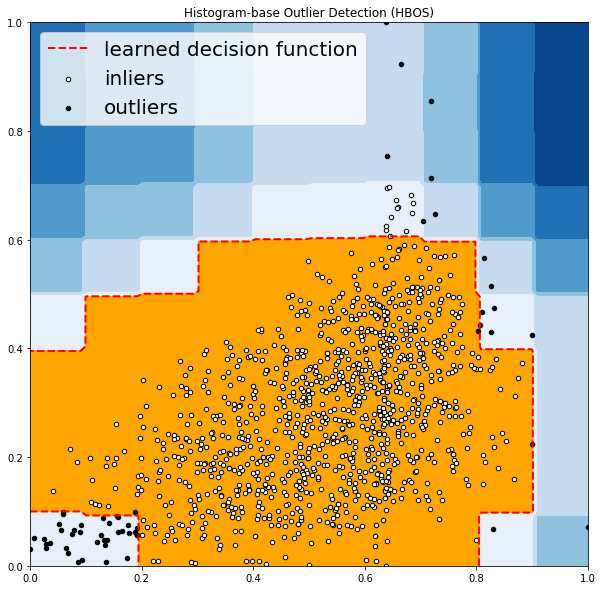

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


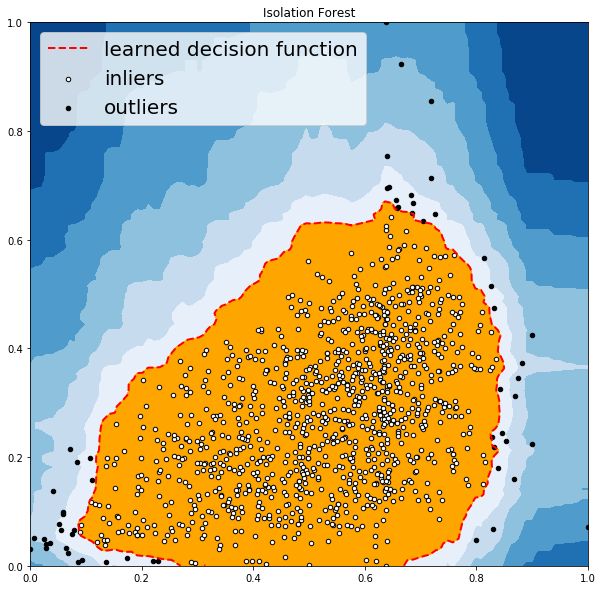

OUTLIERS :  43 INLIERS :  1103 K Nearest Neighbors (KNN)


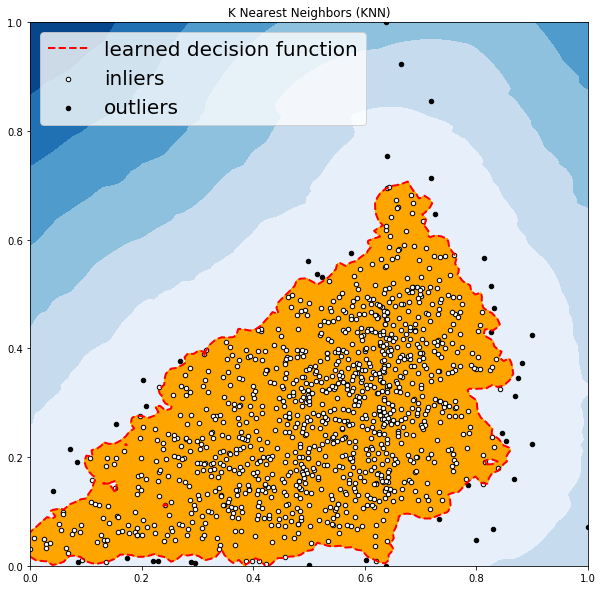

OUTLIERS :  24 INLIERS :  1122 Average KNN


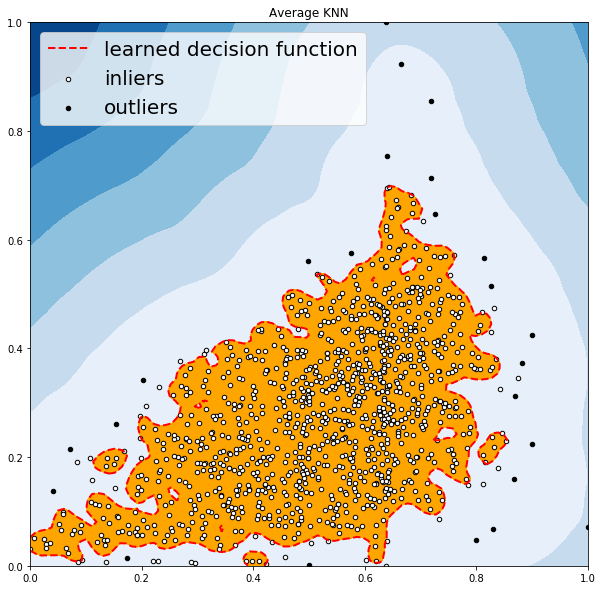



dataset abalone: abalone_benchmark_0858.csv
OUTLIERS :  59 INLIERS :  1082 Angle-based Outlier Detector (ABOD)


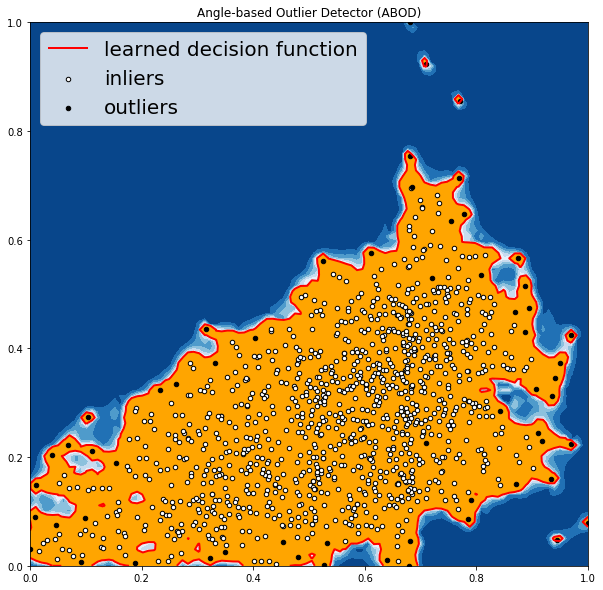

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


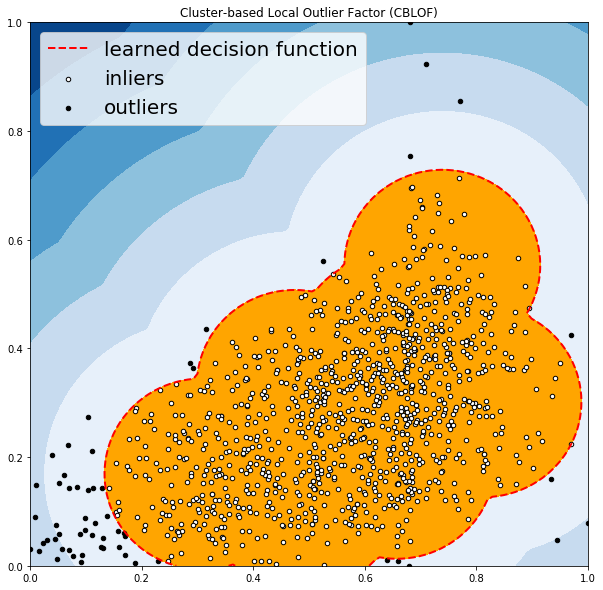

OUTLIERS :  48 INLIERS :  1093 Feature Bagging


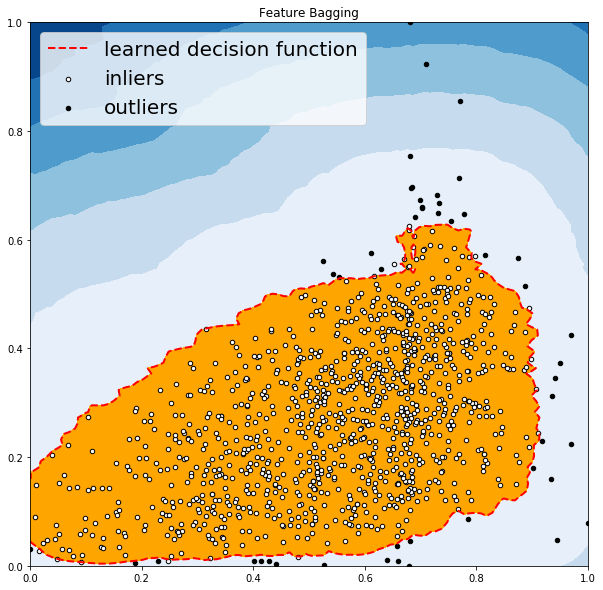

OUTLIERS :  44 INLIERS :  1097 Histogram-base Outlier Detection (HBOS)


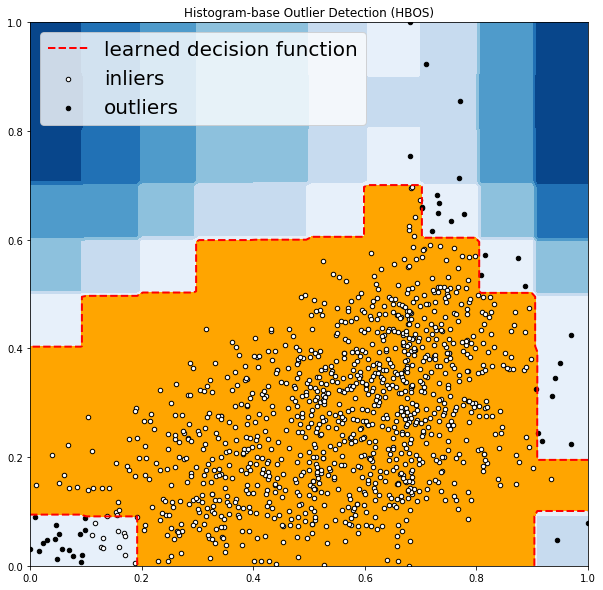

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


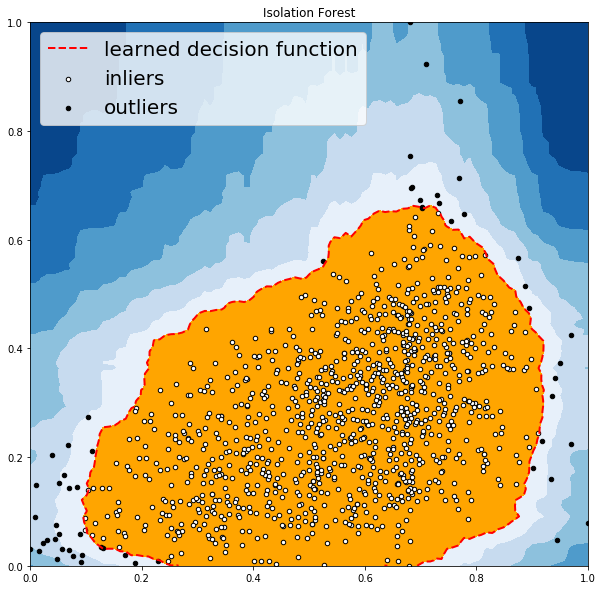

OUTLIERS :  38 INLIERS :  1103 K Nearest Neighbors (KNN)


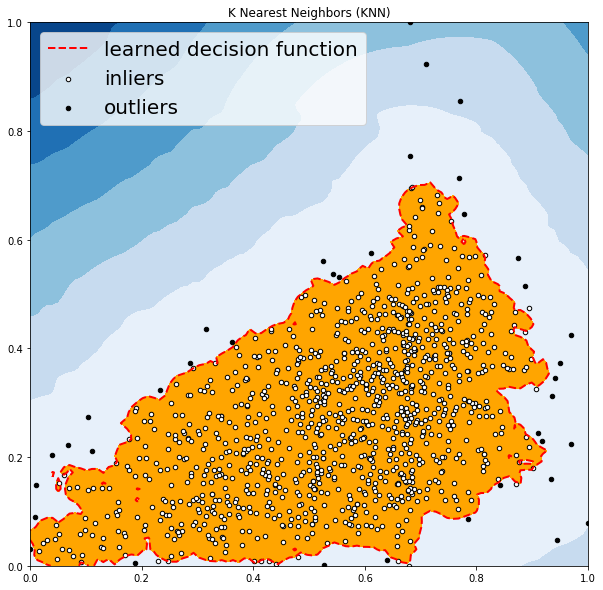

OUTLIERS :  25 INLIERS :  1116 Average KNN


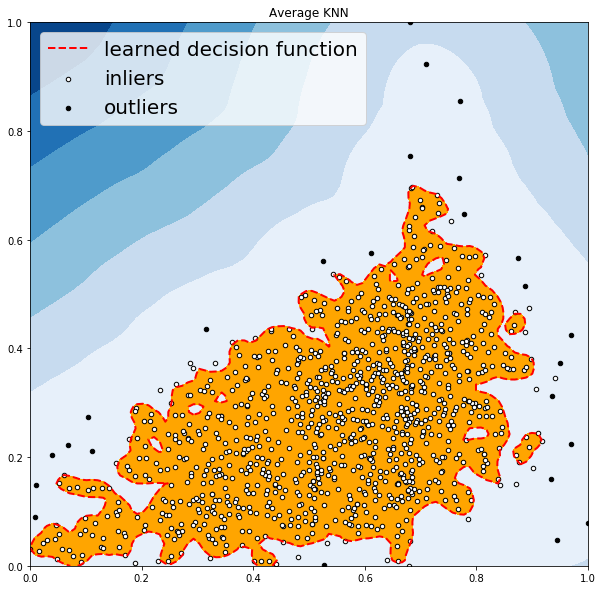



dataset abalone: abalone_benchmark_0680.csv
OUTLIERS :  43 INLIERS :  860 Angle-based Outlier Detector (ABOD)


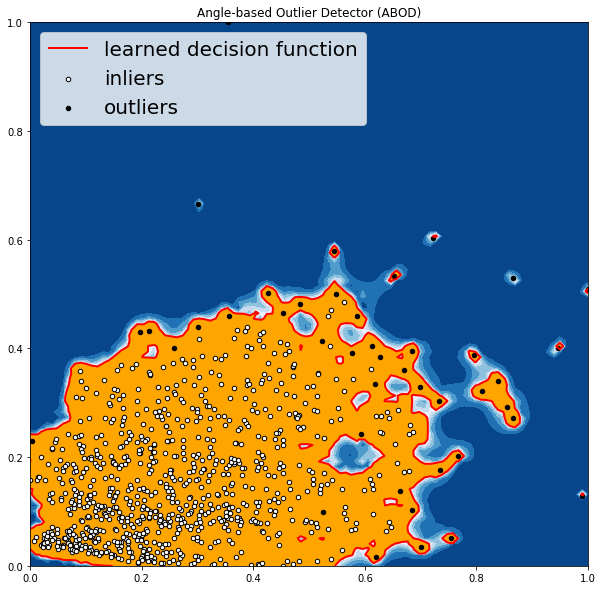

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


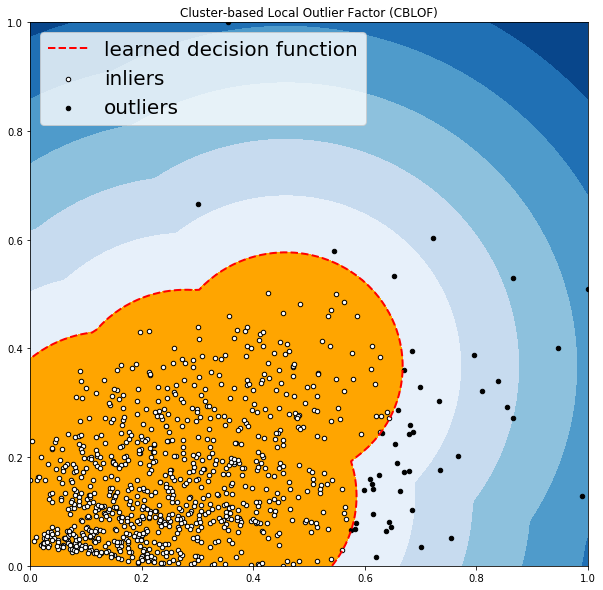

OUTLIERS :  43 INLIERS :  860 Feature Bagging


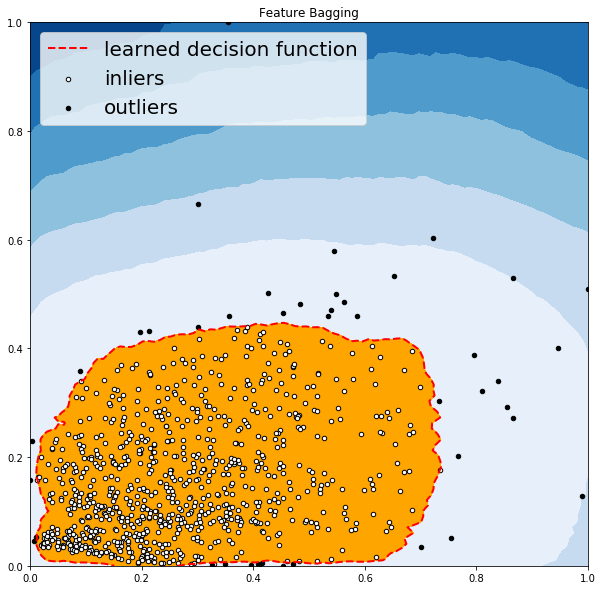

OUTLIERS :  42 INLIERS :  861 Histogram-base Outlier Detection (HBOS)


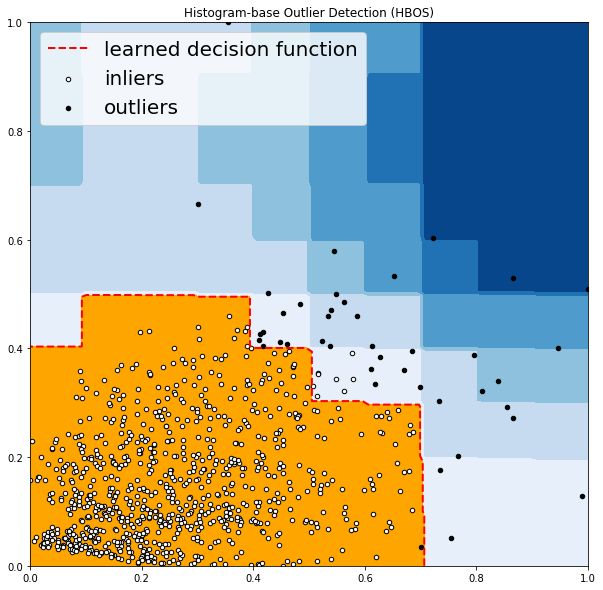

OUTLIERS :  46 INLIERS :  857 Isolation Forest


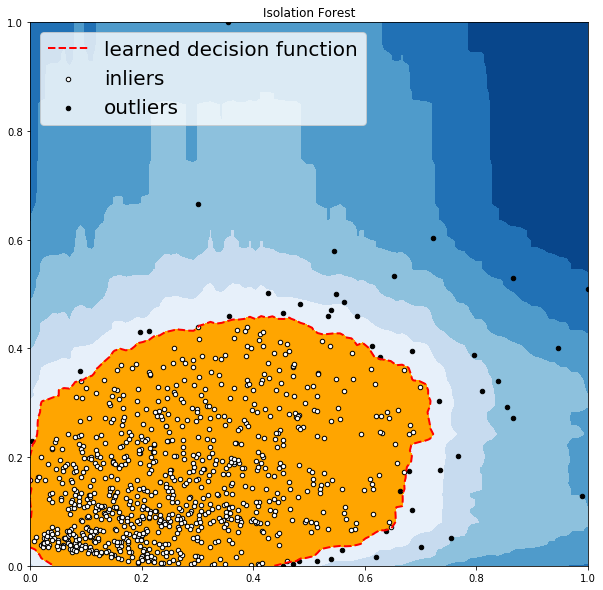

OUTLIERS :  38 INLIERS :  865 K Nearest Neighbors (KNN)


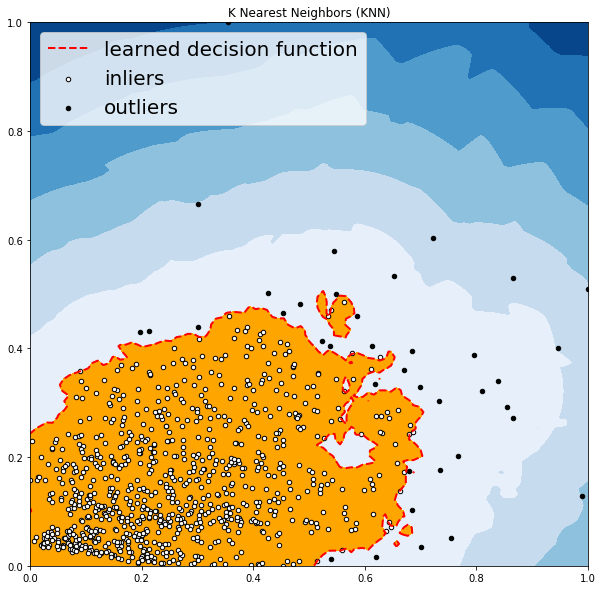

OUTLIERS :  27 INLIERS :  876 Average KNN


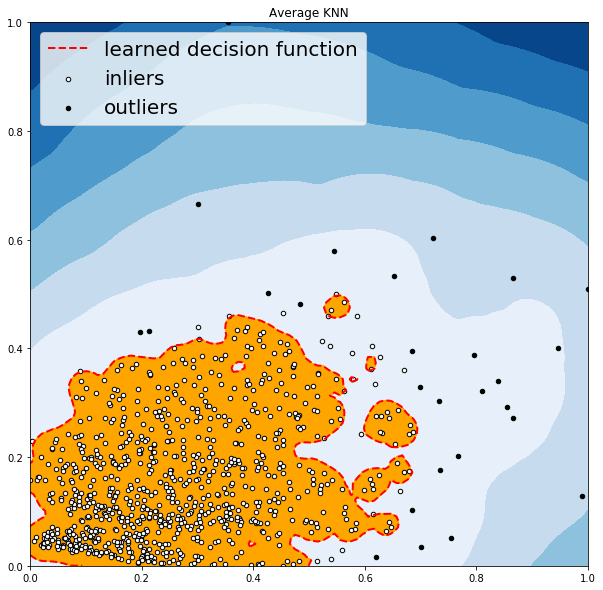



dataset abalone: abalone_benchmark_0694.csv
OUTLIERS :  45 INLIERS :  848 Angle-based Outlier Detector (ABOD)


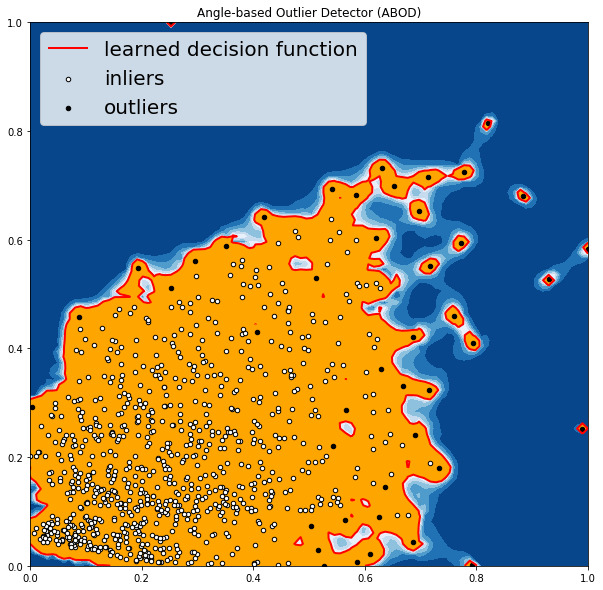

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


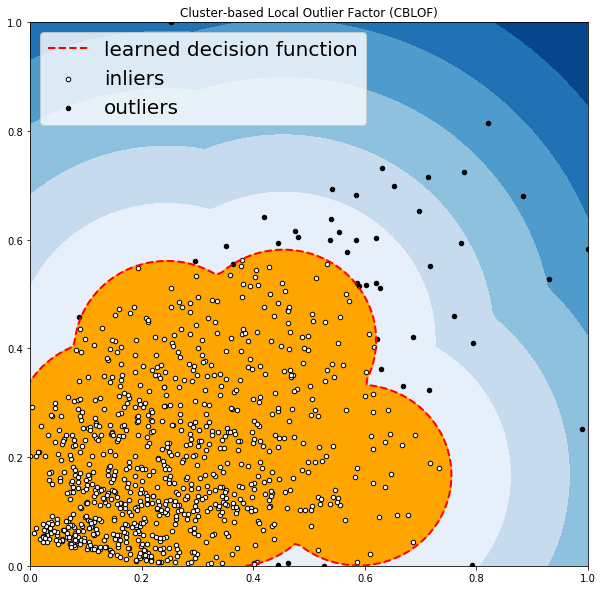

OUTLIERS :  42 INLIERS :  851 Feature Bagging


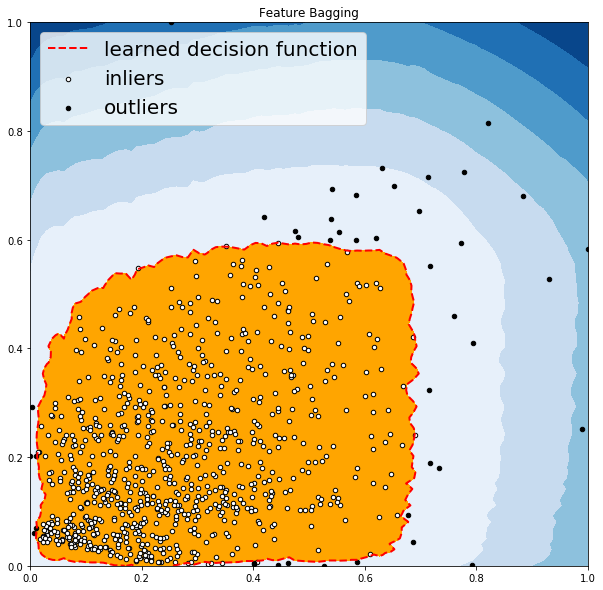

OUTLIERS :  43 INLIERS :  850 Histogram-base Outlier Detection (HBOS)


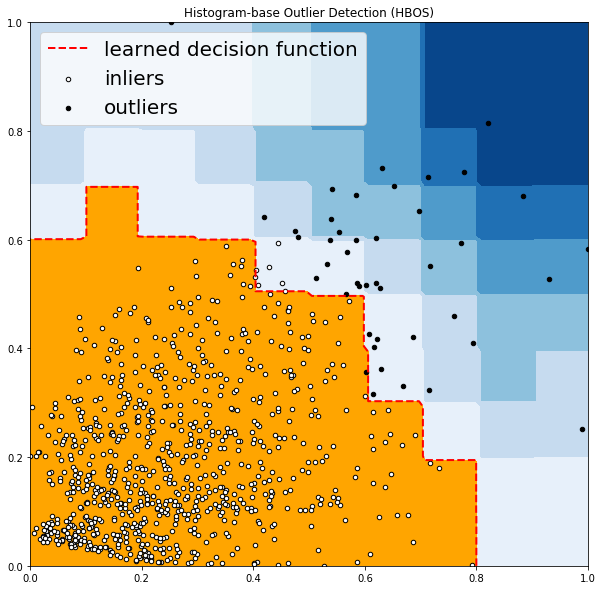

OUTLIERS :  45 INLIERS :  848 Isolation Forest


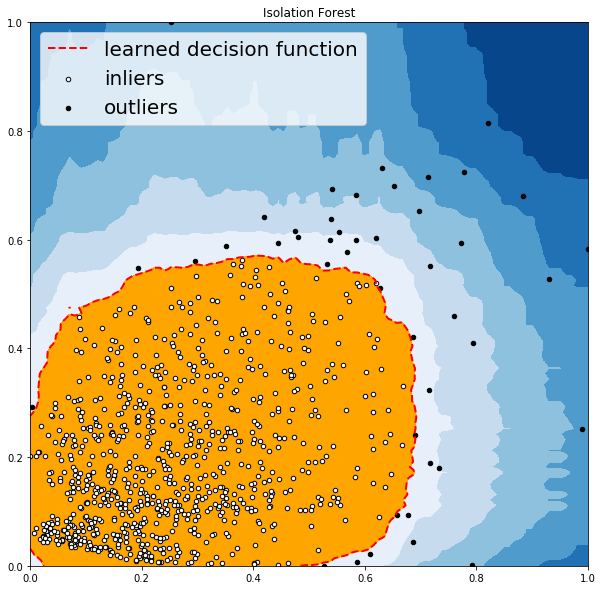

OUTLIERS :  36 INLIERS :  857 K Nearest Neighbors (KNN)


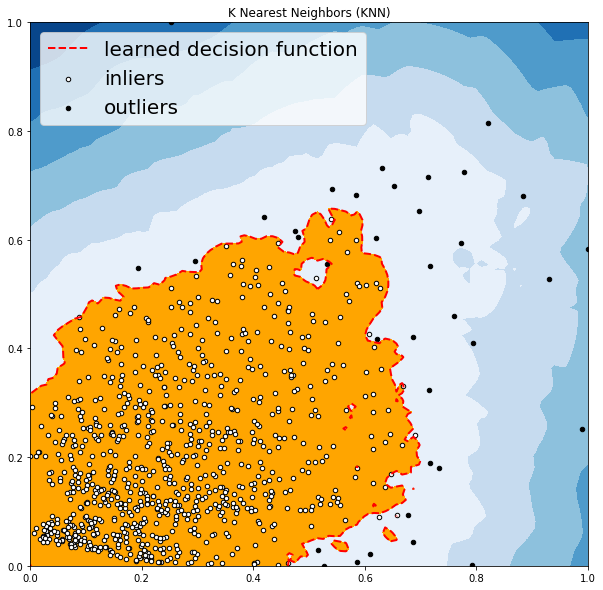

OUTLIERS :  27 INLIERS :  866 Average KNN


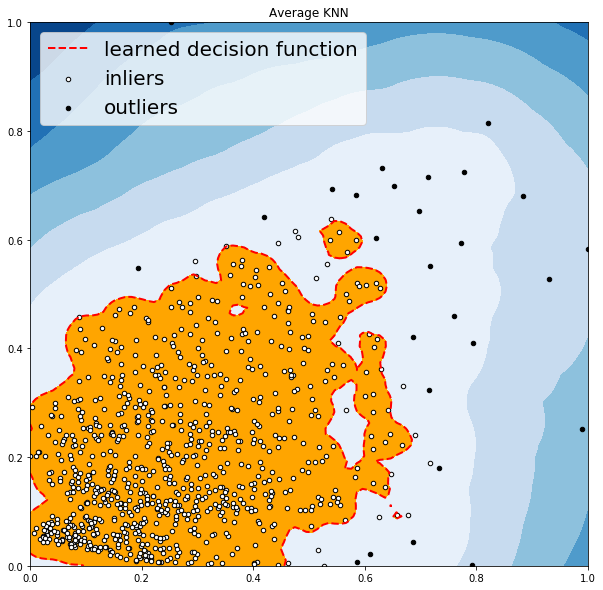

In [9]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[5]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)
    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1

        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))
        dfx = dataset
        dfx['outlier'] = y_pred.tolist()

        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)
        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)
        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)
        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')

        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')

        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')

        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数

### 3.6 diff.score, V6



dataset abalone: abalone_benchmark_0864.csv
OUTLIERS :  59 INLIERS :  1082 Angle-based Outlier Detector (ABOD)


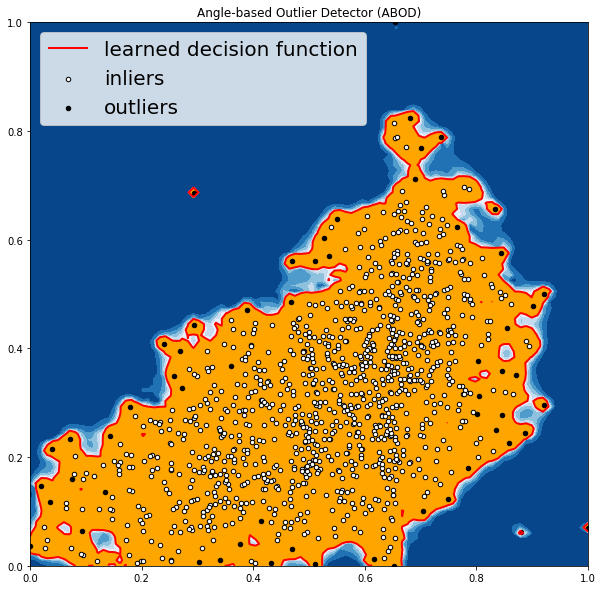

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


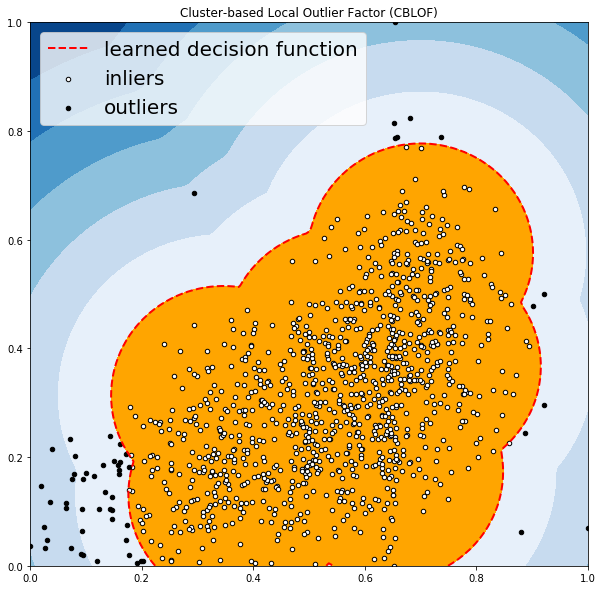

OUTLIERS :  45 INLIERS :  1096 Feature Bagging


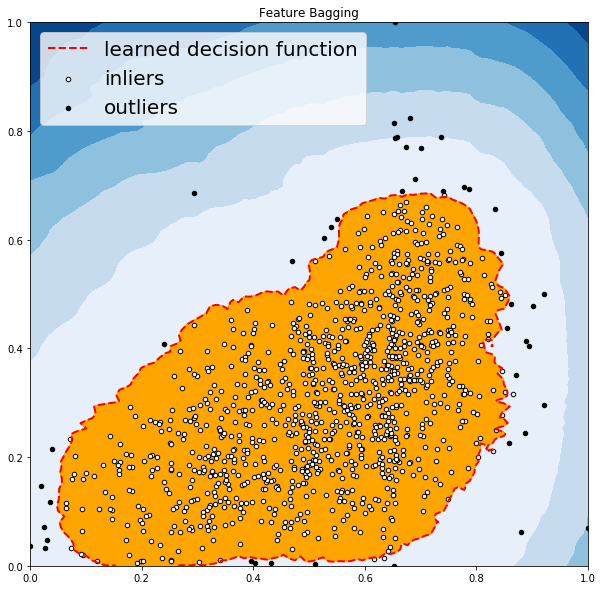

OUTLIERS :  49 INLIERS :  1092 Histogram-base Outlier Detection (HBOS)


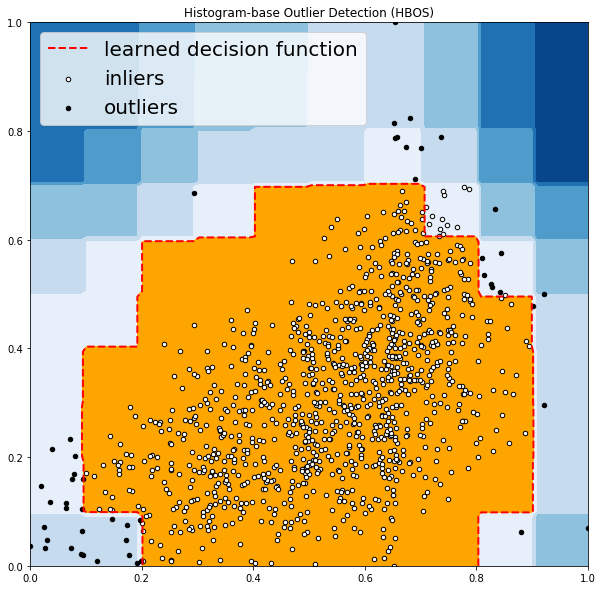

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


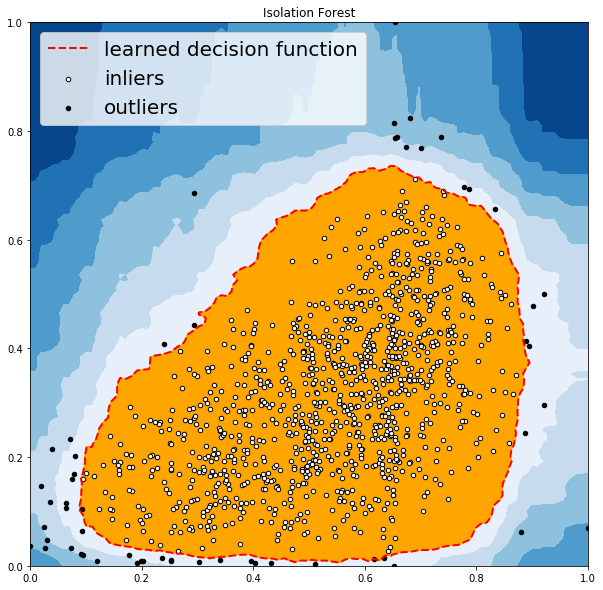

OUTLIERS :  37 INLIERS :  1104 K Nearest Neighbors (KNN)


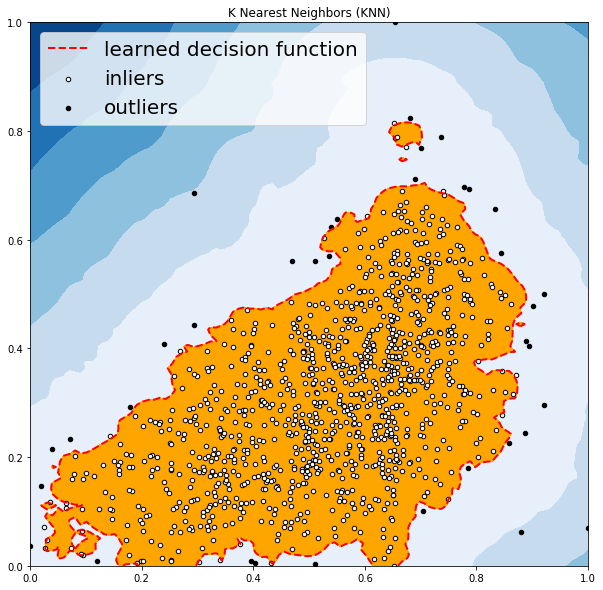

OUTLIERS :  19 INLIERS :  1122 Average KNN


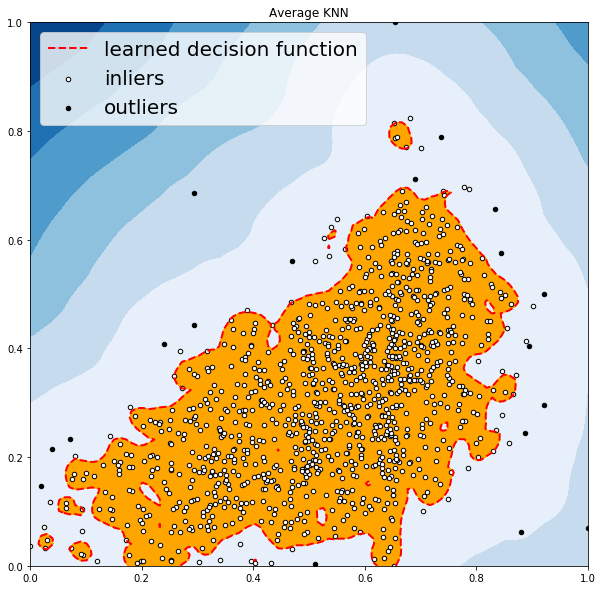



dataset abalone: abalone_benchmark_0870.csv
OUTLIERS :  58 INLIERS :  1088 Angle-based Outlier Detector (ABOD)


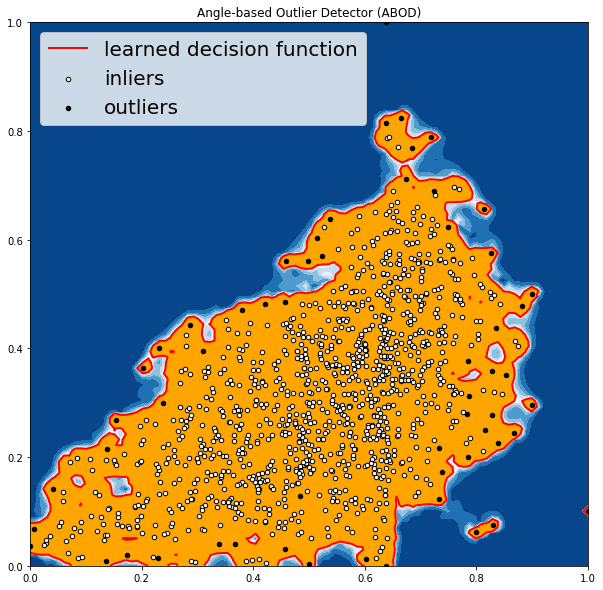

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


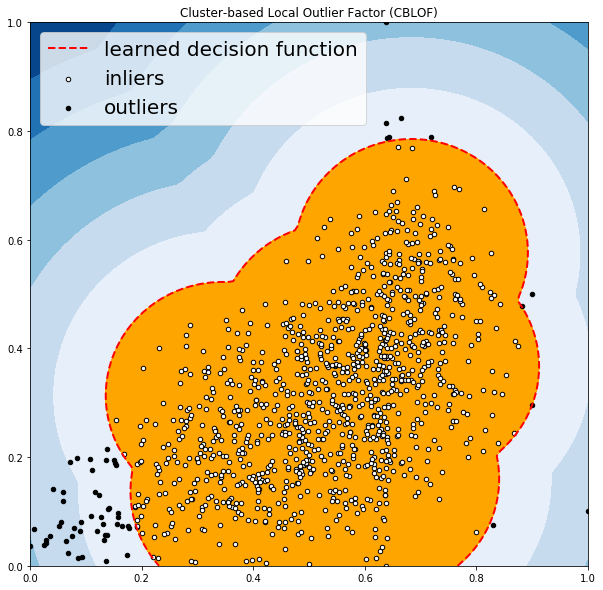

OUTLIERS :  56 INLIERS :  1090 Feature Bagging


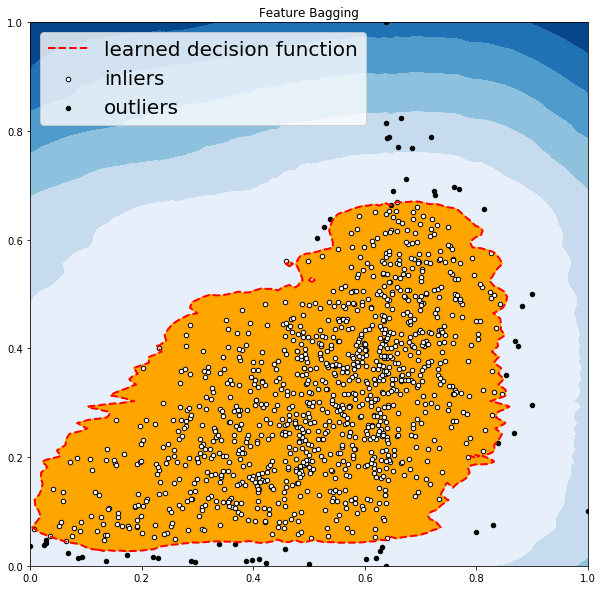

OUTLIERS :  53 INLIERS :  1093 Histogram-base Outlier Detection (HBOS)


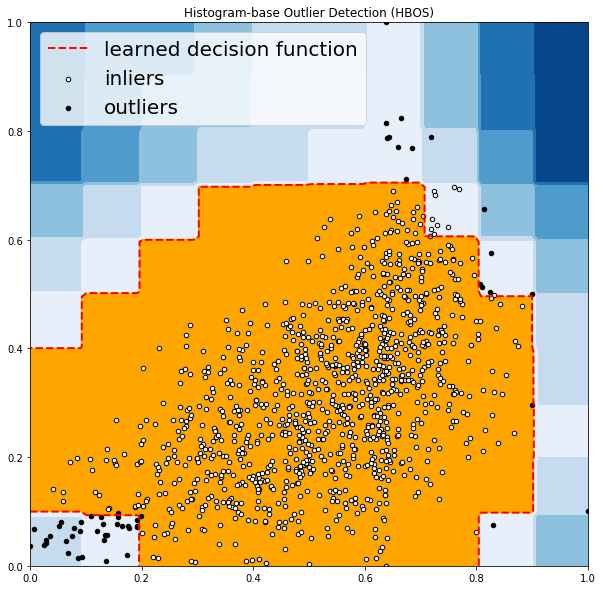

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


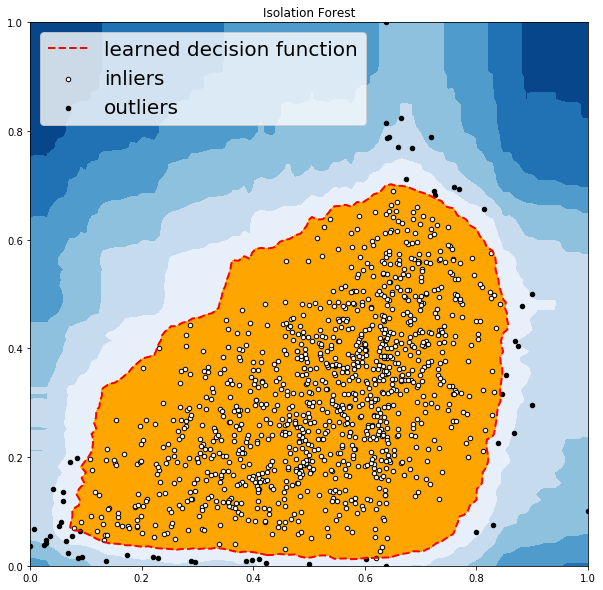

OUTLIERS :  43 INLIERS :  1103 K Nearest Neighbors (KNN)


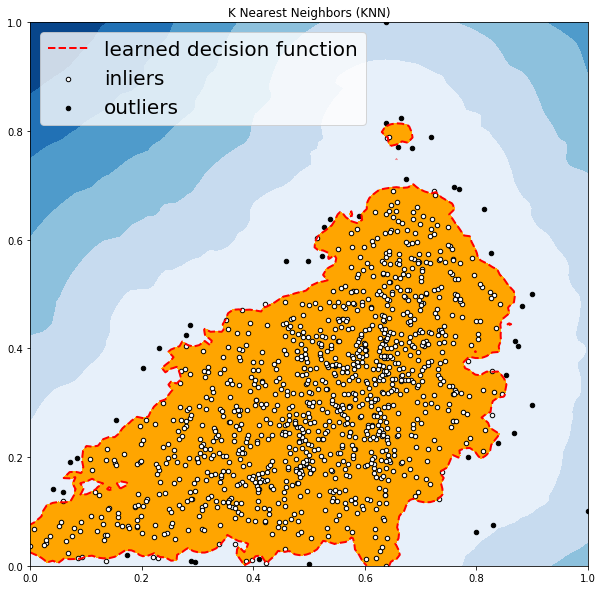

OUTLIERS :  18 INLIERS :  1128 Average KNN


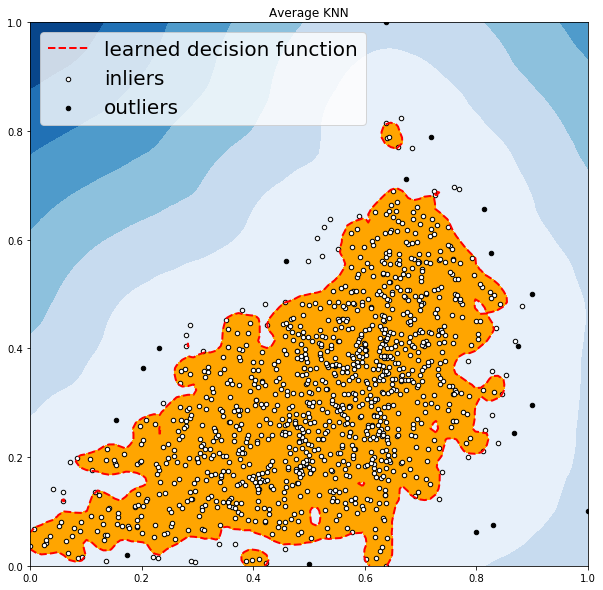



dataset abalone: abalone_benchmark_0858.csv
OUTLIERS :  64 INLIERS :  1077 Angle-based Outlier Detector (ABOD)


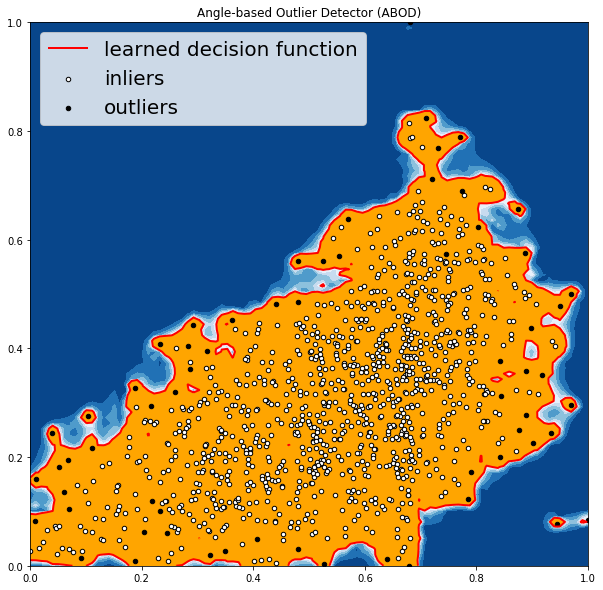

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


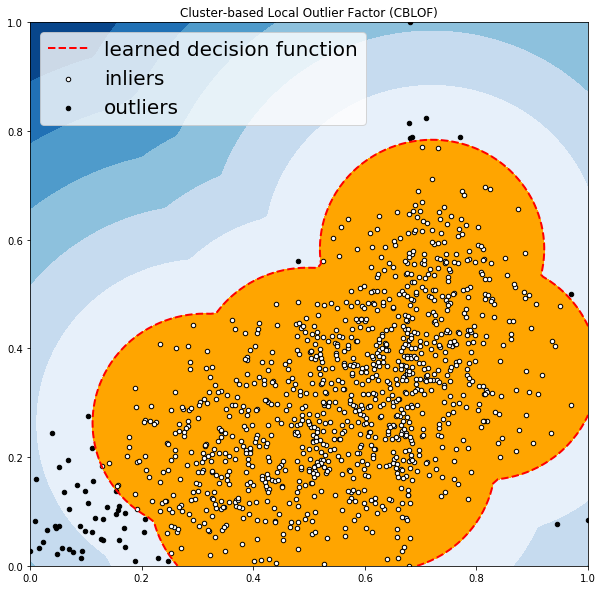

OUTLIERS :  50 INLIERS :  1091 Feature Bagging


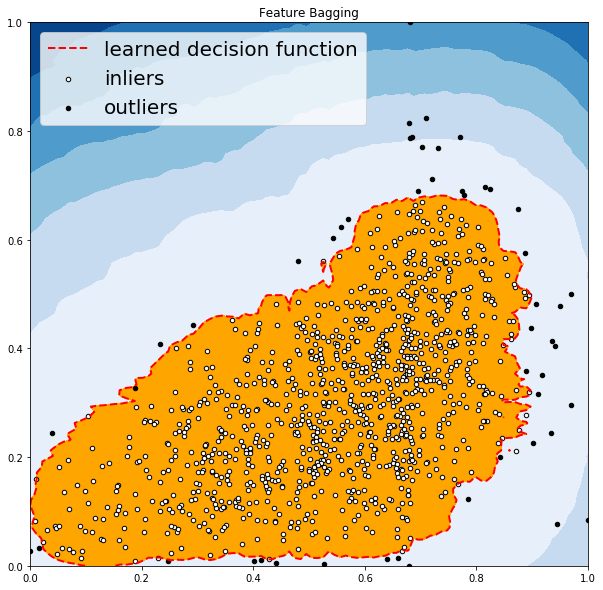

OUTLIERS :  52 INLIERS :  1089 Histogram-base Outlier Detection (HBOS)


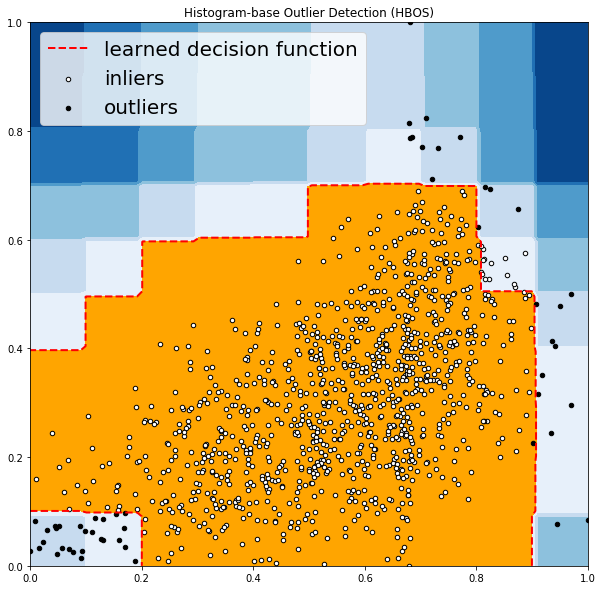

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


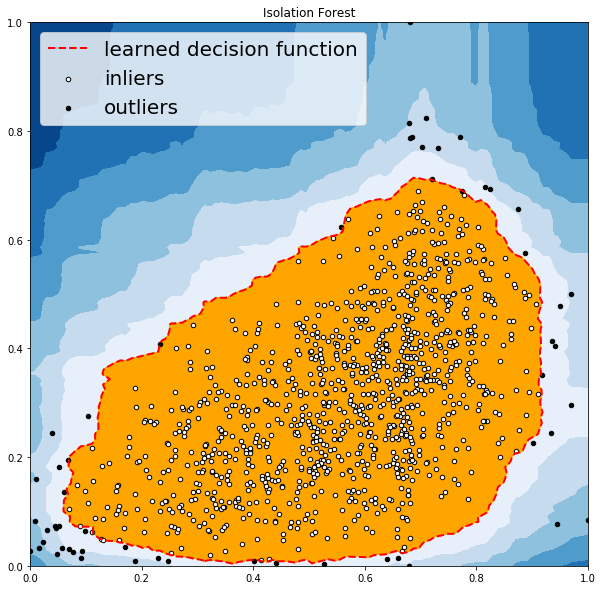

OUTLIERS :  47 INLIERS :  1094 K Nearest Neighbors (KNN)


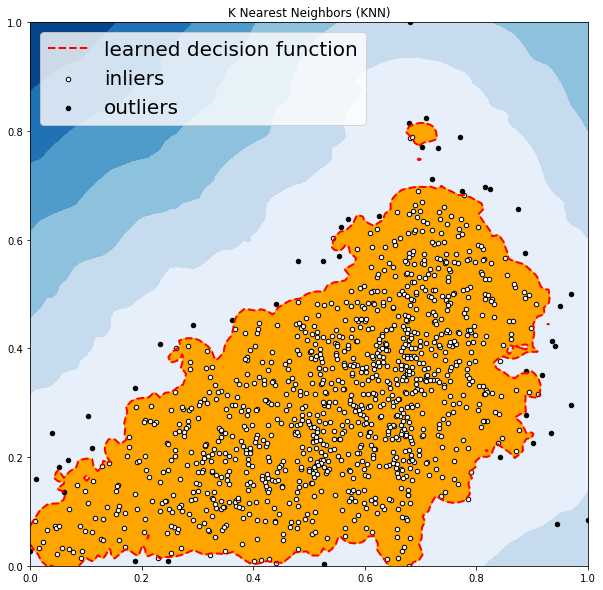

OUTLIERS :  20 INLIERS :  1121 Average KNN


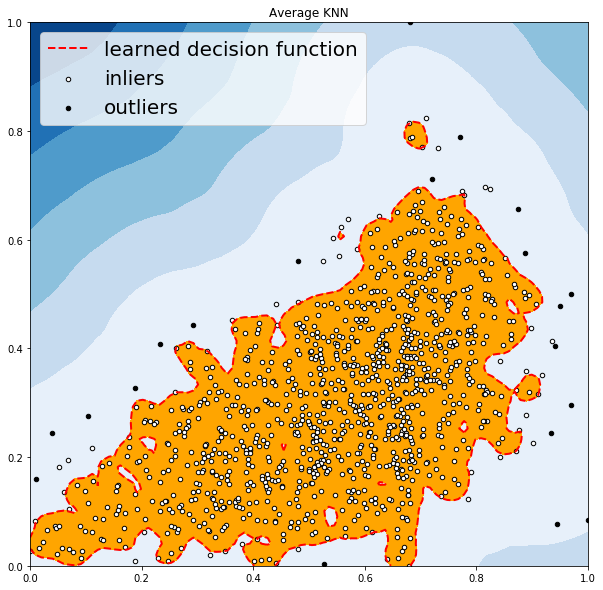



dataset abalone: abalone_benchmark_0680.csv
OUTLIERS :  44 INLIERS :  859 Angle-based Outlier Detector (ABOD)


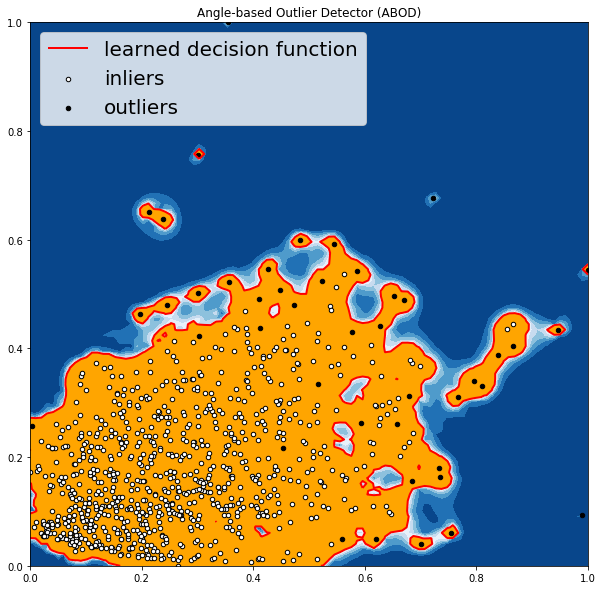

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


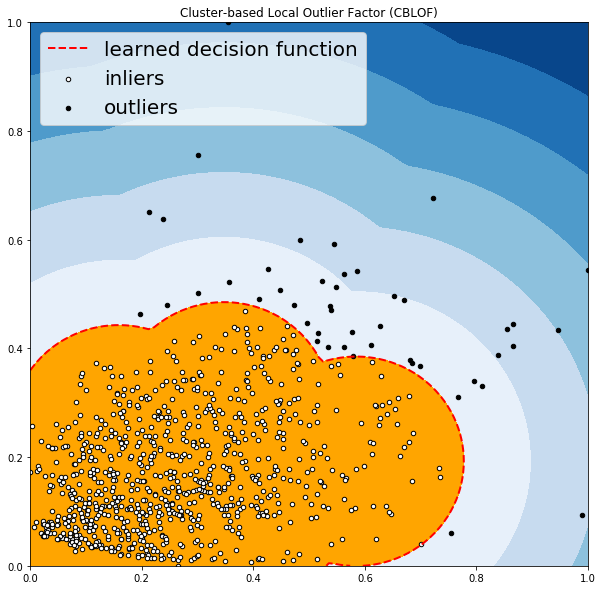

OUTLIERS :  43 INLIERS :  860 Feature Bagging


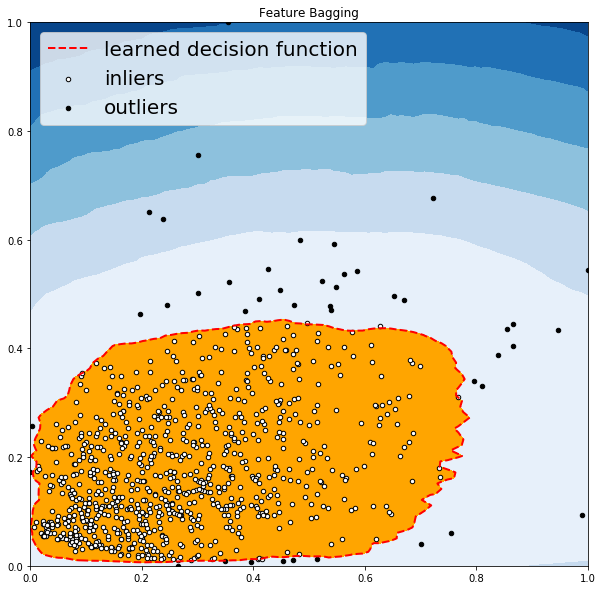

OUTLIERS :  40 INLIERS :  863 Histogram-base Outlier Detection (HBOS)


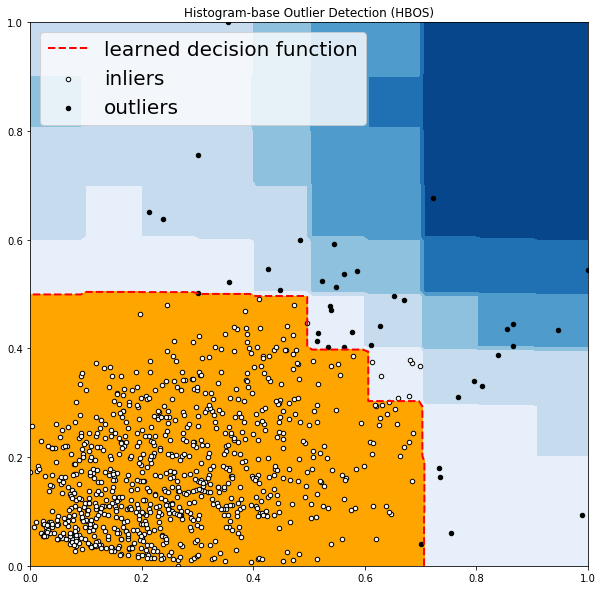

OUTLIERS :  46 INLIERS :  857 Isolation Forest


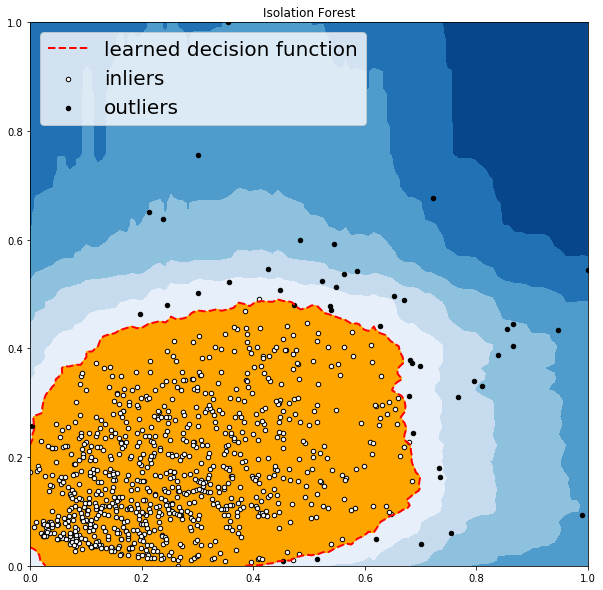

OUTLIERS :  37 INLIERS :  866 K Nearest Neighbors (KNN)


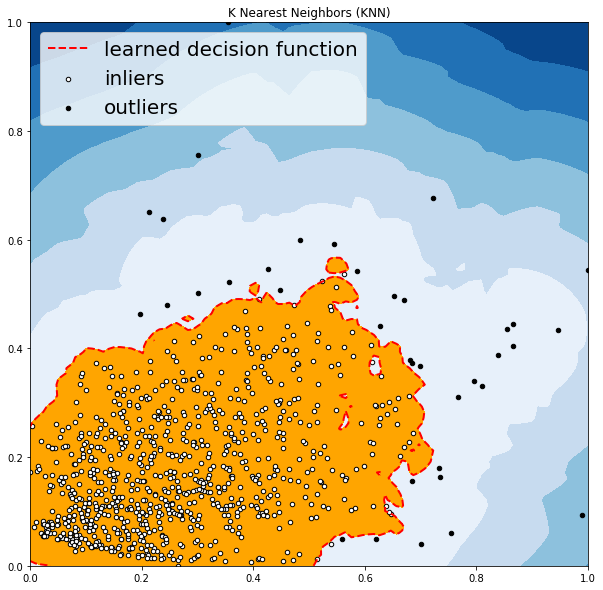

OUTLIERS :  26 INLIERS :  877 Average KNN


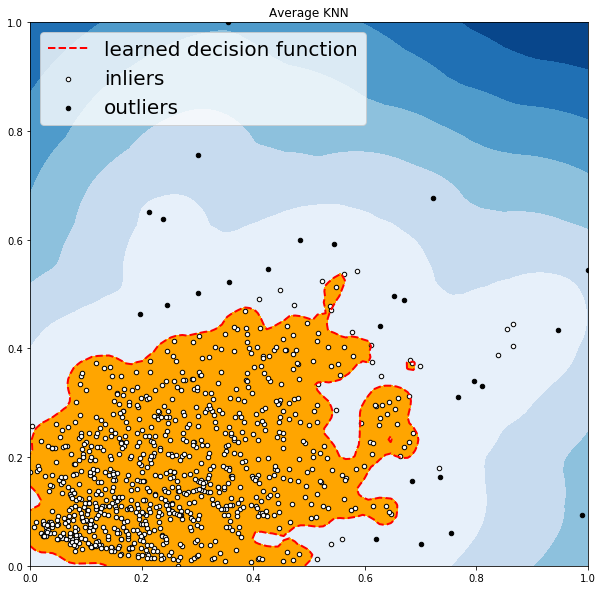



dataset abalone: abalone_benchmark_0694.csv
OUTLIERS :  40 INLIERS :  853 Angle-based Outlier Detector (ABOD)


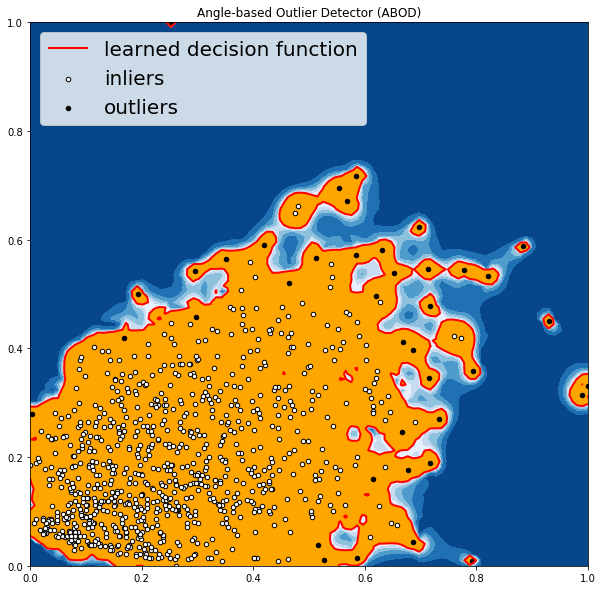

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


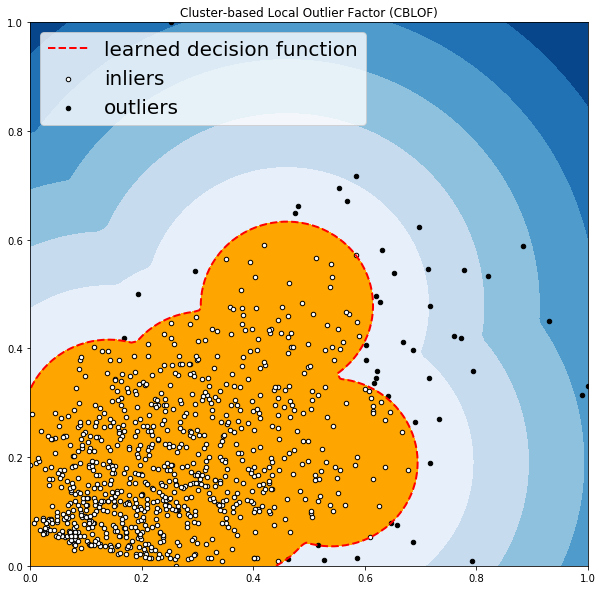

OUTLIERS :  42 INLIERS :  851 Feature Bagging


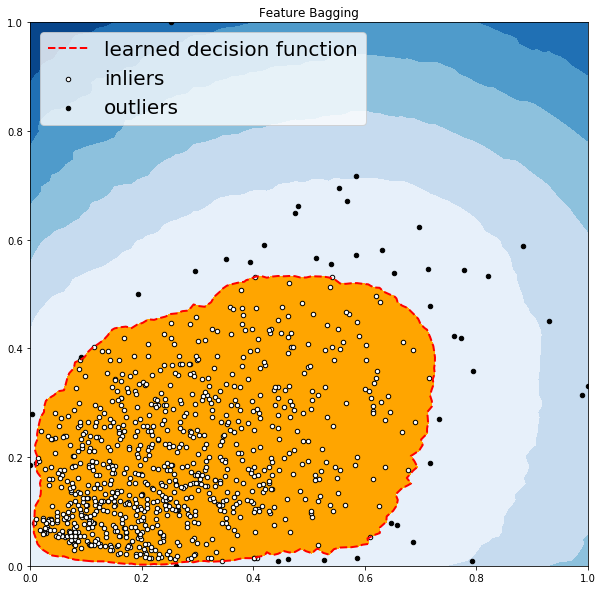

OUTLIERS :  43 INLIERS :  850 Histogram-base Outlier Detection (HBOS)


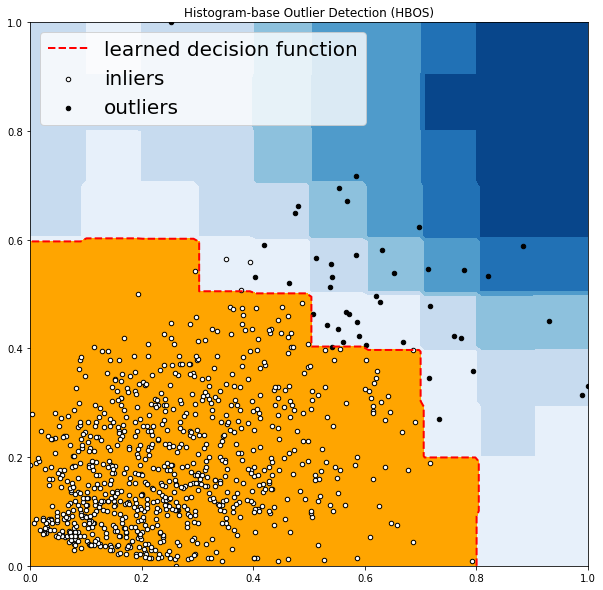

OUTLIERS :  45 INLIERS :  848 Isolation Forest


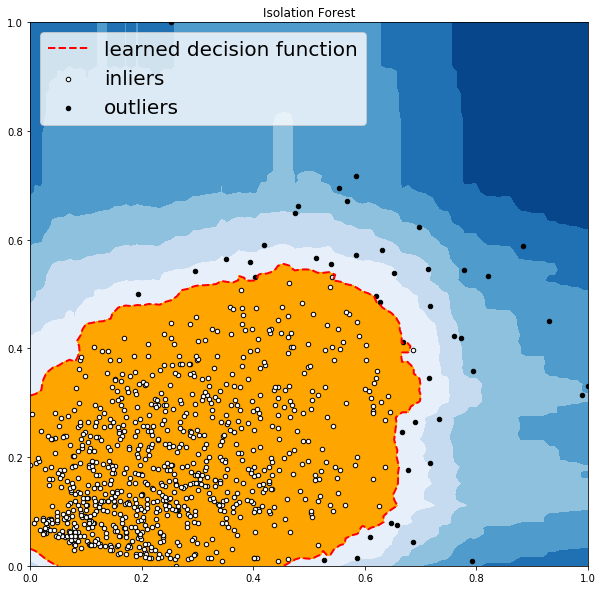

OUTLIERS :  34 INLIERS :  859 K Nearest Neighbors (KNN)


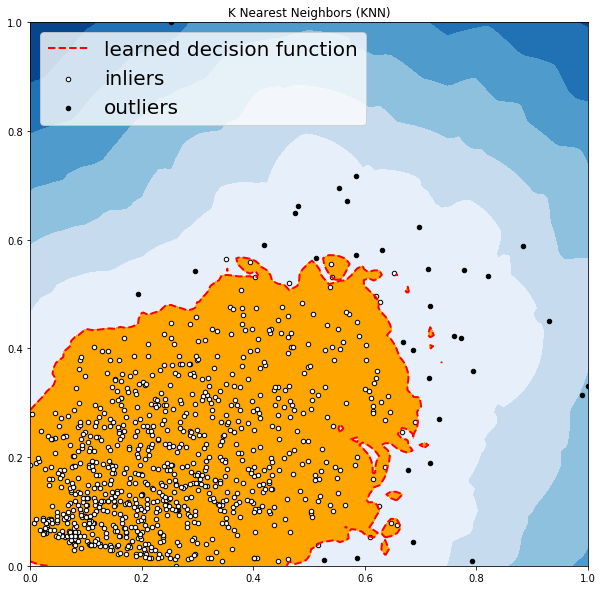

OUTLIERS :  26 INLIERS :  867 Average KNN


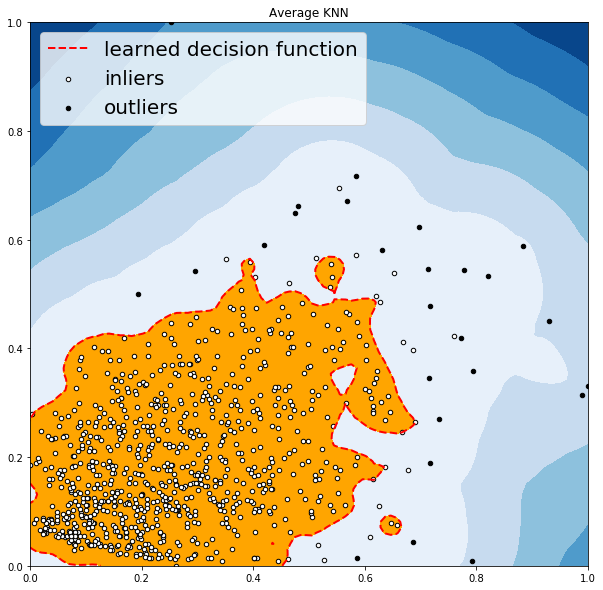

In [10]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[6]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)
    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1
        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))

        dfx = dataset
        dfx['outlier'] = y_pred.tolist()
        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)
        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)
        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)
        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')

        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')

        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')

        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数

### 3.7 diff.score, V7



dataset abalone: abalone_benchmark_0864.csv
OUTLIERS :  52 INLIERS :  1089 Angle-based Outlier Detector (ABOD)


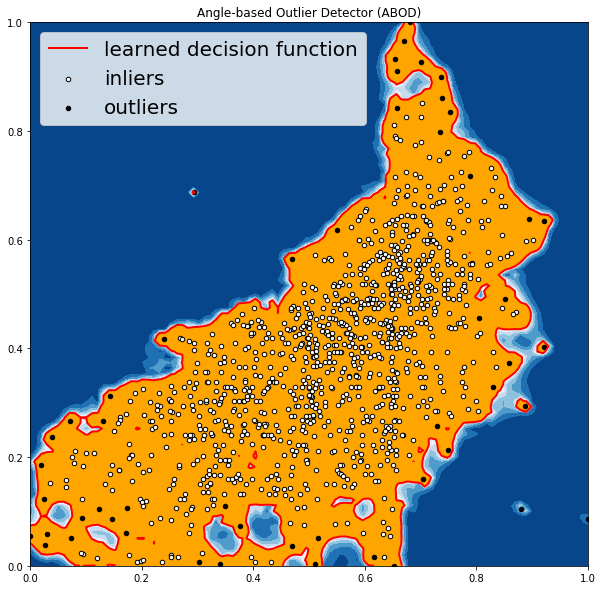

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


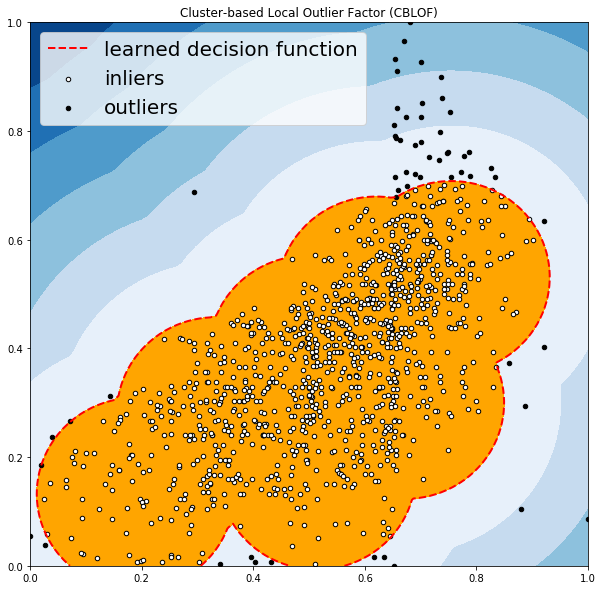

OUTLIERS :  50 INLIERS :  1091 Feature Bagging


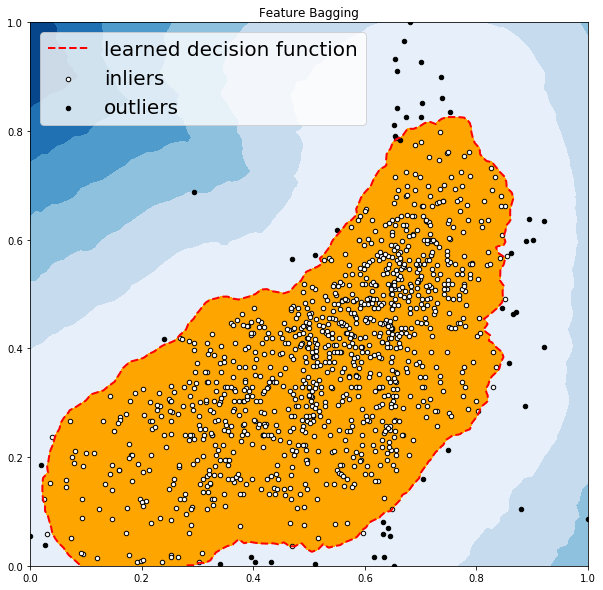

OUTLIERS :  47 INLIERS :  1094 Histogram-base Outlier Detection (HBOS)


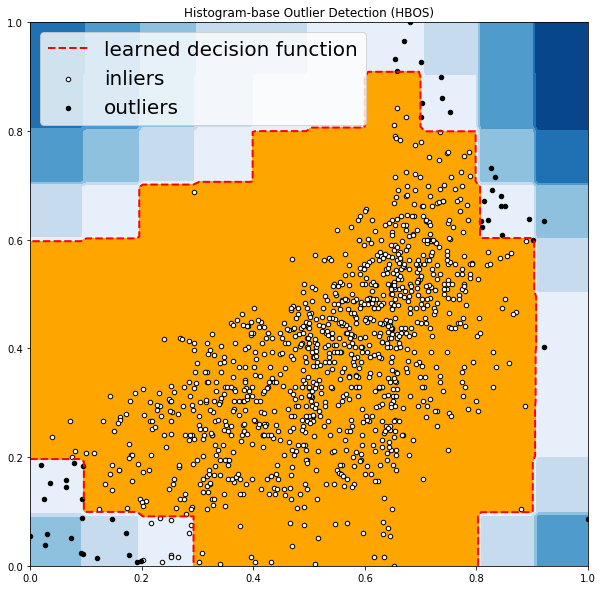

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


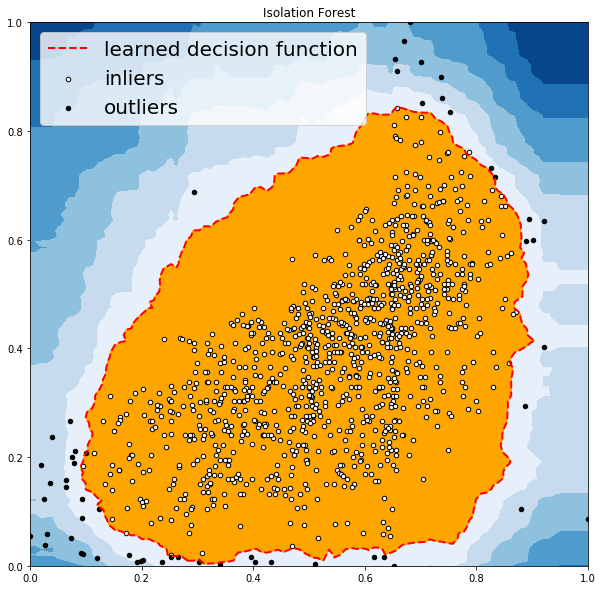

OUTLIERS :  40 INLIERS :  1101 K Nearest Neighbors (KNN)


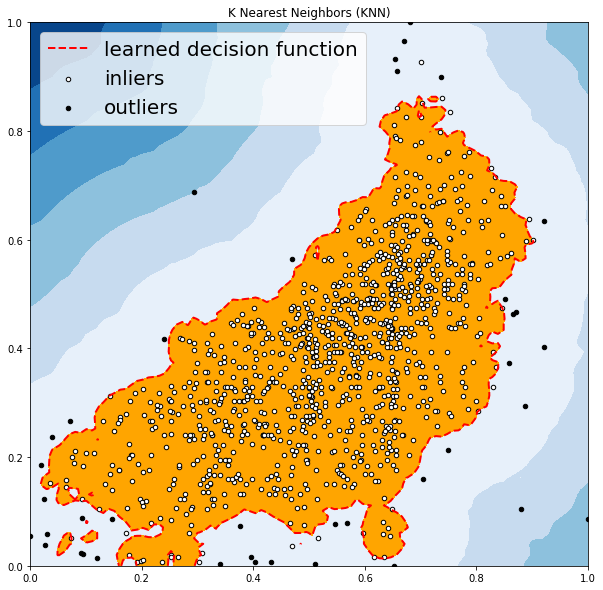

OUTLIERS :  16 INLIERS :  1125 Average KNN


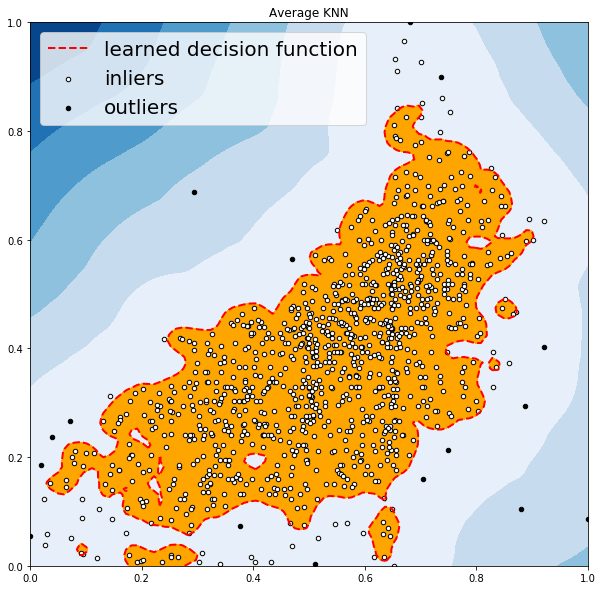



dataset abalone: abalone_benchmark_0870.csv
OUTLIERS :  61 INLIERS :  1085 Angle-based Outlier Detector (ABOD)


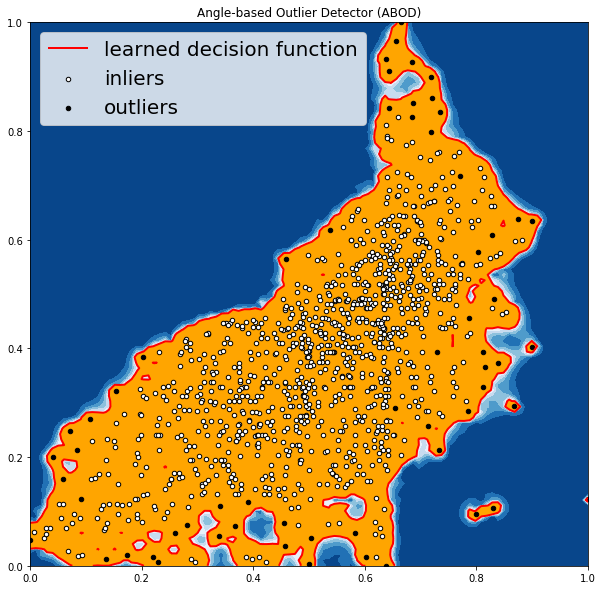

OUTLIERS :  58 INLIERS :  1088 Cluster-based Local Outlier Factor (CBLOF)


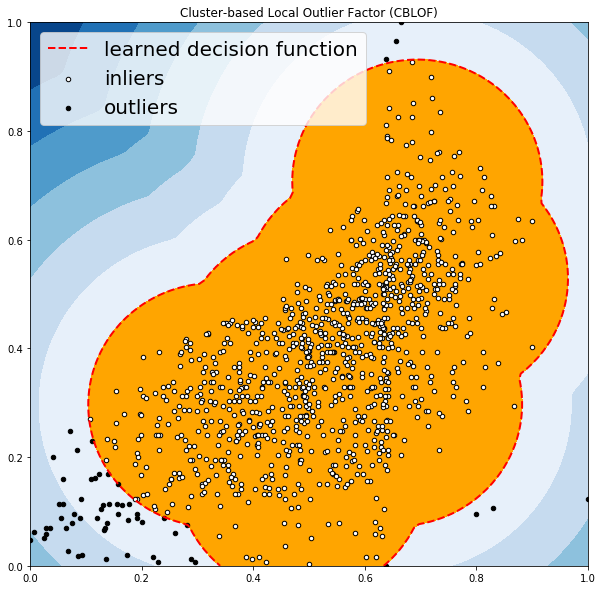

OUTLIERS :  53 INLIERS :  1093 Feature Bagging


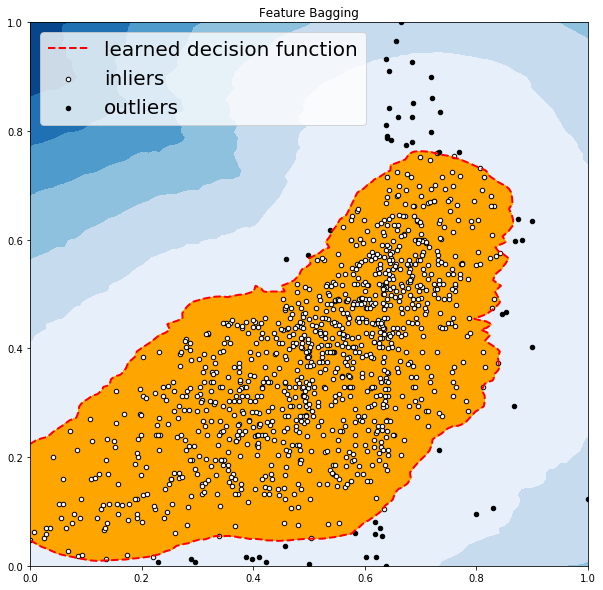

OUTLIERS :  58 INLIERS :  1088 Histogram-base Outlier Detection (HBOS)


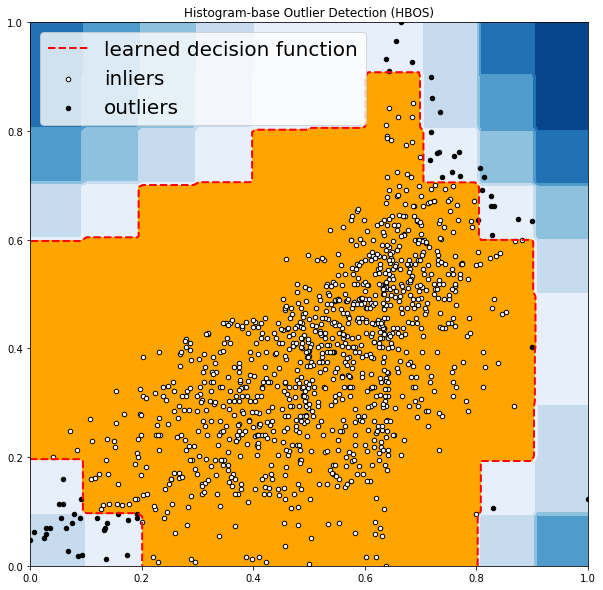

OUTLIERS :  58 INLIERS :  1088 Isolation Forest


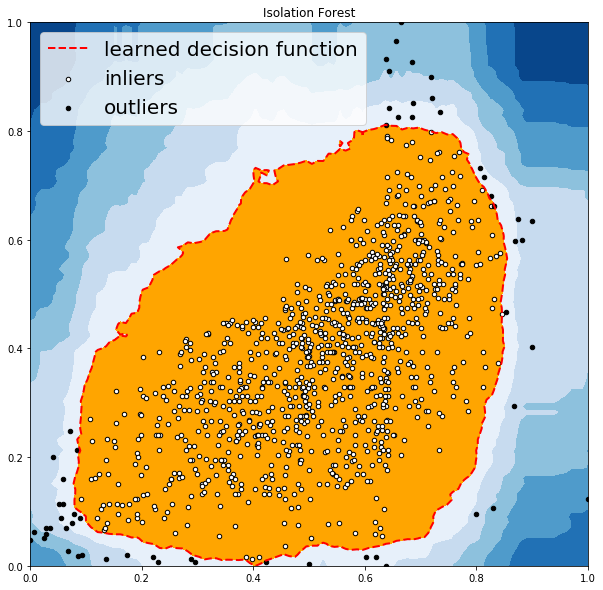

OUTLIERS :  42 INLIERS :  1104 K Nearest Neighbors (KNN)


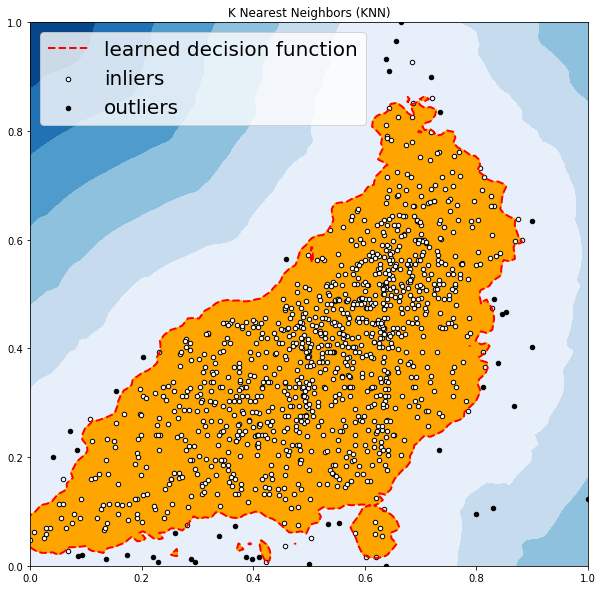

OUTLIERS :  16 INLIERS :  1130 Average KNN


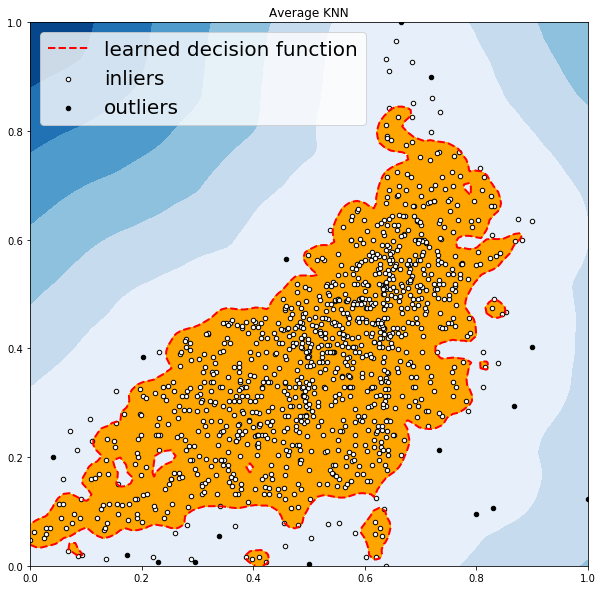



dataset abalone: abalone_benchmark_0858.csv
OUTLIERS :  60 INLIERS :  1081 Angle-based Outlier Detector (ABOD)


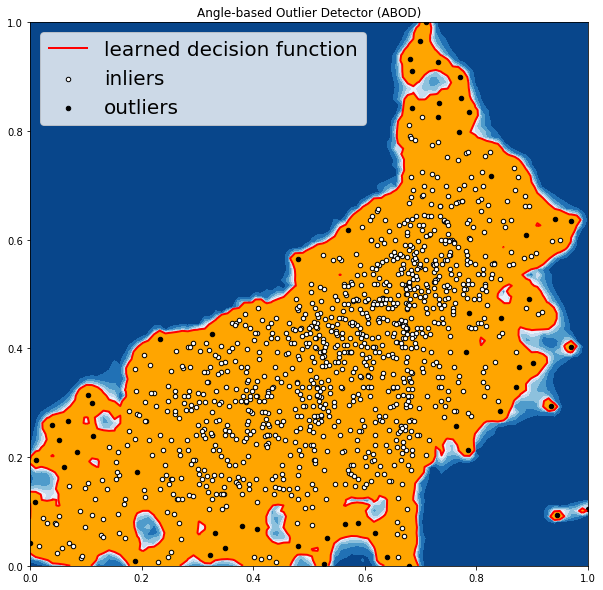

OUTLIERS :  57 INLIERS :  1084 Cluster-based Local Outlier Factor (CBLOF)


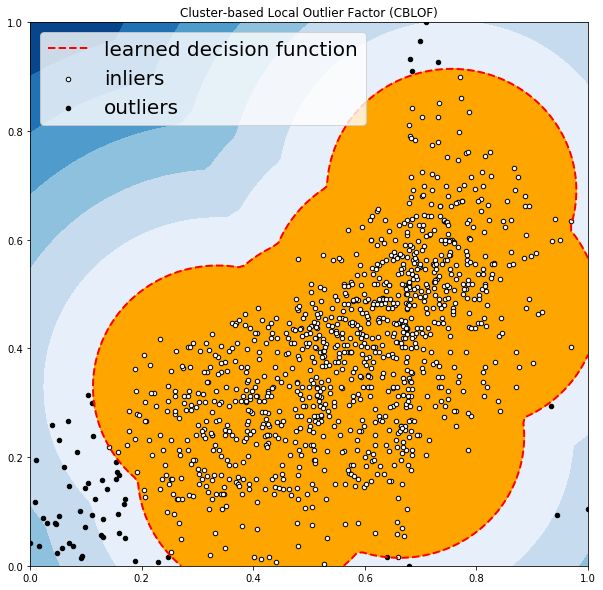

OUTLIERS :  51 INLIERS :  1090 Feature Bagging


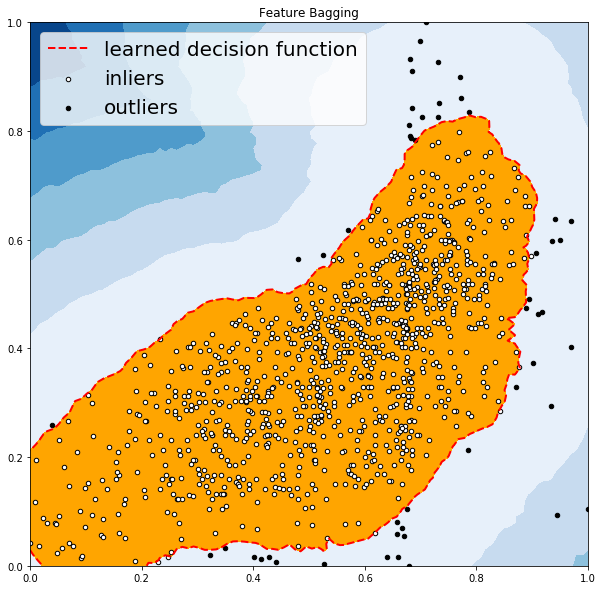

OUTLIERS :  53 INLIERS :  1088 Histogram-base Outlier Detection (HBOS)


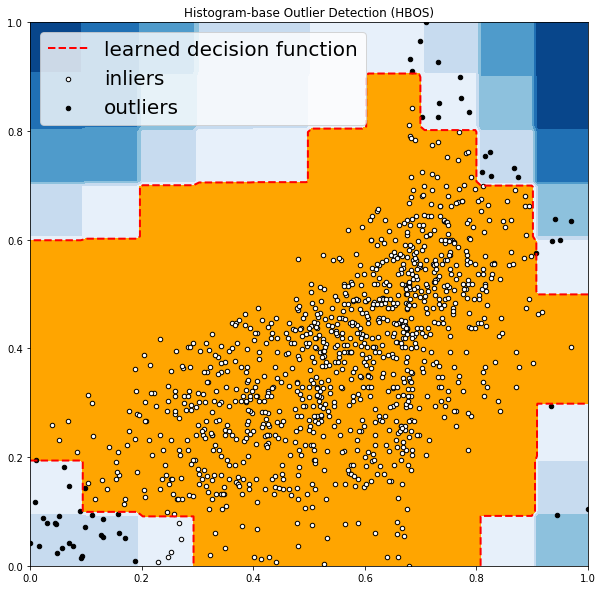

OUTLIERS :  57 INLIERS :  1084 Isolation Forest


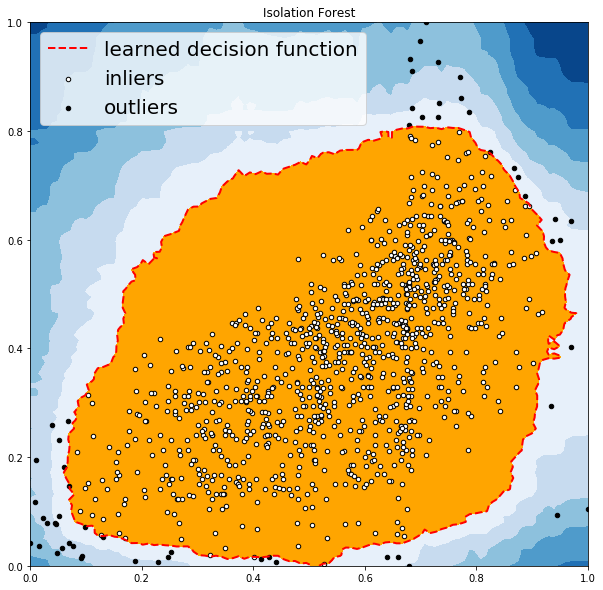

OUTLIERS :  36 INLIERS :  1105 K Nearest Neighbors (KNN)


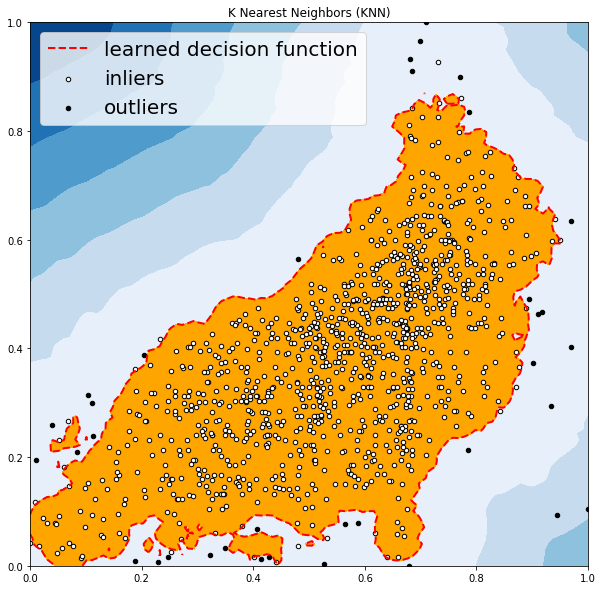

OUTLIERS :  12 INLIERS :  1129 Average KNN


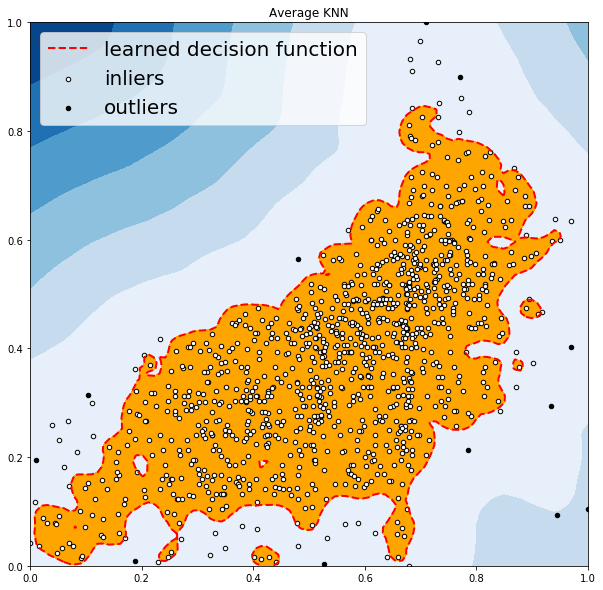



dataset abalone: abalone_benchmark_0680.csv
OUTLIERS :  41 INLIERS :  862 Angle-based Outlier Detector (ABOD)


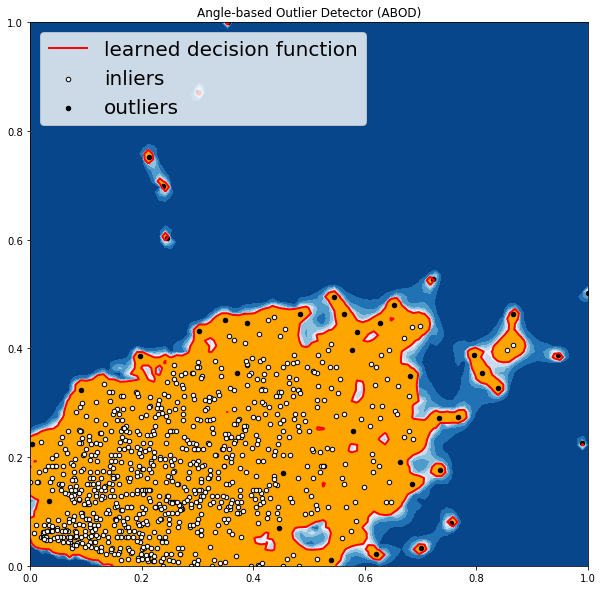

OUTLIERS :  46 INLIERS :  857 Cluster-based Local Outlier Factor (CBLOF)


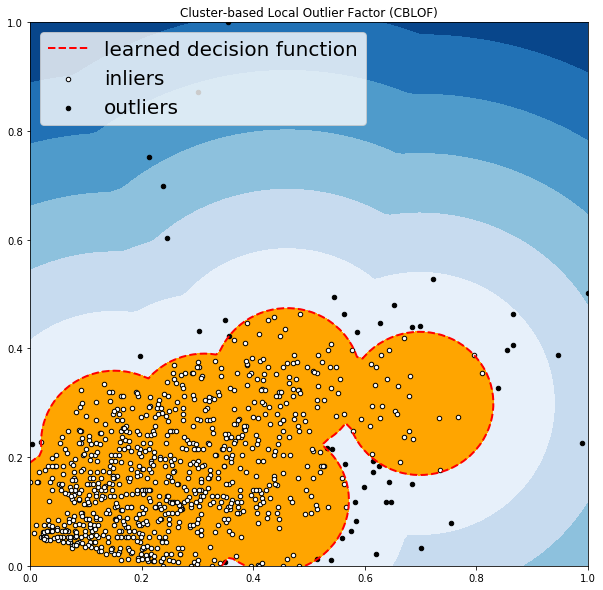

OUTLIERS :  42 INLIERS :  861 Feature Bagging


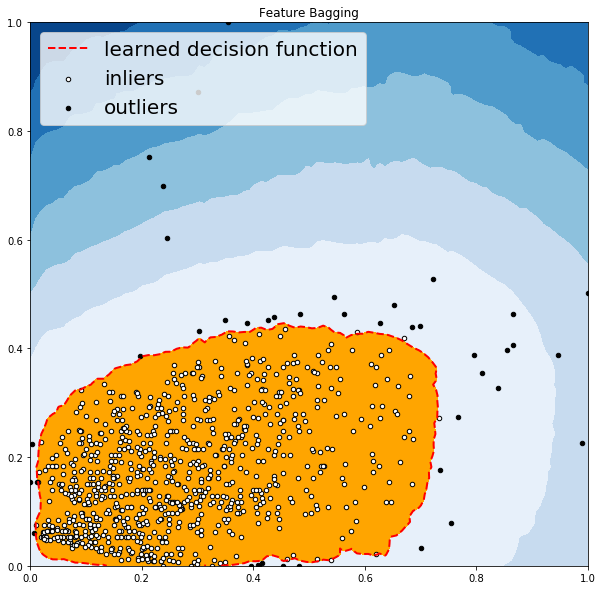

OUTLIERS :  41 INLIERS :  862 Histogram-base Outlier Detection (HBOS)


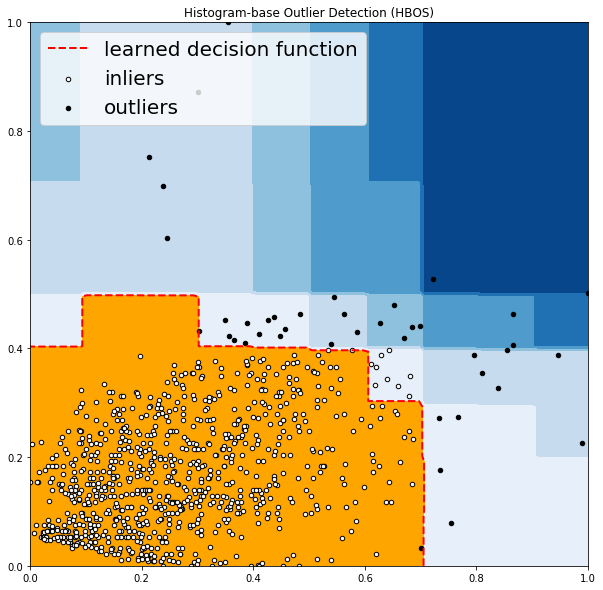

OUTLIERS :  46 INLIERS :  857 Isolation Forest


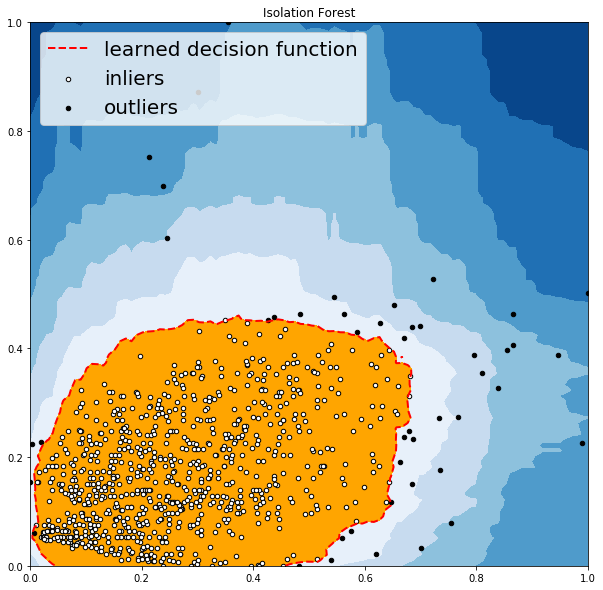

OUTLIERS :  38 INLIERS :  865 K Nearest Neighbors (KNN)


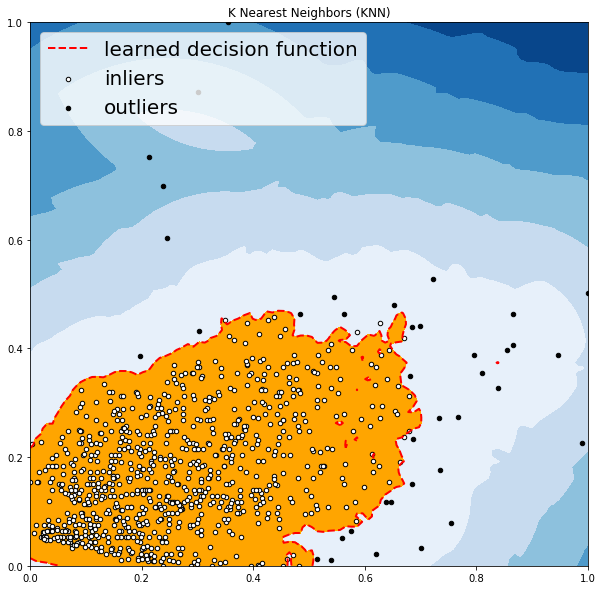

OUTLIERS :  30 INLIERS :  873 Average KNN


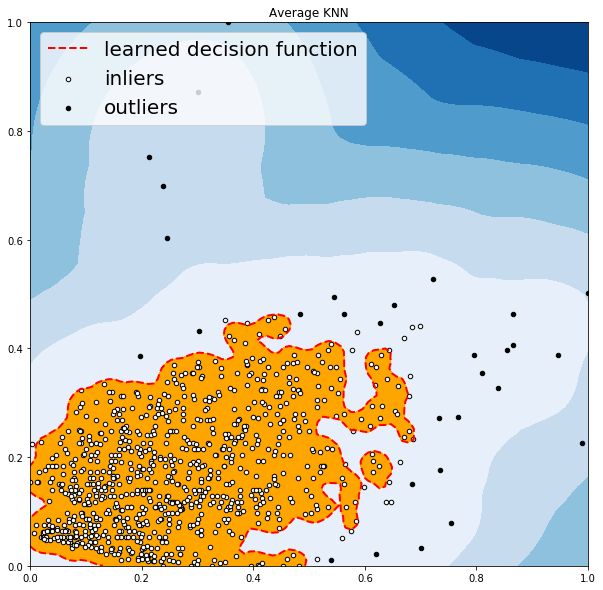



dataset abalone: abalone_benchmark_0694.csv
OUTLIERS :  45 INLIERS :  848 Angle-based Outlier Detector (ABOD)


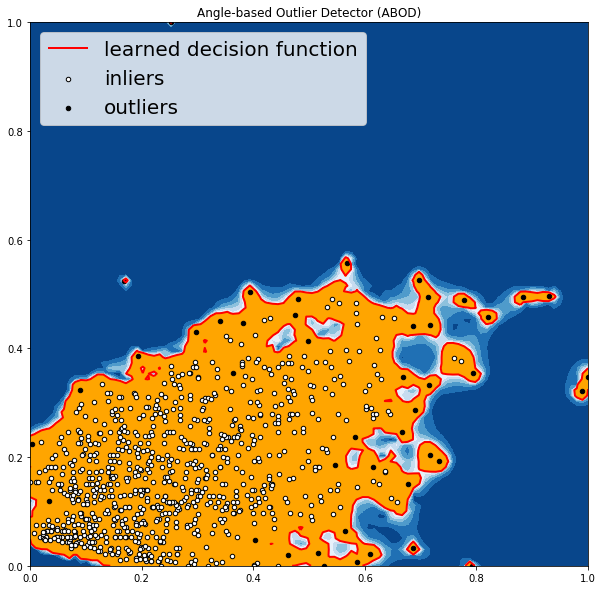

OUTLIERS :  45 INLIERS :  848 Cluster-based Local Outlier Factor (CBLOF)


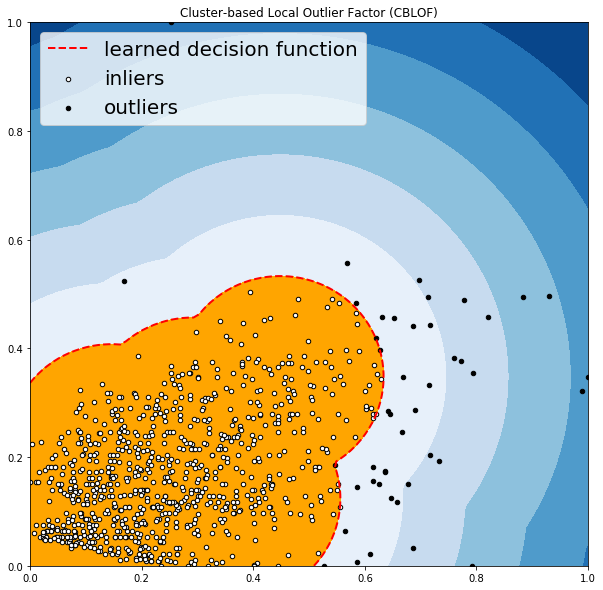

OUTLIERS :  33 INLIERS :  860 Feature Bagging


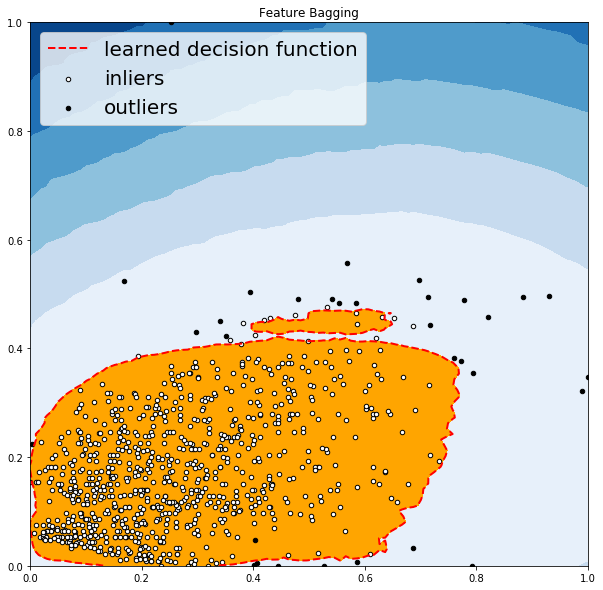

OUTLIERS :  41 INLIERS :  852 Histogram-base Outlier Detection (HBOS)


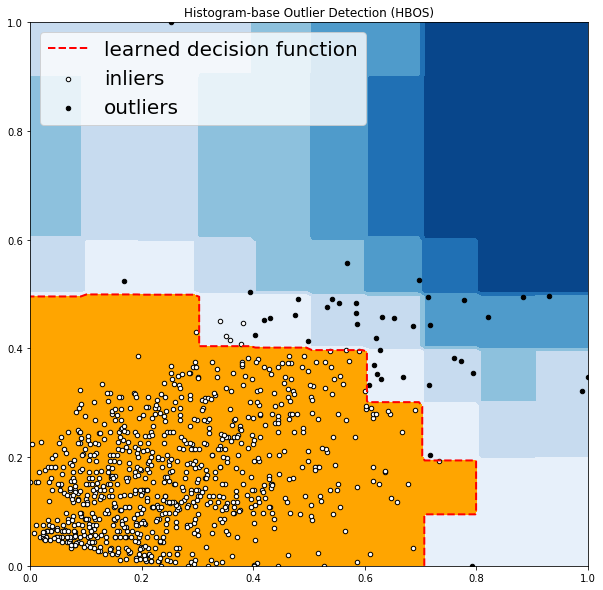

OUTLIERS :  45 INLIERS :  848 Isolation Forest


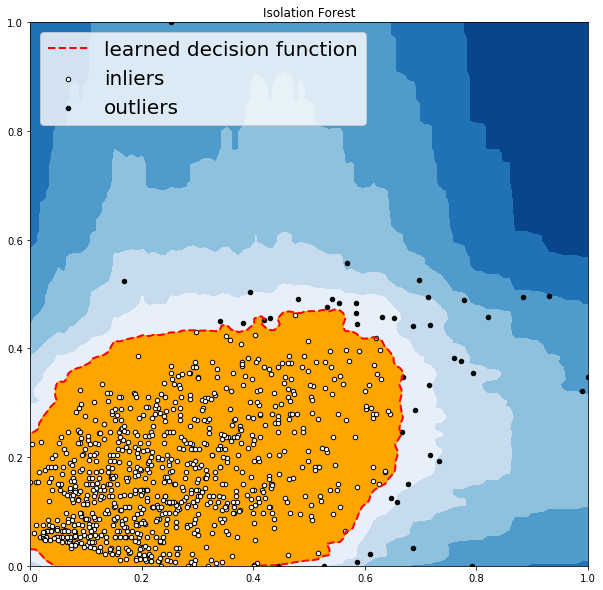

OUTLIERS :  37 INLIERS :  856 K Nearest Neighbors (KNN)


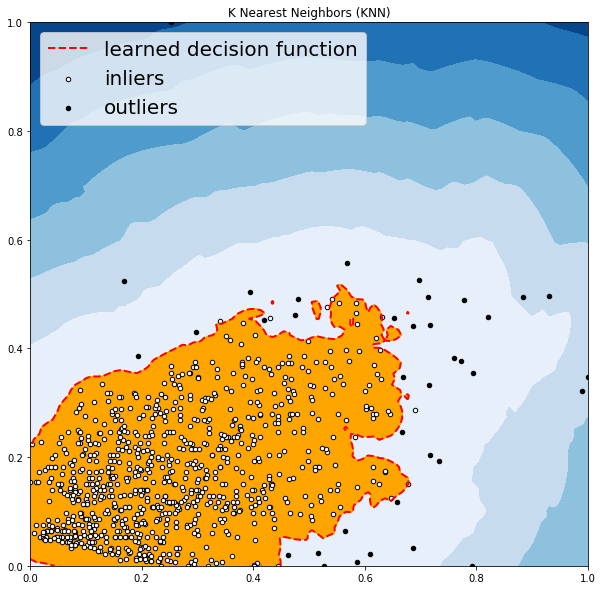

OUTLIERS :  28 INLIERS :  865 Average KNN


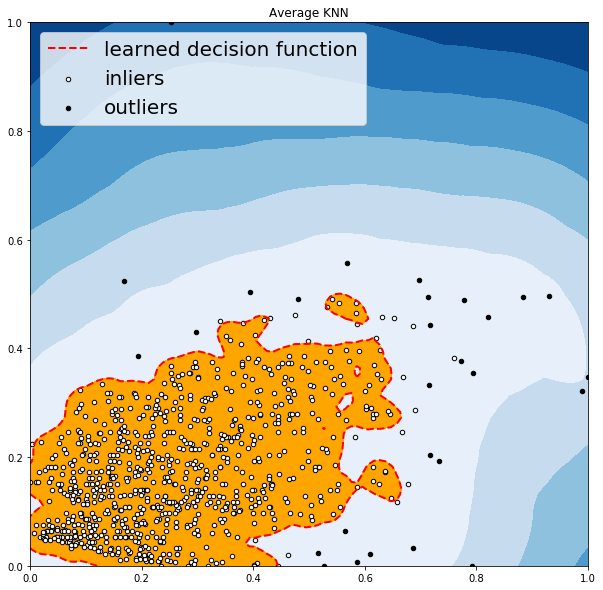

In [11]:
files = os.listdir(root)
for file in files[:5]:
    print('\n\ndataset abalone:', file)
    file = root + file

    dataset = pd.read_csv(file)  
    former = attribute[0]
    latter = attribute[7]
    scaler = MinMaxScaler(feature_range=(0, 1))
    dataset[[former, latter]] = scaler.fit_transform(dataset[[former, latter]])
    dataset[[former, latter]].head()
    X1 = dataset[former].values.reshape(-1, 1)
    X2 = dataset[latter].values.reshape(-1, 1)
    X = np.concatenate((X1, X2), axis=1)

    xx, yy = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
    for i, (clf_name, clf) in enumerate(classifiers.items()):
        clf.fit(X)
        scores_pred = clf.decision_function(X) * -1

        y_pred = clf.predict(X)
        n_inliers = len(y_pred) - np.count_nonzero(y_pred)
        n_outliers = np.count_nonzero(y_pred == 1)
        plt.figure(figsize=(10, 10))
        dfx = dataset
        dfx['outlier'] = y_pred.tolist()

        IX1 = np.array(dfx[former][dfx['outlier'] == 0]).reshape(-1, 1)
        IX2 = np.array(dfx[latter][dfx['outlier'] == 0]).reshape(-1, 1)
        OX1 = dfx[former][dfx['outlier'] == 1].values.reshape(-1, 1)
        OX2 = dfx[latter][dfx['outlier'] == 1].values.reshape(-1, 1)

        print('OUTLIERS : ', n_outliers, 'INLIERS : ', n_inliers, clf_name)
        threshold = stats.scoreatpercentile(scores_pred, 100 * outliers_fraction)

        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) * -1
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, levels=np.linspace(Z.min(), threshold, 7), cmap=plt.cm.Blues_r)
        a = plt.contour(xx, yy, Z, levels=[threshold], linewidths=2, colors='red')
        plt.contourf(xx, yy, Z, levels=[threshold, Z.max()], colors='orange')
        b = plt.scatter(IX1, IX2, c='white', s=20, edgecolor='k')

        c = plt.scatter(OX1, OX2, c='black', s=20, edgecolor='k')

        plt.axis('tight')
        plt.legend(
            [a.collections[0], b, c],
            ['learned decision function', 'inliers', 'outliers'],
            prop=matplotlib.font_manager.FontProperties(size=20),
            loc=2)

        plt.xlim((0, 1))
        plt.ylim((0, 1))
        plt.title(clf_name)
        plt.show()

#### 结果分析

> ABOD方法

它考虑每个点与其邻居之间的关系，它没有考虑这些邻居之间的关系，其加权余弦分数与所有邻居的方差可视为偏离分数；ABOD在多维数据上表现良好；

> k-Nearest Neighbors Detector方法

对于任何数据点，到第k个最近邻居的距离可以被视为远离分数；PyOD支持三个kNN探测器：
最大：使用第k个邻居的距离作为离群值；
均值：使用所有k个邻居的平均值作为离群值得分；
中位数：使用与邻居的距离的中位数作为离群值得分；

> Isolation Forest方法

它在内部使用scikit-learn库，在此方法中，使用一组树完成数据分区； 隔离森林提供了一个异常分数，用于查看结构中点的隔离程度， 然后使用异常分数来识别来自正常观察的异常值，隔离森林在多维数据上表现良好；

> Histogram-based Outlier Detection方法

这是一种有效的无监督方法，它假设特征独立并通过构建直方图来计算异常值，它比多变量方法快得多，但代价是精度较低；

> Local Correlation Integral (LOCI)方法

LOCI对于检测异常值和异常值组非常有效，它为每个点提供LOCI图，总结了该点周围区域内数据的大量信息，确定了簇，微簇，它们的直径以及它们的簇间距离；现有的异常检测方法都不能匹配此功能，因为它们只为每个点输出一个数字；

> Feature Bagging方法

功能装袋检测器在数据集的各种子样本上安装了许多基本检测器，它使用平均或其他组合方法来提高预测精度，默认情况下，Local Outlier Factor（LOF）用作基本估算器。 但是，任何估计器都可以用作基本估计器，例如kNN和ABOD；特征装袋首先通过随机选择特征子集来构造n个子样本。 这带来了基本估计的多样性。 最后，通过平均或取所有基本检测器的最大值来生成预测分数；

> Clustering Based Local Outlier Factor方法

它将数据分为小型集群和大型集群，然后根据点所属的簇的大小以及到最近的大簇的距离来计算异常分数